In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("~/Desktop/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

29


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_R.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: Richards')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQ')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_Q.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logisticQ')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("covid%s%s%d_QR.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [22]:
dfp = pd.read_csv("~/Desktop/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [23]:
sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

445250514

In [24]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("~/Desktop/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [25]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,North America,NaN,1345.0,59.0,16405.0,NaN,1065948,60014.0,147304.0,NaN,NaN
1,716343,Europe,Europe,NaN,142.0,8.0,25260.0,NaN,1276950,121893.0,438714.0,NaN,NaN
2,226794,Asia,Asia,NaN,122.0,6.0,6051.0,NaN,472389,17249.0,228346.0,NaN,NaN
3,82282,South America,South America,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
4,1353,Australia/Oceania,Oceania,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN


In [26]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
222,82282,South America,Total:,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
223,1353,Australia/Oceania,Total:,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN
224,21212,Africa,Total:,NaN,NaN,NaN,140.0,NaN,32657,1427.0,10018.0,NaN,NaN
225,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
226,470100,Europe,European Union,219.606709,142.0,8.0,20592.0,18299.046815,968497,97780.0,400367.0,8147660.0,2175.173233


In [27]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,North America,NaN,1345.0,59.0,16405.0,NaN,1065948,60014.0,147304.0,NaN,NaN
1,716343,Europe,Europe,NaN,142.0,8.0,25260.0,NaN,1276950,121893.0,438714.0,NaN,NaN
2,226794,Asia,Asia,NaN,122.0,6.0,6051.0,NaN,472389,17249.0,228346.0,NaN,NaN
3,82282,South America,South America,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
4,1353,Australia/Oceania,Oceania,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN


In [28]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
81,934,Europe,Lithuania,15.0,11.0,0.0,17.0,39223.0,1449,41.0,474.0,106775.0,532.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


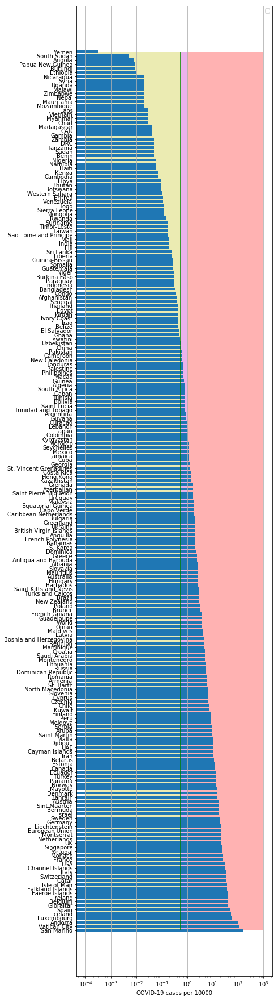

In [29]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


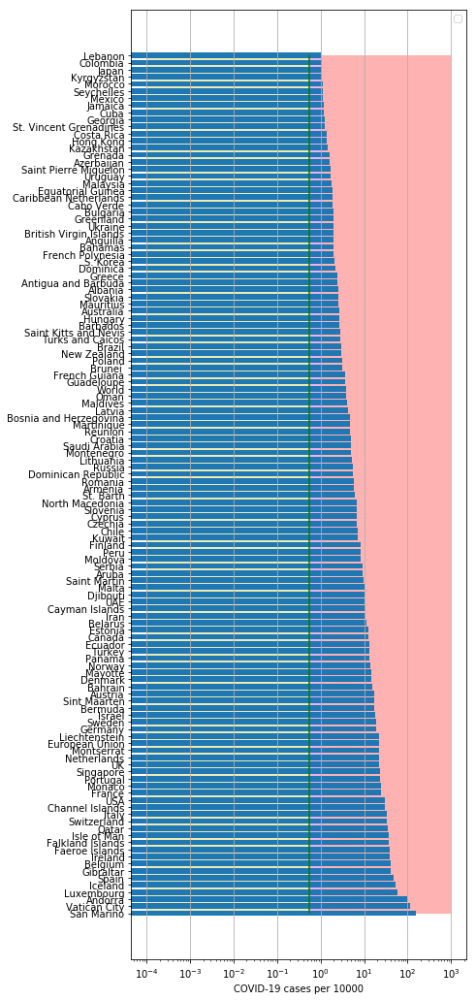

In [30]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="coronage1.png")

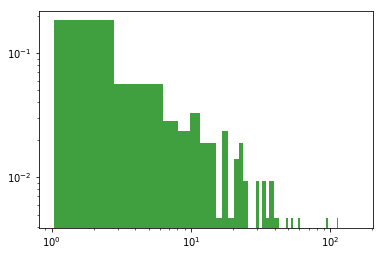

In [31]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [32]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
57 2020-04-22  208389  100757  22313.0
58 2020-04-23  213024  101617  22753.0
59 2020-04-24  219764  104885  23120.0
60 2020-04-25  223759  105149  23487.0
61 2020-04-26  226629   85712  23867.0
GB
          date   cases  active    death
56 2020-04-22  133495  115051  18100.0
57 2020-04-23  138078  118996  18738.0
58 2020-04-24  143464  123614  19506.0
59 2020-04-25  148377  127714  20319.0
60 2020-04-26  152840  131764  20732.0
IT
          date   cases  active    death
59 2020-04-22  187327  107699  25085.0
60 2020-04-23  189973  106848  25549.0
61 2020-04-24  192994  106527  25969.0
62 2020-04-25  195351  105847  26384.0
63 2020-04-26  197675  106103  26644.0
LT
          date  cases  active    death     tests
44 2020-04-22   1416     961  38.0001   83591.0
45 2020-04-23   1428     940  40.0000   90992.0
46 2020-04-24   1444     925  41.0000   98948.0
47 2020-04-25   1461     930  41.5000  104488.0
48 2020-04-26   1499     934  41.0000  106

MX
          date  cases  active   death
45 2020-04-22  10544  6947.0   970.0
46 2020-04-23  11633  7937.0  1069.0
47 2020-04-24  12872  4502.0  1221.0
48 2020-04-25  13842  5388.0  1305.0
49 2020-04-26  14677  4972.0  1351.0
PM
          date  cases  active  death
43 2020-04-22   4992  4593.0  144.0
44 2020-04-23   5166  4749.0  146.0
45 2020-04-24   5338  4865.0  154.0
46 2020-04-25   5538  5041.0  159.0
47 2020-04-26   5779  5245.0  165.0
PU
          date  cases   active  death
46 2020-04-22  19250  11693.0  530.0
47 2020-04-23  20914  12920.0  572.0
48 2020-04-24  21648  13518.0  634.0
49 2020-04-25  25331  16834.0  700.0
50 2020-04-26  27517  18701.0  728.0
SB
          date  cases  active  death
43 2020-04-22   7114  5955.0  134.0
44 2020-04-23   7276  6074.0  139.0
45 2020-04-24   7483  6245.0  144.0
46 2020-04-25   7779  6476.0  151.0
47 2020-04-26   8042  6704.0  156.0
AG
          date   cases  active  death
49 2020-04-22  3288.0  2257.0  159.0
50 2020-04-23  3435.0  2351.0 

In [33]:
#dfVU = pd.read_csv("~/Documents/coronaVU2.csv",",")
#dfVU['date'] = pd.to_datetime(dfVU['date'])
#print("VU\n",dfVU.tail())

In [34]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.8395317214235344
intercept: -3.4492184937727624
slope: [0.15162298]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


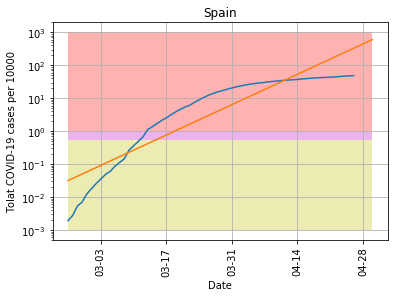

In [35]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-04-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("coronaSP.png")
plt.show()

In [36]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.9330621039204269
intercept: -4.907224554645444
slope: [0.15865301]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


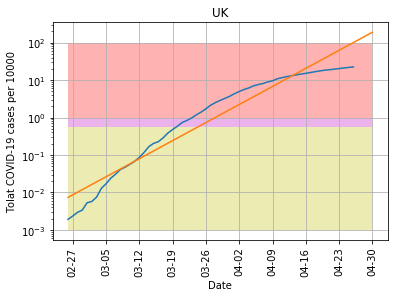

In [37]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-04-30', "coronaGB.png", model1, 'UK',100)

In [38]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.995742947232883
intercept: 1.9726731068275825
slope: [-0.05328278]


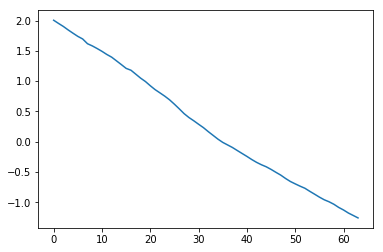

In [39]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


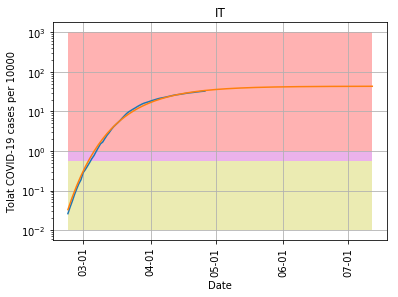

In [40]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("coronaIT.png")
plt.show()

In [41]:
cs=y_pred11[-1]/10000.*populationIT

In [42]:
cs

261690.26371010643

In [43]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT,populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7868263335329269
intercept: -3.1508066357301696
slope: [0.12889542]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


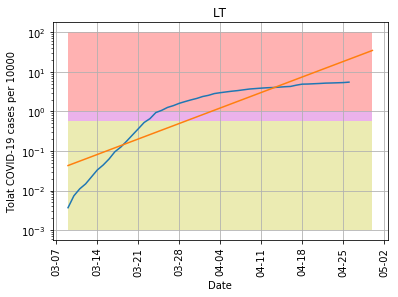

In [44]:
ss1t = plotpred(dfLT,populationLT,'2020-03-09', '2020-04-30', "coronaLT.png", model1, 'LT',100)

In [45]:
#ss1t

In [46]:
36*0.9665024109925366

34.79408679573132

In [47]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.995742947232883
intercept: -6.751930608049734
slope: [0.18396118]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


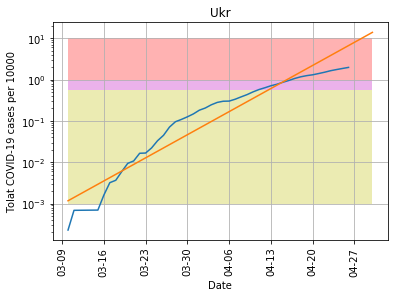

In [48]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-04-30', "coronaUkr.png", model11, 'Ukr',10)

In [49]:
#dfT = pd.read_csv("~/Desktop/coronaTests.csv",",")

In [50]:
#dfT.head()

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


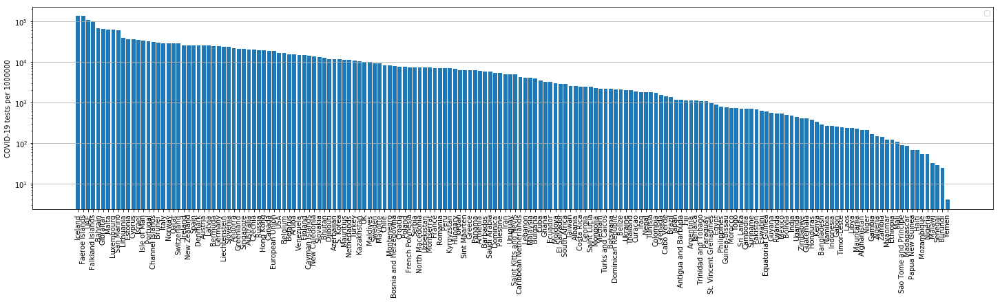

In [51]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("coronaTests.png")
plt.show()

In [52]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.995742947232883
intercept: -4.572672552095944
slope: [0.17240892]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


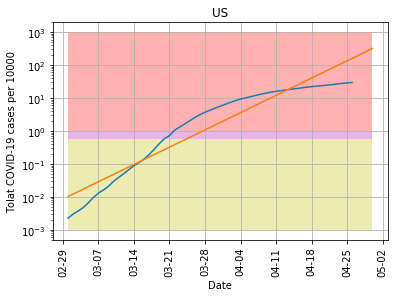

In [53]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-04-30', "coronaUS.png", model11, 'US',1000)

In [54]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
226  European Union  0.100961


(0, 0.15)

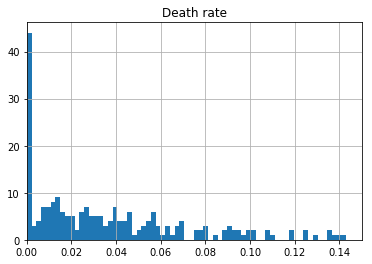

In [55]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh.hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

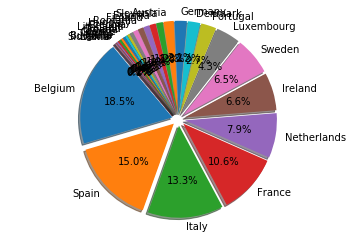

In [56]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [57]:
dfTTh.head()

,Country,Deathsper1Mpop
18,Belgium,612.0
8,Spain,496.0
9,Italy,441.0
10,France,350.0
19,Netherlands,261.0


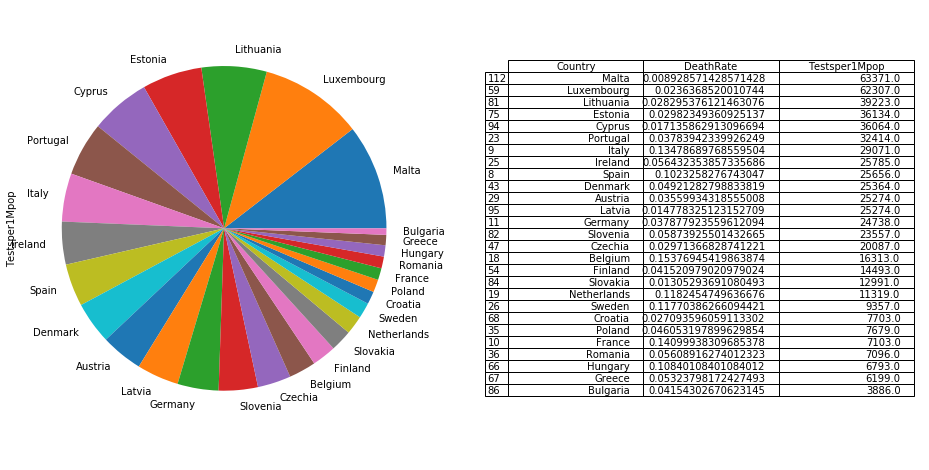

In [58]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate2.png")
plt.show()

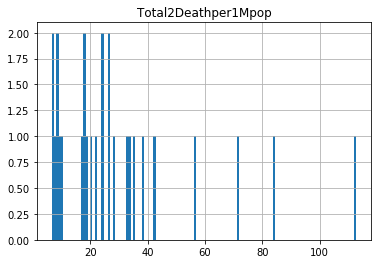

In [59]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [60]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,4847.0,496.0
9,Italy,3269.0,441.0
10,France,2483.0,350.0
11,Germany,1883.0,71.0
18,Belgium,3981.0,612.0


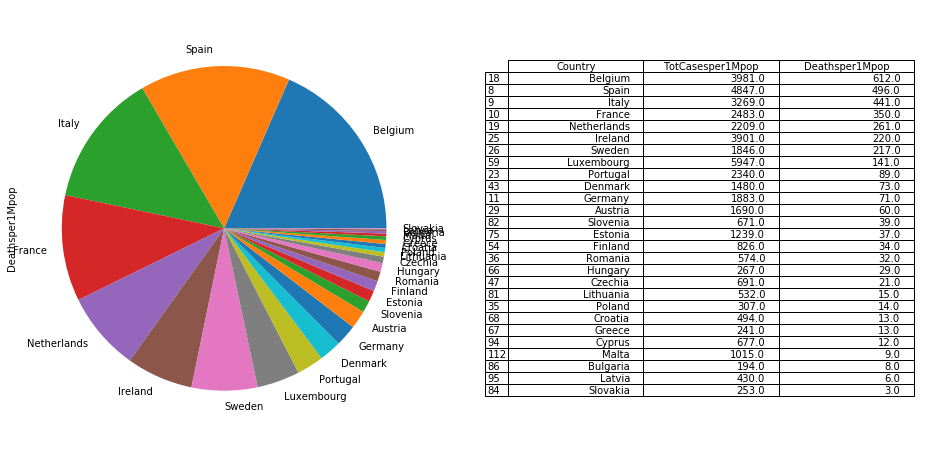

In [61]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("DeathRate1.png")
plt.show()

In [62]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,North America,0.0,1345.0,59.0,16405.0,0.0,1065948,60014.0,147304.0,0.0,0.0
1,716343,Europe,Europe,0.0,142.0,8.0,25260.0,0.0,1276950,121893.0,438714.0,0.0,0.0
2,226794,Asia,Asia,0.0,122.0,6.0,6051.0,0.0,472389,17249.0,228346.0,0.0,0.0
3,82282,South America,South America,0.0,335.0,20.0,9700.0,0.0,138255,6309.0,49664.0,0.0,0.0
4,1353,Australia/Oceania,Oceania,0.0,3.0,1.0,46.0,0.0,8289,102.0,6834.0,0.0,0.0


In [63]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.188923
9,Italy,0.112449
10,France,0.349571
11,Germany,0.076118
18,Belgium,0.244038


In [64]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [65]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
      France             0.349571
     Belgium             0.244038
      Sweden             0.197285
 Netherlands             0.195159
       Spain             0.188923
     Ireland             0.151290
       Italy             0.112449
  Luxembourg             0.095447
     Romania             0.080891
     Germany             0.076118
    Portugal             0.072191
     Austria             0.066867
     Croatia             0.064131
     Denmark             0.058350
     Finland             0.056993
    Bulgaria             0.049923
      Poland             0.039979
     Hungary             0.039305
      Greece             0.038877
     Czechia             0.034400
     Estonia             0.034289
    Slovenia             0.028484
    Slovakia             0.019475
      Cyprus             0.018772
      Latvia             0.017014
       Malta             0.016017
   Lithuania             0.013563


In [66]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
31,Singapore,0.000881,20815.000000
40,Qatar,0.000972,28562.000000
90,Djibouti,0.001955,11884.000000
65,Bahrain,0.003022,67061.000000
89,Hong Kong,0.003854,19426.000000
130,Equatorial Guinea,0.003876,609.000000
70,Uzbekistan,0.004280,7247.000000
69,Oman,0.005005,0.000000
72,Iceland,0.005580,135833.000000
122,Palestine,0.005848,5293.000000


In [67]:
#dfTst = pd.read_csv("~/Desktop/tests.csv",",")

In [68]:
#y = dfT['tests']
#x = np.array(range(dfTst['tests'].size)).reshape((-1, 1))
#model = LinearRegression().fit(x, y)
#r_sq = model.score(x, y)
#print('coefficient of determination:', r_sq)
#print('intercept:', model.intercept_)
#print('slope:', model.coef_)

In [69]:
#f = lambda t:128.01 + np.exp(0.36*(t + 2) - 5.21) - 38.95*t - 88.08

In [70]:
#f(54)

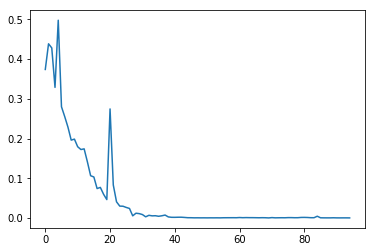

In [71]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [72]:
#np.diff(np.log(dfCN["cases"].values))

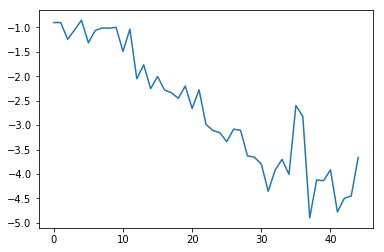

In [73]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))

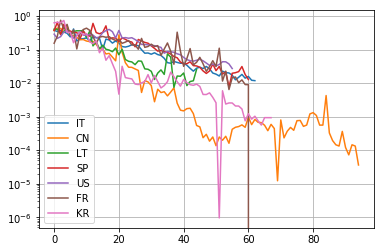

In [74]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

56 56
coefficient of determination: 0.9570101630974013
intercept: -7.0315808582136885
slope: [-0.21441384]


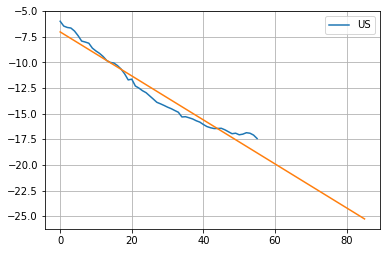

In [75]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("logdiffUS.png")
plt.show()

63 63
coefficient of determination: 0.9327999351008602
intercept: -8.521953895740372
slope: [-0.15035311]


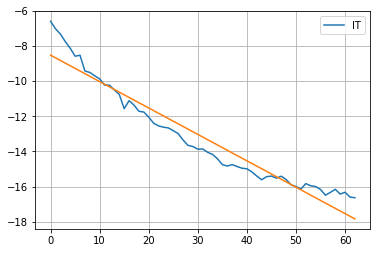

In [76]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [77]:
#model11.coef_

In [78]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

45 45
coefficient of determination: 0.9799123351742315
intercept: -14.280148152914993
slope: [-0.10283007]


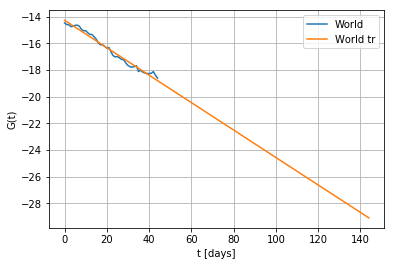

In [79]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("logdifflogcoronaW.png")

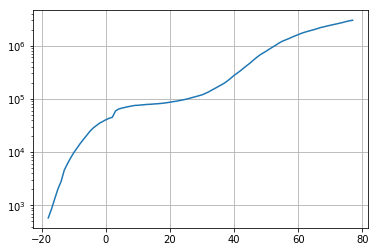

In [80]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [81]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 4.42964935e+06  2.30424305e+00 -8.31014481e+00  2.33243887e-02]


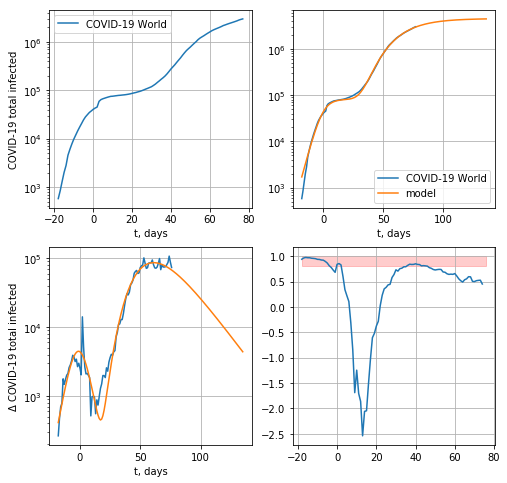

13940.469848263418


In [82]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

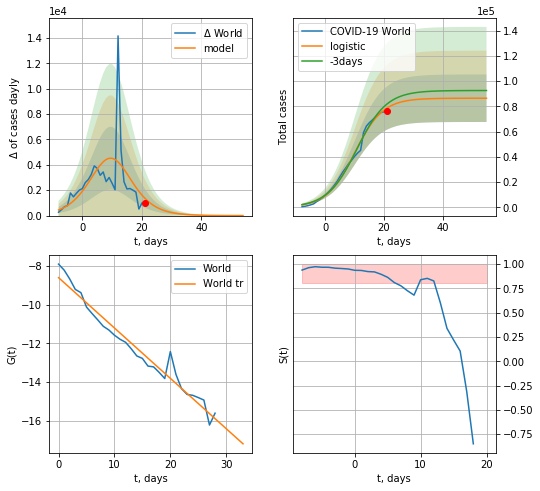

World data at: 2020-04-26
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +34 days
	 deltaDaycases:  1
	 total cases:  86466 ± 18833
	 total death:  5976 ± 3904
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


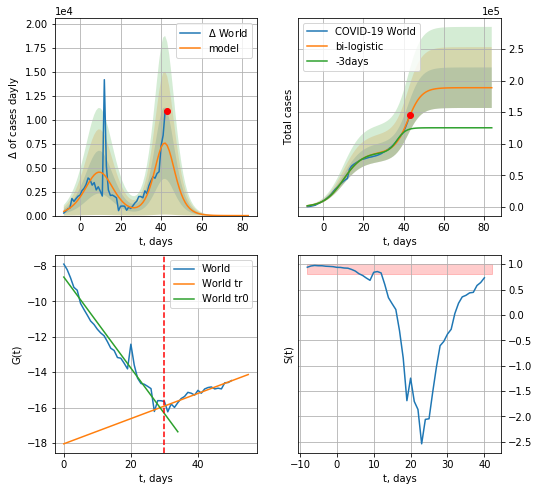

World data at: 2020-04-26
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  188700 ± 32065
	 total death:  13041 ± 6648
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


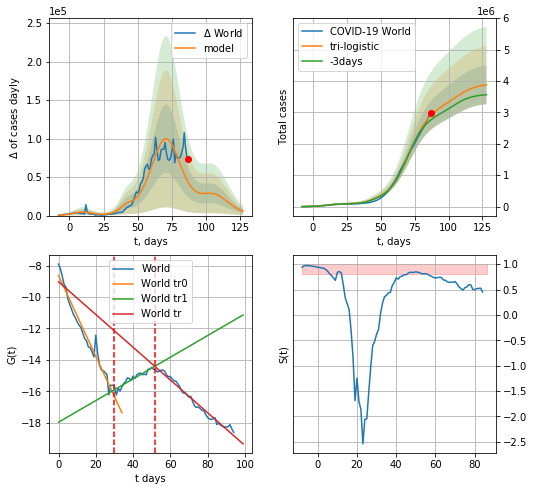

World data at: 2020-04-26
+3 day model MAPE: 0.055155390474227725
model: tri-logistic
coeffs:  [2.98552594e+06 1.32497006e-01 7.10320523e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.15855316094189634
forecast at the end of period: +41 days
	 deltaDaycases:  5683
	 total cases:  3877925 ± 614857
	 total death:  268016 ± 127484
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.979046
 intercept: -9.025380
 slope: -0.104249


In [83]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

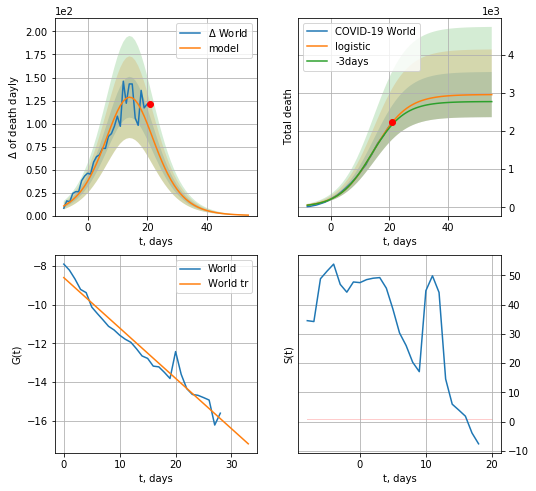

World data at: 2020-04-26
+3 day model MAPE: 0.02922470086968507
model: logistic
coeffs:  [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.20032621918861032
forecast at the end of period: +34 days
	 total death:  2953 ± 591
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


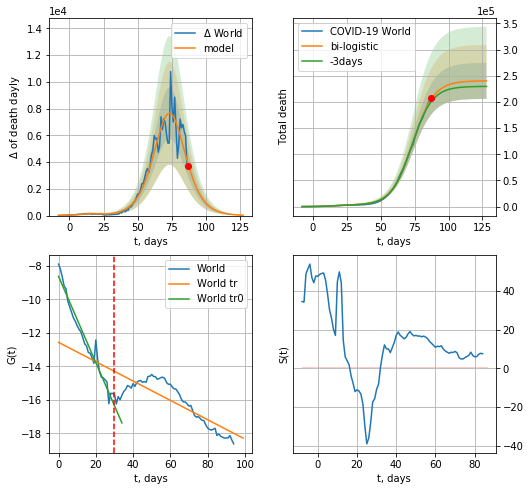

World data at: 2020-04-26
+3 day model MAPE: 0.024756010323957352
model: bi-logistic
coeffs:  [2.37574118e+05 1.28908395e-01 7.37048347e+01] [2.95655981e+03 1.74166848e-01 1.46351620e+01]
rational stdev:  0.14307709142188252
forecast at the end of period: +41 days
	 deltaDaydeath:  29
	 total death:  240314 ± 34383
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.696048
 intercept: -12.565711
 slope: -0.057674


In [86]:
vL = 30
vL1=52
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [87]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

In [88]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8,1.])

In [89]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

In [90]:
#trend3(dfSP,dfIT,dfFR[9:],'SP','IT','FR',40,40,40)

In [91]:
#trend(dfSP,'SP',10)

In [92]:
#np.log(np.diff(dfFR["cases"].values)[:]/dfFR["cases"].values[1:]**2)

In [93]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

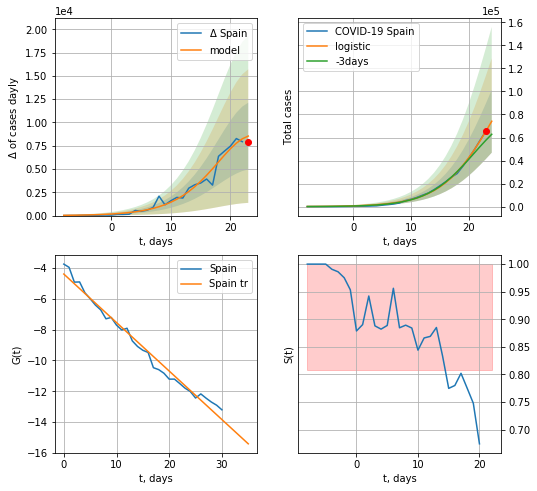

Spain data at: 2020-04-26
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +1 days
	 deltaDaycases:  8536
	 total cases:  74138 ± 27303
	 total death:  7586 ± 8381
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


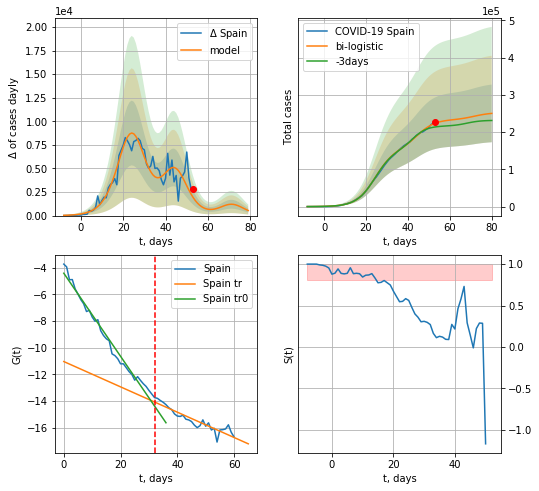

Spain data at: 2020-04-26
+3 day model MAPE: 0.052114502587316744
model: bi-logistic
coeffs:  [7.72521895e+04 2.44206549e-01 4.48289063e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.30937612104997275
forecast at the end of period: +27 days
	 deltaDaycases:  539
	 total cases:  250085 ± 77370
	 total death:  25590 ± 23750
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.854172
 intercept: -11.044204
 slope: -0.094832


In [94]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
57 2020-04-22  208389  100757  22313.0
58 2020-04-23  213024  101617  22753.0
59 2020-04-24  219764  104885  23120.0
60 2020-04-25  223759  105149  23487.0
61 2020-04-26  226629   85712  23867.0


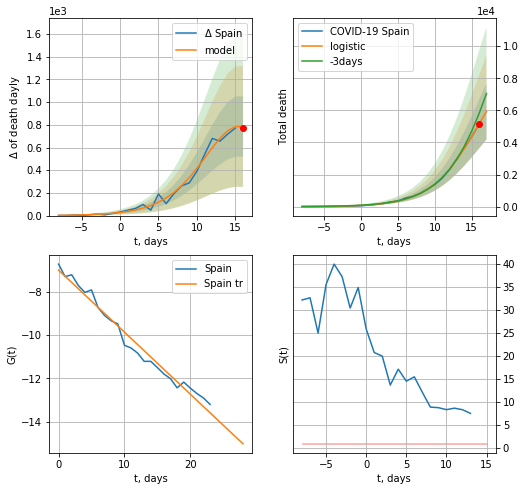

Spain data at: 2020-04-26
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +1 days
	 total death:  5936 ± 1753
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


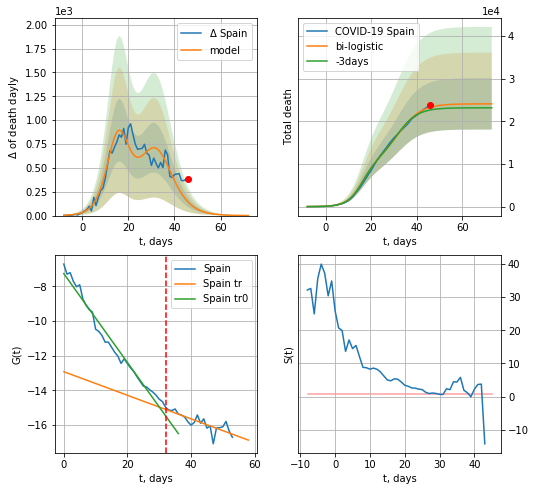

Spain data at: 2020-04-26
+3 day model MAPE: 0.029563444747998956
model: bi-logistic
coeffs:  [1.37092111e+04 2.00503273e-01 3.21422988e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.24972951183217498
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  24093 ± 6016
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.680580
 intercept: -12.919743
 slope: -0.067948


In [95]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,30-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


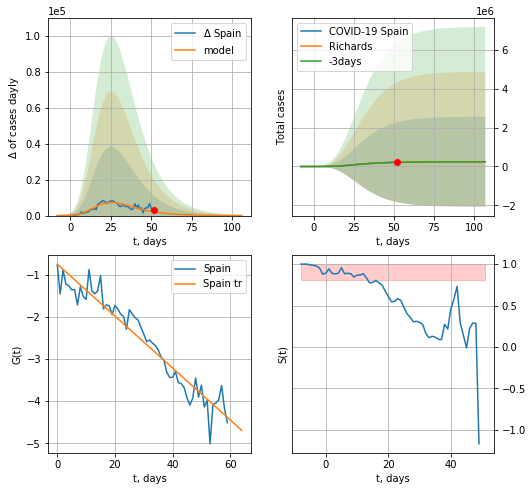

Spain data at: 2020-04-26
+3 day model MAPE: 0.02520988243209008
model: Richards
coeffs:  [ 2.47558002e+05  6.84141192e+00 -2.94907395e+01  1.17498854e-02]
rational stdev:  9.326490387269045
forecast at the end of period: +55 days
	 deltaDaycases:  30
	 total cases:  247196 ± 2305474
	 total death:  25294 ± 707712
trend coefficient of determination: 0.924973
 intercept: -0.748264
 slope: -0.061648


In [97]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide


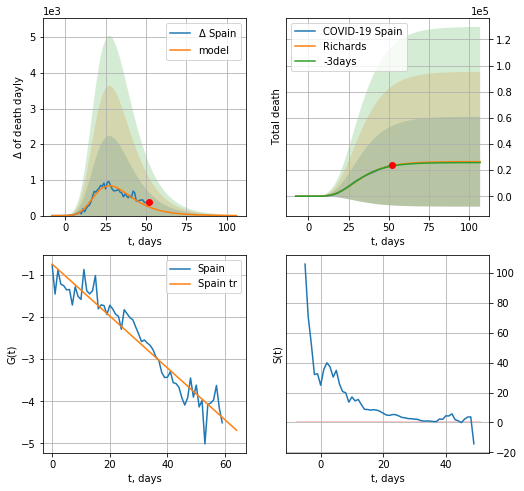

Spain data at: 2020-04-26
+3 day model MAPE: 0.014712555214721262
model: Richards
coeffs:  [ 2.64838251e+04  7.54080688e+00 -2.38933189e+01  1.14577851e-02]
rational stdev:  1.29983212275105
forecast at the end of period: +55 days
	 total death:  26455 ± 34387
trend coefficient of determination: 0.924818
 intercept: -0.746608
 slope: -0.061607


In [98]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


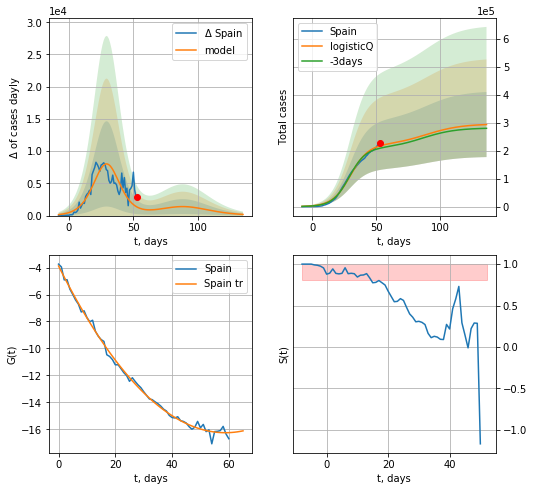

Spain data at: 2020-04-26
+3 day model MAPE: 0.040946570123273573
model: logisticQ
coeffs:  [ 2.19481262e+05  1.30860587e-06  2.96427817e+01 -1.10753910e+05]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.39650748271558317
forecast at the end of period: +83 days
	 deltaDaycases:  177
	 total cases:  293855 ± 116515
	 total death:  30068 ± 35766
trend coefficient of determination: 0.996147
 intercept_: -3.8822884479359825
 coeffs_: [ 0.         -0.42088096  0.00357973]


In [99]:
x = forecastRRR('Spain',dfSP[:],d1,7*16-dT,1.0,addpred=True,xcoef=[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


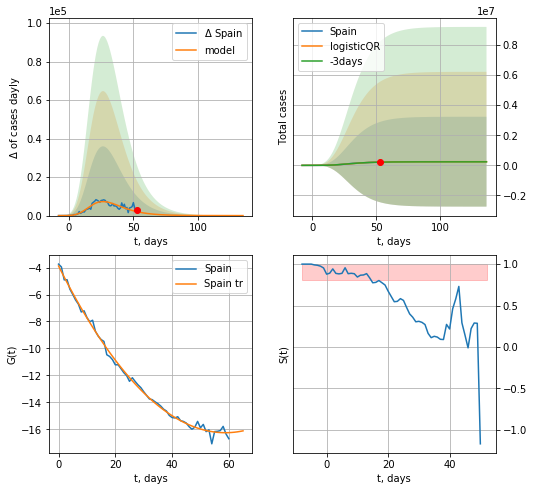

Spain data at: 2020-04-26
+3 day model MAPE: 0.026462867203806993
model: logisticQR
coeffs:  [ 2.44648529e+05  3.78398875e-02 -5.56968363e+01 -8.28820422e+02
  2.28301806e-03]
rational stdev:  12.191044604933138
forecast at the end of period: +83 days
	 deltaDaycases:  1
	 total cases:  244636 ± 2982370
	 total death:  25032 ± 915498
trend coefficient of determination: 0.996147
 intercept_: -3.8822884479359825
 coeffs_: [ 0.         -0.42088096  0.00357973]


In [100]:
x = forecastQR('Spain',dfSP[:],d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,3.,1])

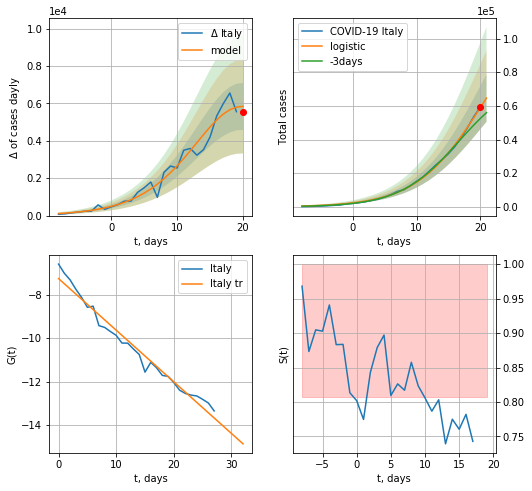

Italy data at: 2020-04-26
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +1 days
	 deltaDaycases:  5840
	 total cases:  64633 ± 14090
	 total death:  8711 ± 5697
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


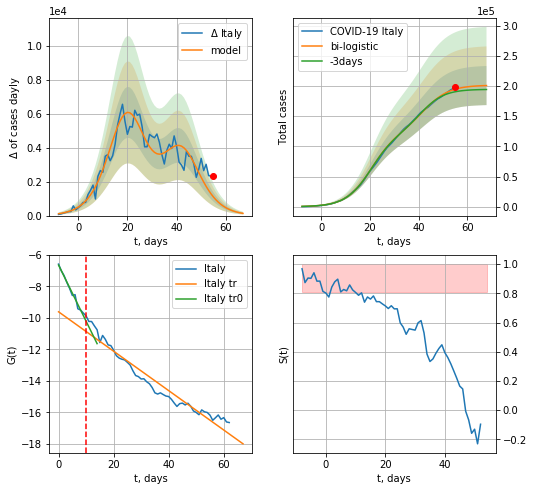

Italy data at: 2020-04-26
+3 day model MAPE: 0.02374490166566638
model: bi-logistic
coeffs:  [7.99384448e+04 1.88877351e-01 4.23027430e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.1613641782899564
forecast at the end of period: +13 days
	 deltaDaycases:  130
	 total cases:  200799 ± 32401
	 total death:  27065 ± 13101
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.943513
 intercept: -9.614873
 slope: -0.124953


In [101]:
x = forecast('Italy',dfIT[:-6-dT],d1,30-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

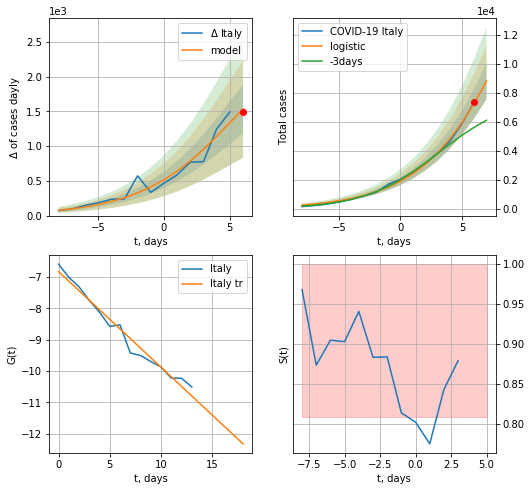

Italy data at: 2020-04-26
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +1 days
	 deltaDaycases:  1534
	 total cases:  8819 ± 1246
	 total death:  1188 ± 503
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


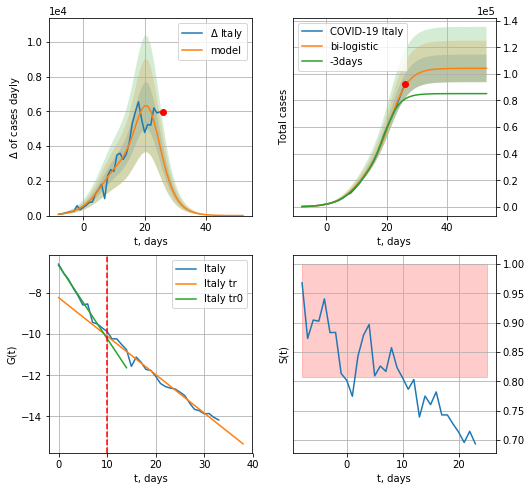

Italy data at: 2020-04-26
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  104176 ± 10389
	 total death:  14041 ± 4200
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


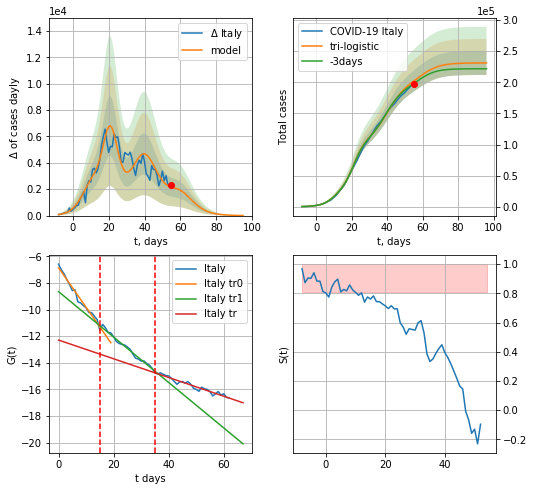

Italy data at: 2020-04-26
+3 day model MAPE: 0.02081999848249112
model: tri-logistic
coeffs:  [9.40592434e+04 1.91226521e-01 4.00971782e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.08360154805600839
forecast at the end of period: +41 days
	 deltaDaycases:  7
	 total cases:  231122 ± 19322
	 total death:  31152 ± 7813
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.945985
 intercept: -12.294615
 slope: -0.070281


In [102]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,30-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

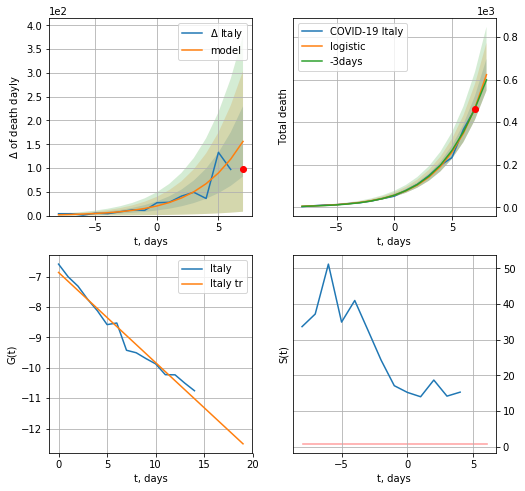

Italy data at: 2020-04-26
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +1 days
	 total death:  622 ± 74
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


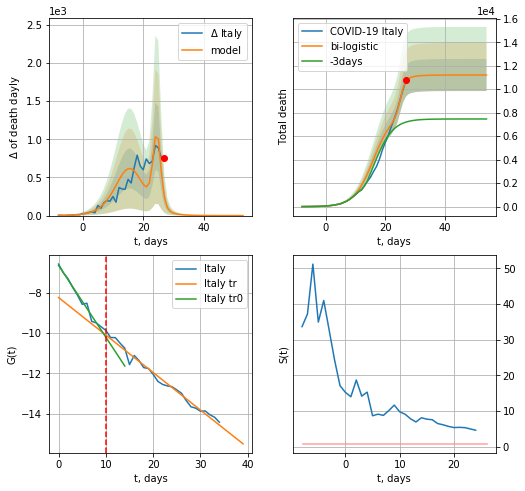

Italy data at: 2020-04-26
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


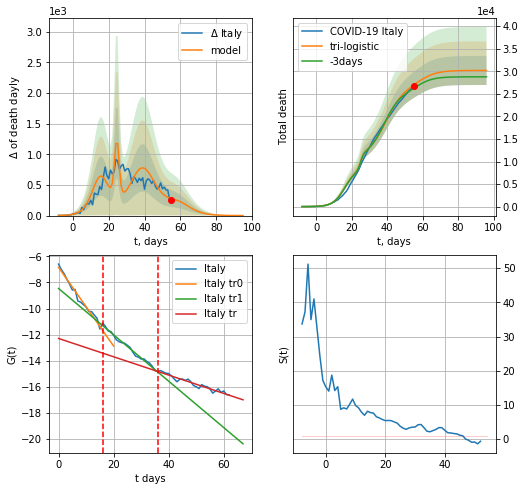

Italy data at: 2020-04-26
+3 day model MAPE: 0.02859580061211984
model: tri-logistic
coeffs:  [1.51759974e+04 2.01436505e-01 3.92457599e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.10661733362161536
forecast at the end of period: +41 days
	 deltaDaydeath:  0
	 total death:  30179 ± 3217
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.940118
 intercept: -12.294889
 slope: -0.070276


In [103]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,30-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


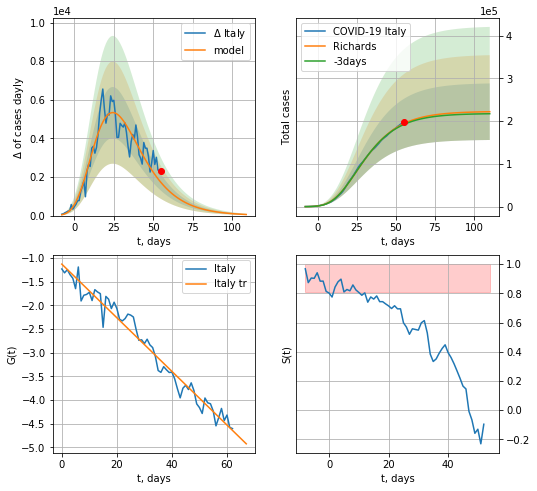

Italy data at: 2020-04-26
+3 day model MAPE: 0.011301797099783273
model: Richards
coeffs:  [ 2.22783447e+05  4.92685455e+00 -4.10314319e+01  1.33117478e-02]
rational stdev:  0.29785587816116976
forecast at the end of period: +55 days
	 deltaDaycases:  56
	 total cases:  221949 ± 66109
	 total death:  29915 ± 26731
trend coefficient of determination: 0.969407
 intercept: -1.126523
 slope: -0.056733


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


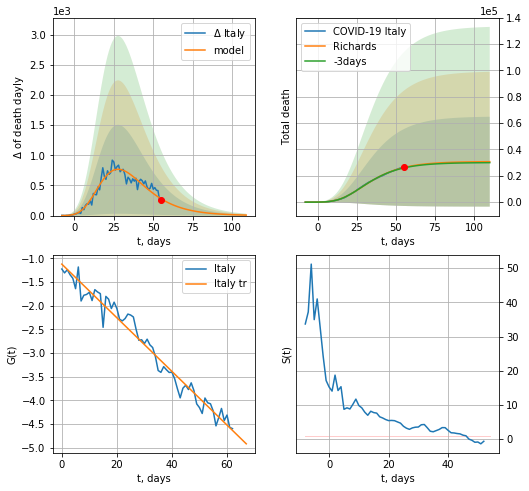

Italy data at: 2020-04-26
+3 day model MAPE: 0.012298035722367734
model: Richards
coeffs:  [ 3.08177103e+04  5.33638841e+00 -3.57802166e+01  1.27752221e-02]
rational stdev:  1.109987776765385
forecast at the end of period: +55 days
	 total death:  30701 ± 34078
trend coefficient of determination: 0.969323
 intercept: -1.122502
 slope: -0.056682


In [104]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


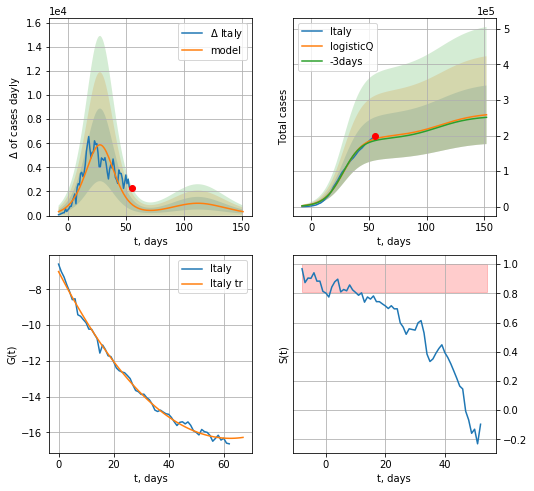

Italy data at: 2020-04-26
+3 day model MAPE: 0.026121787300561618
model: logisticQ
coeffs:  [ 1.95781688e+05  1.06729126e-06  2.81228224e+01 -1.11874319e+05]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.31876907605294835
forecast at the end of period: +97 days
	 deltaDaycases:  330
	 total cases:  258403 ± 82371
	 total death:  34829 ± 33307
trend coefficient of determination: 0.995752
 intercept_: -7.010198197102573
 coeffs_: [ 0.         -0.29907981  0.00239905]


In [105]:
x = forecastRRR('Italy',dfIT[:],d1,7*18-dT,1.0,addpred=True,xcoef=[.35,.5,4.,1])

In [106]:
dT

29

FR
          date     cases  active    death
67 2020-04-22  178844.0   97880  21340.0
68 2020-04-23  181083.0   94239  21856.0
69 2020-04-24  182728.0   94090  22245.0
70 2020-04-25  184373.0   94280  22614.0
71 2020-04-26  186033.0   94341  22856.0


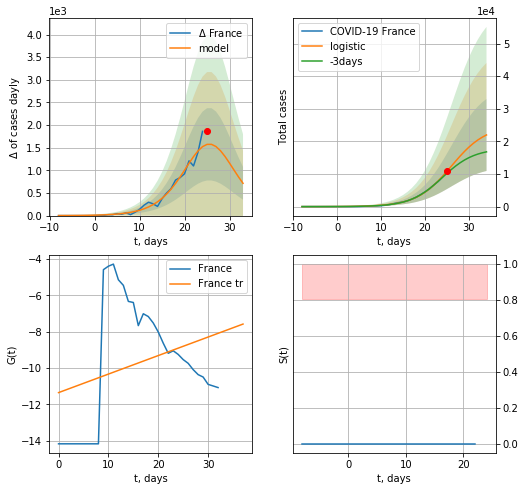

France data at: 2020-04-26
+3 day model MAPE: 0.08969983261006714
model: logistic
coeffs:  [2.48508663e+04 2.54714479e-01 2.60119851e+01]
rational stdev:  0.5024160493803709
forecast at the end of period: +9 days
	 deltaDaycases:  713
	 total cases:  21977 ± 11042
	 total death:  3098 ± 4669
trend coefficient of determination: 0.086830
 intercept: -11.359270
 slope: 0.102077


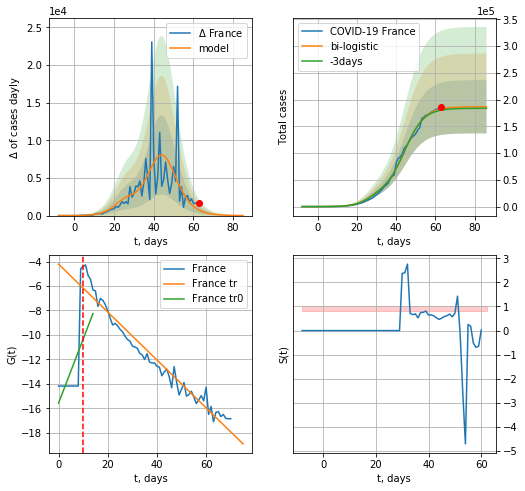

France data at: 2020-04-26
+3 day model MAPE: 0.013292987049838808
model: bi-logistic
coeffs:  [1.61911241e+05 1.97898541e-01 4.44897840e+01] [2.48508663e+04 2.54714479e-01 2.60119851e+01]
rational stdev:  0.2664849120027374
forecast at the end of period: +23 days
	 deltaDaycases:  9
	 total cases:  186718 ± 49757
	 total death:  26327 ± 21047
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.272715
 intercept: -15.575793
 slope: 0.523342
trend coefficient of determination: 0.955219
 intercept: -4.212804
 slope: -0.195837


In [108]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[:-9-dT],d1,6*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5])

In [109]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

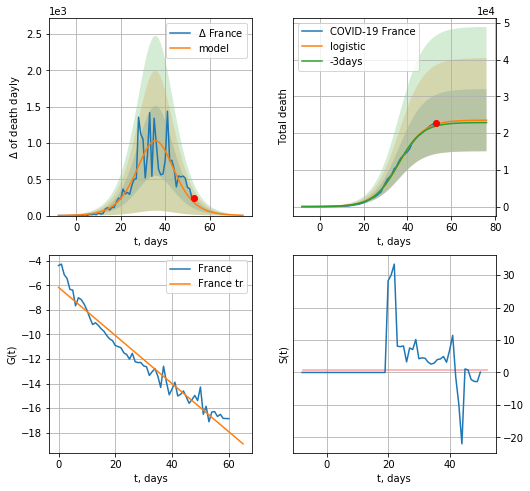

France data at: 2020-04-26
+3 day model MAPE: 0.02194843861371153
model: logistic
coeffs:  [2.35531892e+04 1.75242776e-01 3.60949357e+01]
rational stdev:  0.35977147721997343
forecast at the end of period: +23 days
	 total death:  23531 ± 8465
trend coefficient of determination: 0.955219
 intercept: -6.171171
 slope: -0.195837


In [110]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


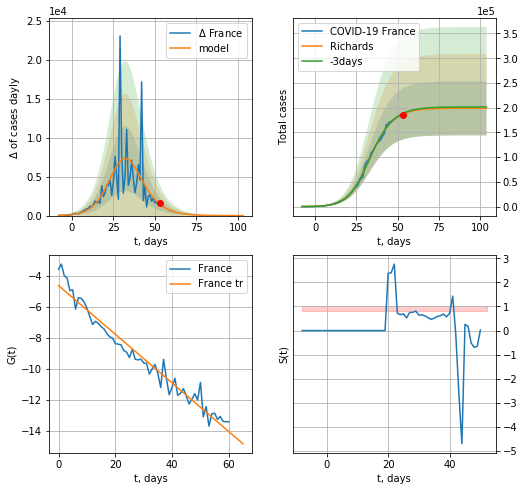

France data at: 2020-04-26
+3 day model MAPE: 0.006633682425703172
model: Richards
coeffs:  [1.98937671e+05 1.87525248e-01 3.01490878e+01 7.18325748e-01]
rational stdev:  0.2754815402673914
forecast at the end of period: +51 days
	 deltaDaycases:  1
	 total cases:  198924 ± 54800
	 total death:  28048 ± 23180
trend coefficient of determination: 0.959891
 intercept: -4.640036
 slope: -0.157135


In [111]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


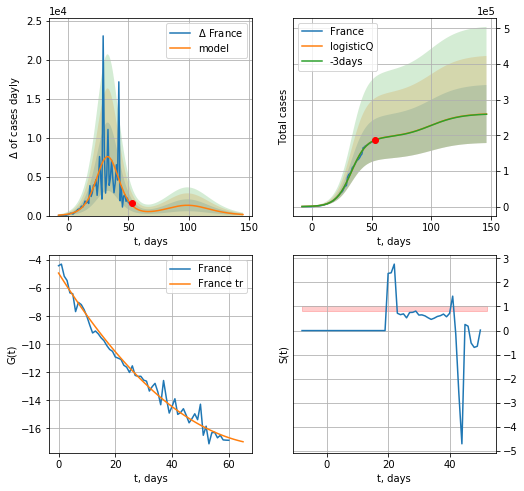

France data at: 2020-04-26
+3 day model MAPE: 0.0020971403925168423
model: logisticQ
coeffs:  [ 1.93748669e+05  5.97534510e-06  3.31282401e+01 -2.60256139e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.31350655961661505
forecast at the end of period: +93 days
	 deltaDaycases:  136
	 total cases:  259834 ± 81459
	 total death:  36636 ± 34456
trend coefficient of determination: 0.983170
 intercept_: -4.9185274823865015
 coeffs_: [ 0.         -0.32325919  0.00212399]


In [112]:
x = forecastRRR('France',dfFR[10:],d1,18*7-dT-4,1.0,addpred=True,xcoef=[.35,.5,3.,1.])

In [113]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [114]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

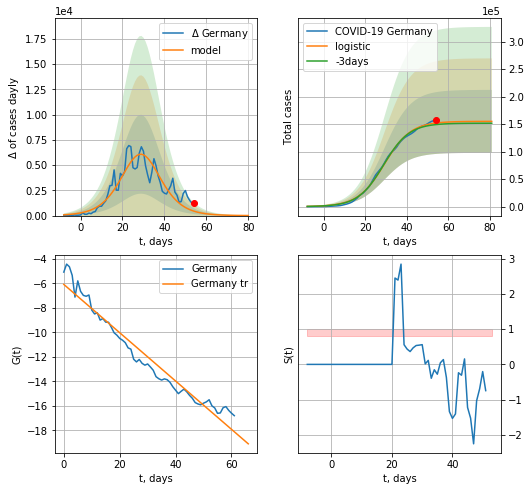

Germany data at: 2020-04-26
+3 day model MAPE: 0.019072681268546925
model: logistic
coeffs:  [1.54999797e+05 1.56840804e-01 2.92157581e+01]
rational stdev:  0.3695645109771384
forecast at the end of period: +27 days
	 deltaDaycases:  7
	 total cases:  154953 ± 57265
	 total death:  5869 ± 6506
trend coefficient of determination: 0.953077
 intercept: -6.092274
 slope: -0.197061


In [115]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


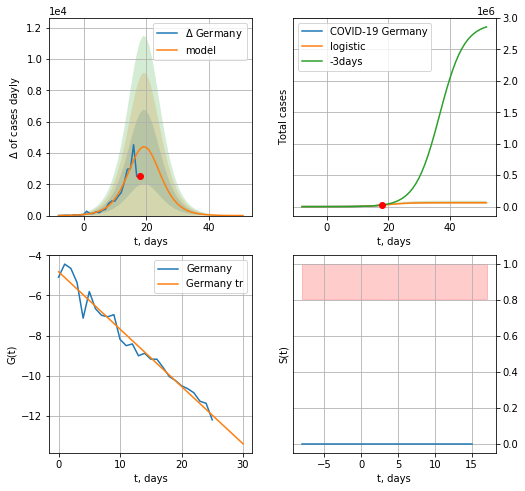

Germany data at: 2020-04-26
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +34 days
	 deltaDaycases:  2
	 total cases:  61633 ± 10511
	 total death:  2334 ± 1194
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


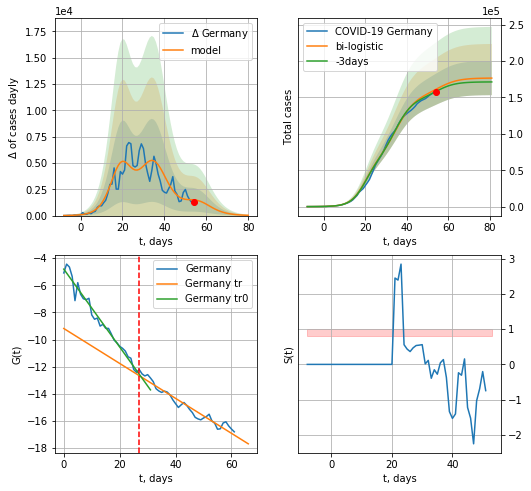

Germany data at: 2020-04-26
+3 day model MAPE: 0.018973728498169088
model: bi-logistic
coeffs:  [9.20492581e+04 2.15680959e-01 3.50729979e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.13279792327770454
forecast at the end of period: +27 days
	 deltaDaycases:  26
	 total cases:  176589 ± 23450
	 total death:  6688 ± 2664
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.947341
 intercept: -9.184321
 slope: -0.128802


In [116]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
58 2020-04-22  150648   42033  5315.0
59 2020-04-23  153129   40754  5575.0
60 2020-04-24  154999   39439  5760.0
61 2020-04-25  156513   40836  5877.0
62 2020-04-26  157770   37294  5976.0


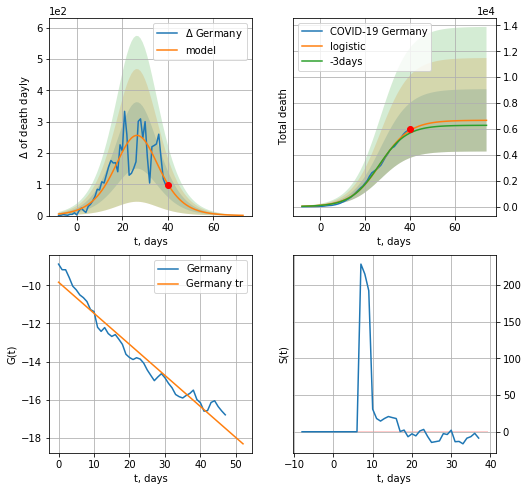

Germany data at: 2020-04-26
+3 day model MAPE: 0.03733593264976788
model: logistic
coeffs:  [6.67144064e+03 1.53769284e-01 2.69161283e+01]
rational stdev:  0.3609951487687572
forecast at the end of period: +34 days
	 total death:  6666 ± 2406
trend coefficient of determination: 0.951500
 intercept: -9.830311
 slope: -0.163371


In [117]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


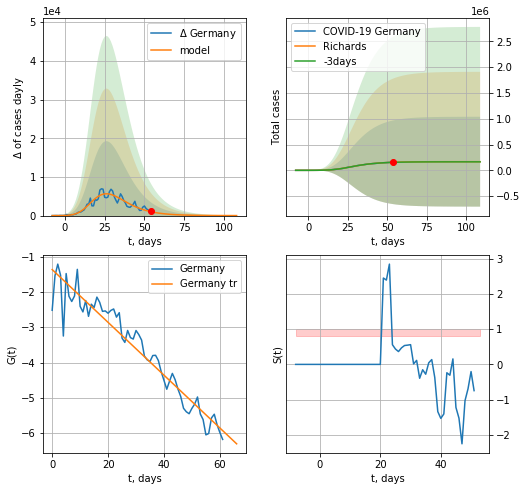

Germany data at: 2020-04-26
+3 day model MAPE: 0.009858778511773268
model: Richards
coeffs:  [1.67574921e+05 8.59824174e-01 3.97533173e+00 1.12370512e-01]
rational stdev:  5.195104616086504
forecast at the end of period: +55 days
	 deltaDaycases:  5
	 total cases:  167516 ± 870265
	 total death:  6345 ± 98888
trend coefficient of determination: 0.923646
 intercept: -1.369570
 slope: -0.074727


In [118]:
x = forecastRR('Germany',dfGR[:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


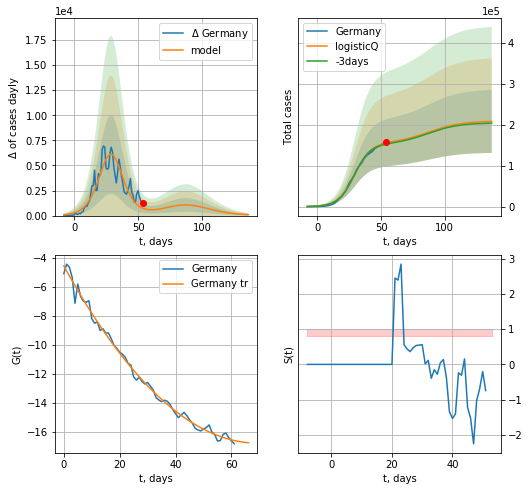

Germany data at: 2020-04-26
+3 day model MAPE: 0.019008462351765464
model: logisticQ
coeffs:  [ 1.54990401e+05  1.87791071e-06  2.92153485e+01 -8.34783655e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.36969092821748617
forecast at the end of period: +83 days
	 deltaDaycases:  88
	 total cases:  208133 ± 76945
	 total death:  7883 ± 8742
trend coefficient of determination: 0.993116
 intercept_: -4.555510596805334
 coeffs_: [ 0.         -0.35077338  0.00252017]


In [119]:
x = forecastRRR('Germany',dfGR[:],d1,16*7-dT,1.0,addpred=True,xcoef=[0.35,.5,3.0,1])

In [120]:
#x = forecast('USA',dfUS[:],d1,28*3-dT,1.0)

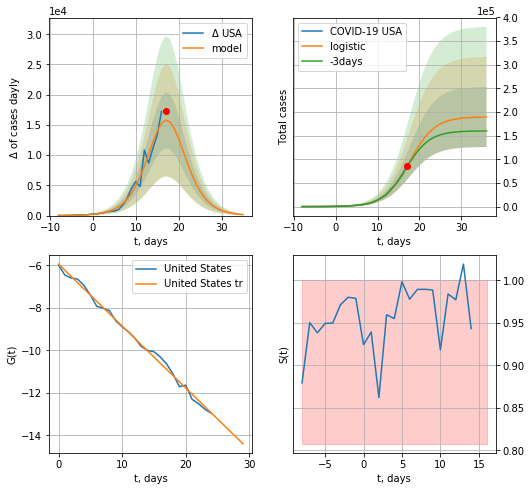

USA data at: 2020-04-26
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +19 days
	 deltaDaycases:  165
	 total cases:  189581 ± 63508
	 total death:  10640 ± 10692
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


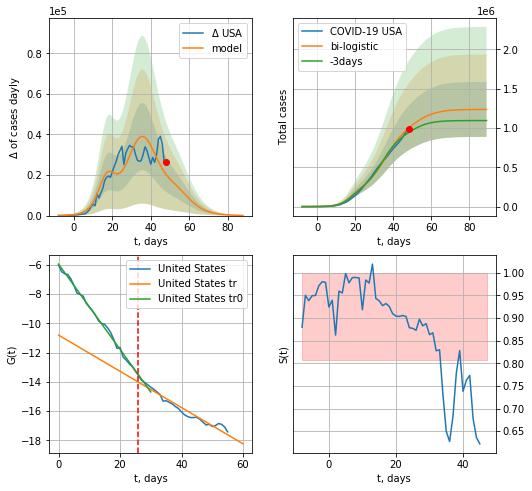

USA data at: 2020-04-26
+3 day model MAPE: 0.06463514589451148
model: bi-logistic
coeffs:  [8.37446542e+05 1.78779323e-01 3.57679522e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.28290146117579806
forecast at the end of period: +41 days
	 deltaDaycases:  85
	 total cases:  1236369 ± 349770
	 total death:  69393 ± 58894
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.950738
 intercept: -10.799185
 slope: -0.124035


In [121]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

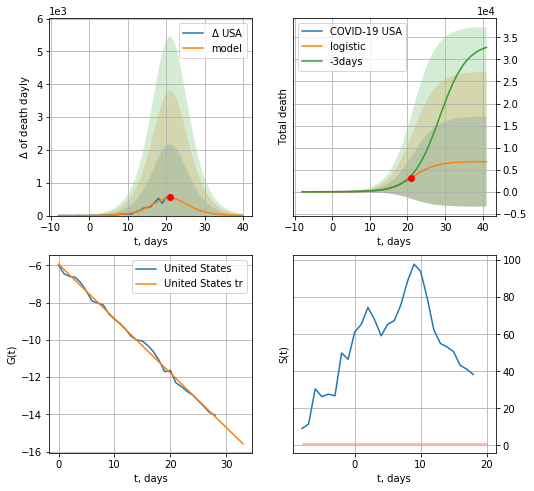

USA data at: 2020-04-26
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +20 days
	 total death:  6819 ± 10181
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


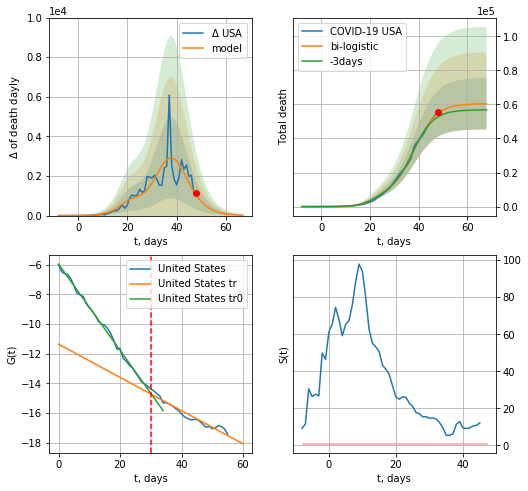

USA data at: 2020-04-26
+3 day model MAPE: 0.041204593956574
model: bi-logistic
coeffs:  [5.36131398e+04 2.17617983e-01 3.82803031e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.24938811581651718
forecast at the end of period: +20 days
	 deltaDaydeath:  20
	 total death:  60363 ± 15054
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.940290
 intercept: -11.353045
 slope: -0.112038


In [122]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


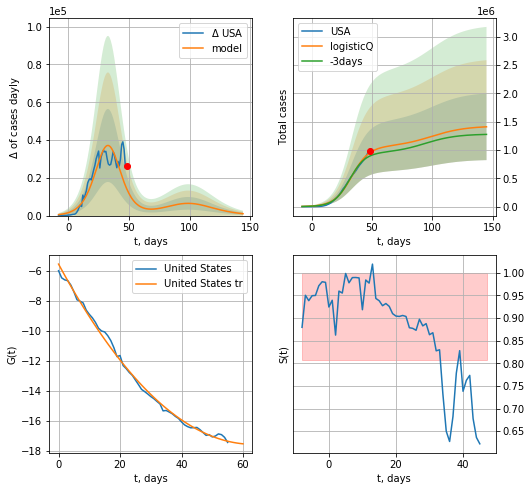

USA data at: 2020-04-26
+3 day model MAPE: 0.06855185970871454
model: logisticQ
coeffs:  [ 1.05373556e+06  2.16506379e-06  3.31136081e+01 -6.46877237e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.4173128149670625
forecast at the end of period: +97 days
	 deltaDaycases:  1002
	 total cases:  1408160 ± 587643
	 total death:  79035 ± 98946
trend coefficient of determination: 0.996160
 intercept_: -5.5500778777018684
 coeffs_: [ 0.         -0.37907854  0.00299437]


In [123]:
x = forecastRRR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=True,xcoef=[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


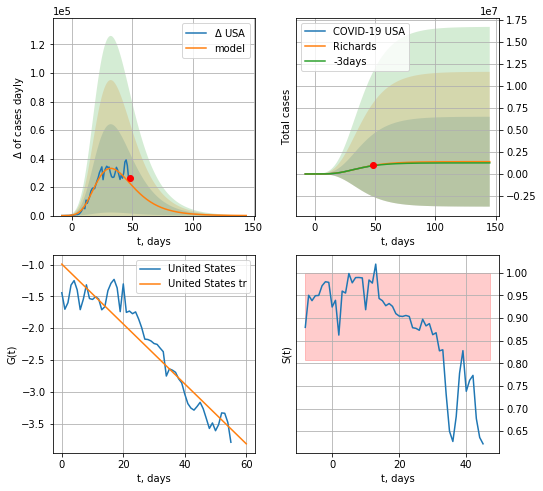

USA data at: 2020-04-26
+3 day model MAPE: 0.03536649445731177
model: Richards
coeffs:  [ 1.39708799e+06  5.14530394e+00 -3.45788890e+01  1.26141917e-02]
rational stdev:  3.653762380757562
forecast at the end of period: +97 days
	 deltaDaycases:  64
	 total cases:  1396127 ± 5101119
	 total death:  78359 ± 858915
trend coefficient of determination: 0.893288
 intercept: -0.993322
 slope: -0.047098


In [126]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


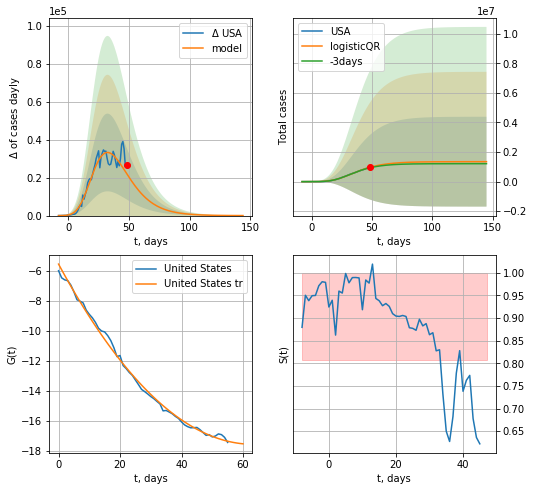

USA data at: 2020-04-26
+3 day model MAPE: 0.03725612186684371
model: logisticQR
coeffs:  [ 1.34851687e+06  2.24695001e-02 -6.17052583e+01 -5.97861074e+02
  4.12942031e-03]
rational stdev:  2.2532144564316887
forecast at the end of period: +97 days
	 deltaDaycases:  19
	 total cases:  1348304 ± 3038020
	 total death:  75675 ± 511536
trend coefficient of determination: 0.996160
 intercept_: -5.5500778777018684
 coeffs_: [ 0.         -0.37907854  0.00299437]


In [127]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

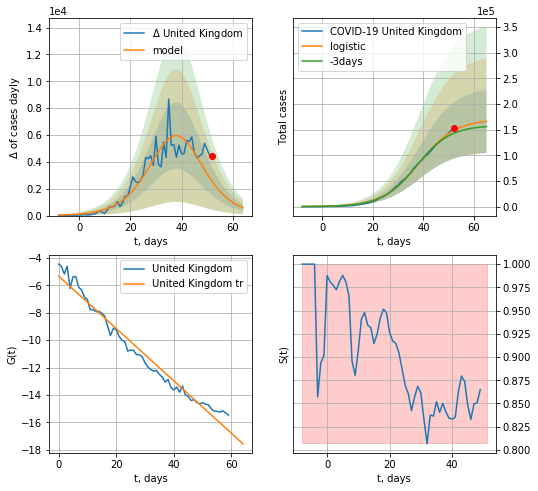

United Kingdom data at: 2020-04-26
+3 day model MAPE: 0.042206461887442
model: logistic
coeffs:  [1.69907845e+05 1.40489326e-01 3.83772747e+01]
rational stdev:  0.3695532902171538
forecast at the end of period: +13 days
	 deltaDaycases:  578
	 total cases:  165966 ± 61333
	 total death:  22512 ± 24958
trend coefficient of determination: 0.970814
 intercept: -5.316052
 slope: -0.191394


In [128]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

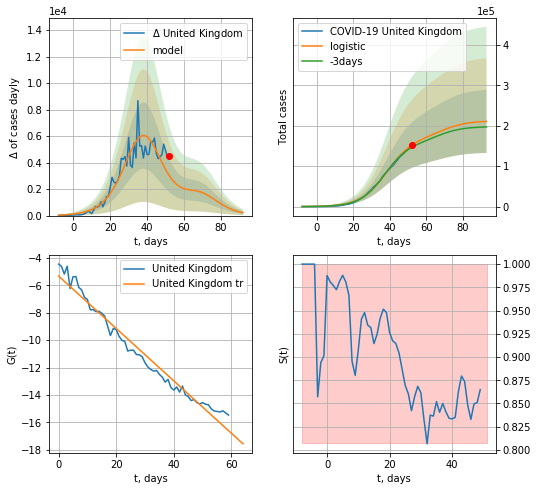

United Kingdom data at: 2020-04-26
+3 day model MAPE: 0.03851451777710171
model: logistic
coeffs:  [1.69907845e+05 1.40489326e-01 3.83772747e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3695532902171538
forecast at the end of period: +41 days
	 deltaDaycases:  218
	 total cases:  210880 ± 77931
	 total death:  28604 ± 31712
trend coefficient of determination: 0.970814
 intercept: -5.316052
 slope: -0.191394


In [129]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:130: RuntimeWarning: divide by zero encountered in true_divide


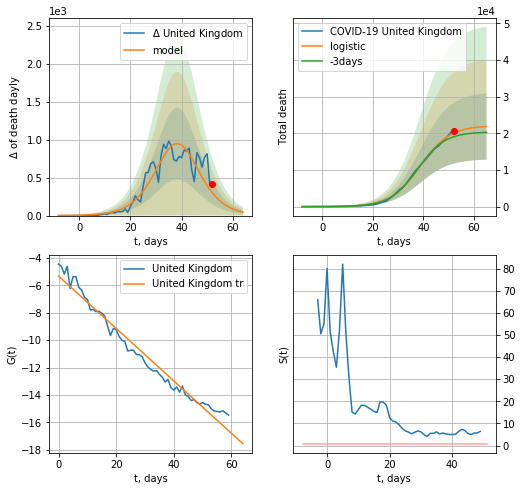

United Kingdom data at: 2020-04-26
+3 day model MAPE: 0.05554632368102066
model: logistic
coeffs:  [2.21104390e+04 1.71536438e-01 3.87892367e+01]
rational stdev:  0.41420014701609864
forecast at the end of period: +13 days
	 total death:  21866 ± 9057
trend coefficient of determination: 0.970814
 intercept: -5.316052
 slope: -0.191394


In [130]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


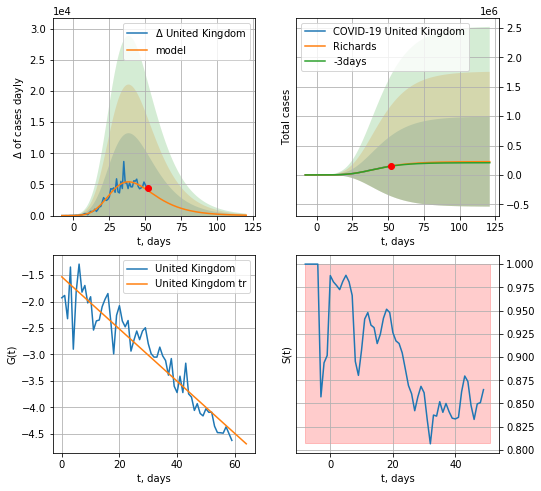

United Kingdom data at: 2020-04-26
+3 day model MAPE: 0.016545719275142617
model: Richards
coeffs:  [2.26210819e+05 7.44396622e-01 3.65159868e+00 9.14703438e-02]
rational stdev:  3.3950127874416953
forecast at the end of period: +69 days
	 deltaDaycases:  58
	 total cases:  225374 ± 765150
	 total death:  30570 ± 311356
trend coefficient of determination: 0.886965
 intercept: -1.532495
 slope: -0.049333


In [132]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


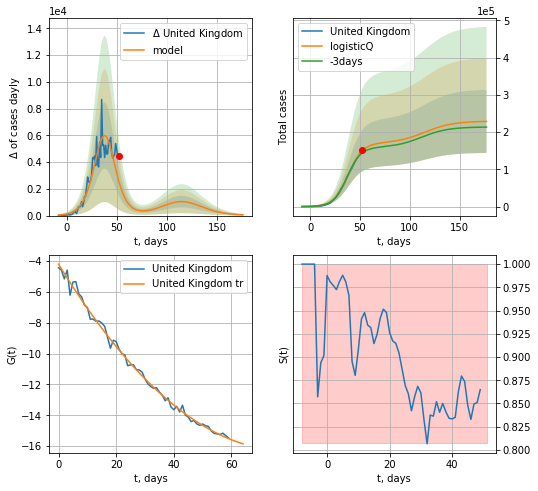

United Kingdom data at: 2020-04-26
+3 day model MAPE: 0.04241580992334279
model: logisticQ
coeffs:  [ 1.69851338e+05  3.36754698e-06  3.83724842e+01 -4.16892392e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.36976523181066673
forecast at the end of period: +125 days
	 deltaDaycases:  54
	 total cases:  228550 ± 84510
	 total death:  31001 ± 34389
trend coefficient of determination: 0.994632
 intercept_: -4.214665263162414
 coeffs_: [ 0.         -0.30536502  0.00193201]


In [134]:
x = forecastRRR('United Kingdom',dfGB[:],d1,22*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1])

In [583]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [231]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [232]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [233]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [234]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [135]:
dT

29

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


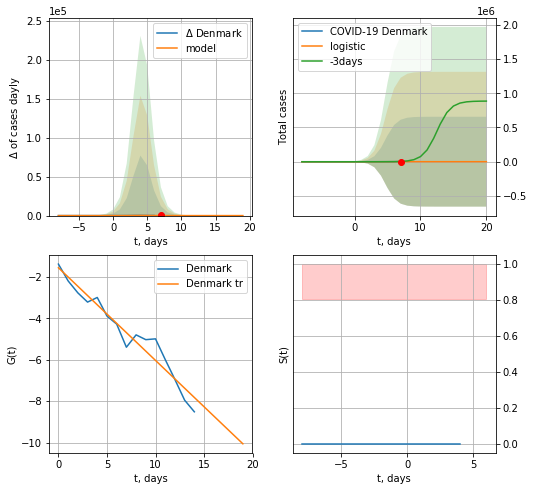

Denmark data at: 2020-04-26
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  849 ± 655796
	 total death:  41 ± 94991
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


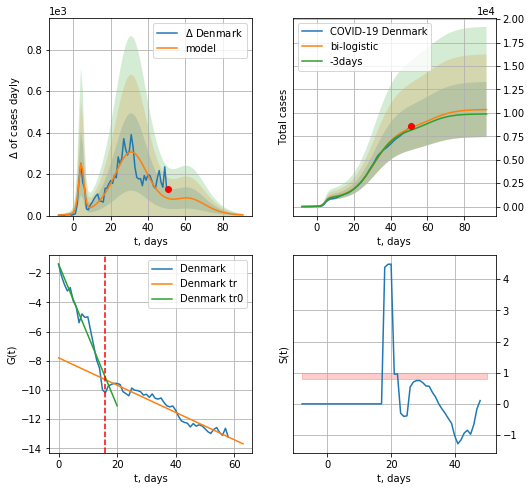

Denmark data at: 2020-04-26
+3 day model MAPE: 0.03204187246059218
model: bi-logistic
coeffs:  [7.61930124e+03 1.60054541e-01 3.13855412e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2838683115440829
forecast at the end of period: +41 days
	 deltaDaycases:  3
	 total cases:  10355 ± 2939
	 total death:  509 ± 433
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.931965
 intercept: -7.799860
 slope: -0.093442


In [136]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


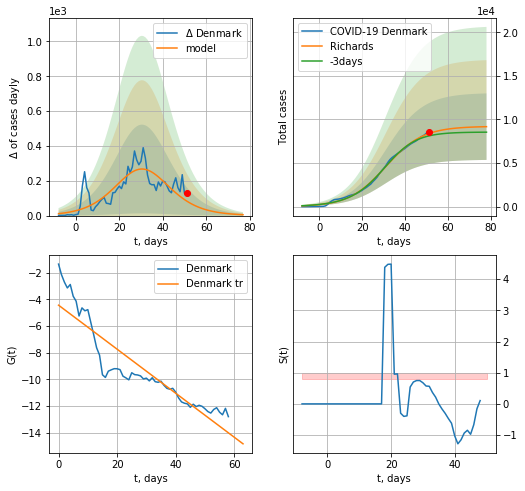

Denmark data at: 2020-04-26
+3 day model MAPE: 0.035929253846740665
model: Richards
coeffs:  [9.21626911e+03 1.20371106e-01 3.04829402e+01 9.50306736e-01]
rational stdev:  0.41600570713528834
forecast at the end of period: +27 days
	 deltaDaycases:  5
	 total cases:  9174 ± 3816
	 total death:  451 ± 562
trend coefficient of determination: 0.834919
 intercept: -4.432808
 slope: -0.165126


In [137]:
x = forecastRR('Denmark',dfDK[:],d1,8*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


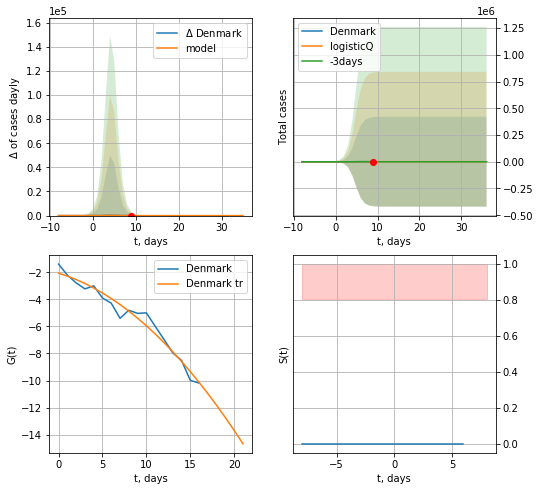

Denmark data at: 2020-04-26
+3 day model MAPE: 2.8796082172970983
model: logisticQ
coeffs:  [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev:  487.269302283167
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  862 ± 420260
	 total death:  42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:236: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


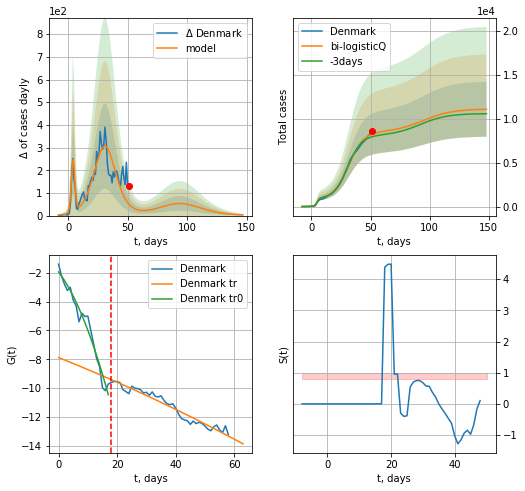

Denmark data at: 2020-04-26
+3 day model MAPE: 0.037429696217370204
model: bi-logisticQ
coeffs:  [ 7.59728078e+03  2.09838162e-06  3.13961095e+01 -7.65992358e+04] [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.2820603840977559
forecast at the end of period: +97 days
	 deltaDaycases:  2
	 total cases:  11084 ± 3126
	 total death:  545 ± 461
bi-logistic approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.946658
 intercept_: -7.88594924775542
 coeffs_: [ 0.         -0.08103016 -0.00022446]


In [138]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,18*7-dT,x,addpred=True,xcoef=[0.35,0.5,3.,1.],vL=18)

NG
          date  cases  active  death
56 2020-04-22   7538    7119  187.0
57 2020-04-23   7601    7175  194.0
58 2020-04-24   7663    7232  199.0
59 2020-04-25   7699    7266  201.0
60 2020-04-26   7727    7294  201.0


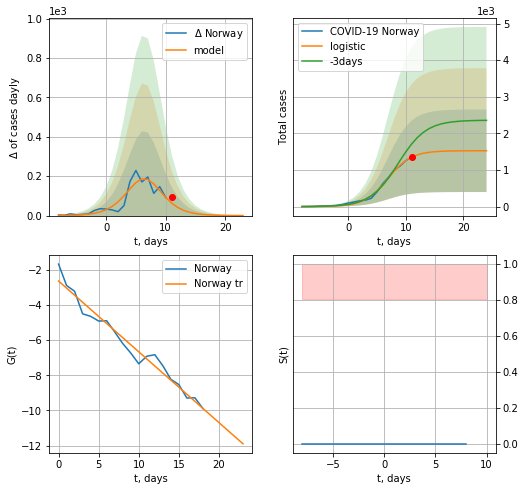

Norway data at: 2020-04-26
+3 day model MAPE: 0.2502281799322165
model: logistic
coeffs:  [1.52640478e+03 4.94422485e-01 6.88129606e+00]
rational stdev:  0.7387731713654421
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1526 ± 1127
	 total death:  40 ± 88
trend coefficient of determination: 0.966509
 intercept: -2.636780
 slope: -0.402751


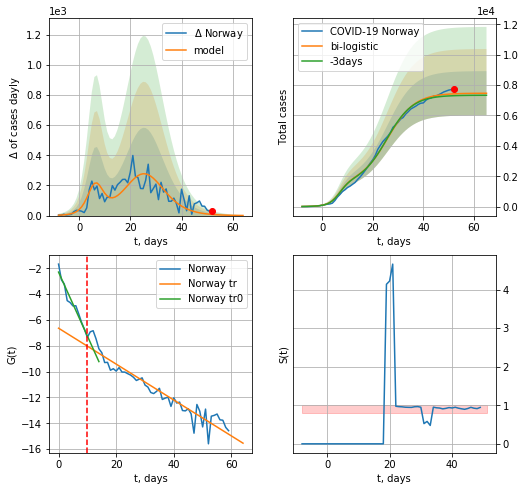

Norway data at: 2020-04-26
+3 day model MAPE: 0.01694572611939259
model: bi-logistic
coeffs:  [5.93674870e+03 1.87435763e-01 2.58497553e+01] [1.52640478e+03 4.94422485e-01 6.88129606e+00]
rational stdev:  0.19505344200223737
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  7459 ± 1454
	 total death:  199 ± 116
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.940744
 intercept: -2.292996
 slope: -0.494843
trend coefficient of determination: 0.911717
 intercept: -6.635861
 slope: -0.139098


In [139]:
dfNG = read_df(pd.DataFrame(),"NG")
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0)
#xx = np.concatenate((x, xx), axis=0)

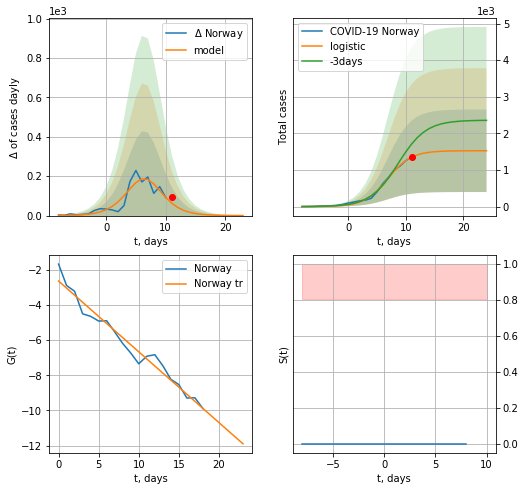

Norway data at: 2020-04-26
+3 day model MAPE: 0.2502281799322165
model: logistic
coeffs:  [1.52640478e+03 4.94422485e-01 6.88129606e+00]
rational stdev:  0.7387731713654421
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1526 ± 1127
	 total death:  40 ± 88
trend coefficient of determination: 0.966509
 intercept: -2.636780
 slope: -0.402751


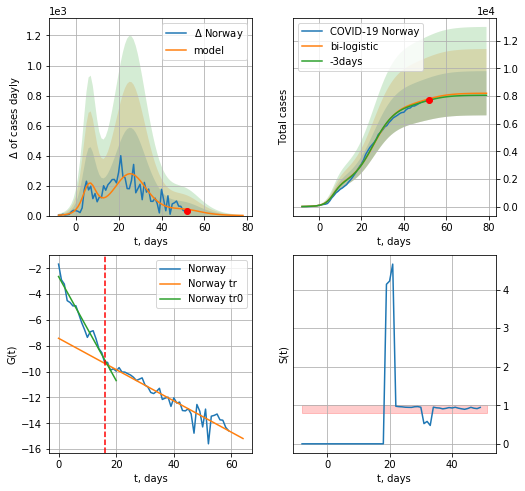

Norway data at: 2020-04-26
+3 day model MAPE: 0.013655188014438158
model: bi-logistic
coeffs:  [5.93674870e+03 1.87435763e-01 2.58497553e+01] [1.52640478e+03 4.94422485e-01 6.88129606e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.19505344200223737
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  8200 ± 1599
	 total death:  218 ± 127
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.946549
 intercept: -2.634554
 slope: -0.402912
trend coefficient of determination: 0.901840
 intercept: -7.416176
 slope: -0.121286


In [140]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


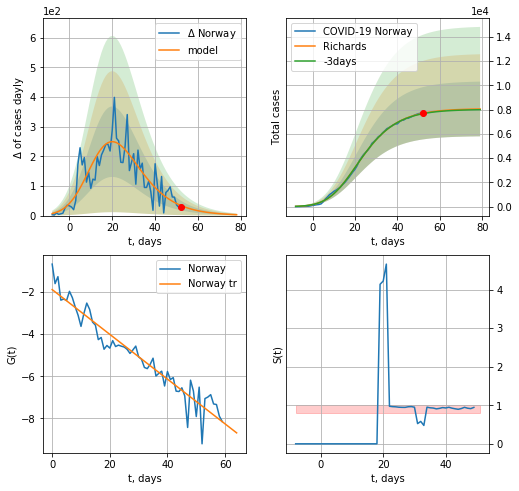

Norway data at: 2020-04-26
+3 day model MAPE: 0.004614465233268899
model: Richards
coeffs:  [8.07602939e+03 3.39093862e-01 7.25164706e+00 2.81971643e-01]
rational stdev:  0.28019190767259894
forecast at the end of period: +27 days
	 deltaDaycases:  2
	 total cases:  8046 ± 2254
	 total death:  214 ± 179
trend coefficient of determination: 0.921714
 intercept: -1.887312
 slope: -0.106190


In [141]:
x = forecastRR('Norway',dfNG[:],d1,8*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


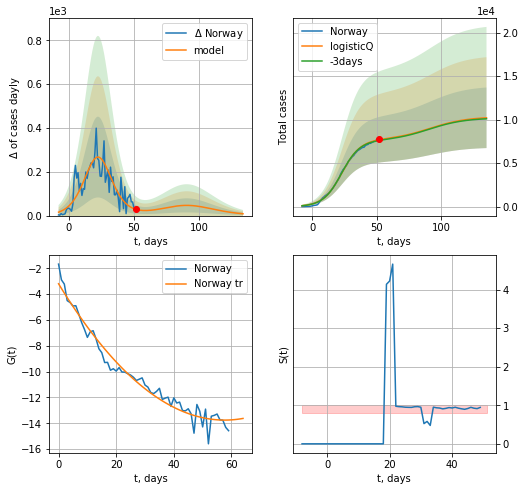

Norway data at: 2020-04-26
+3 day model MAPE: 0.010651496281232046
model: logisticQ
coeffs:  [ 7.65395824e+03  1.79183208e-06  2.27946390e+01 -7.74664664e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.34100382672225926
forecast at the end of period: +83 days
	 deltaDaycases:  8
	 total cases:  10211 ± 3482
	 total death:  272 ± 278
trend coefficient of determination: 0.965965
 intercept_: -3.1959225693432316
 coeffs_: [ 0.         -0.36621457  0.00317647]


In [142]:
x = forecastRRR('Norway',dfNG[:],d1,16*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.,1])

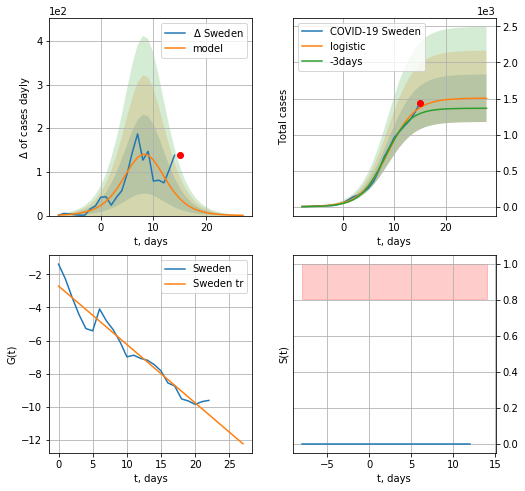

Sweden data at: 2020-04-26
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1503 ± 329
	 total death:  176 ± 115
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


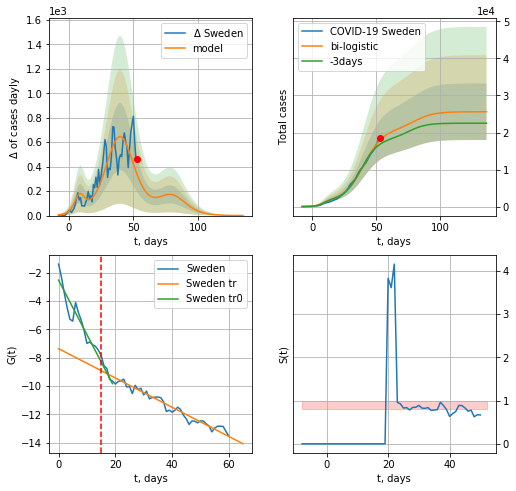

Sweden data at: 2020-04-26
+3 day model MAPE: 0.07301396778838468
model: bi-logistic
coeffs:  [1.92903282e+04 1.33277626e-01 4.00672955e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.297928339887176
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  25614 ± 7631
	 total death:  3014 ± 2693
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.951301
 intercept: -7.358343
 slope: -0.103358


In [143]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
57 2020-04-22  16004   13517  1937.0
58 2020-04-23  16755   14184  2021.0
59 2020-04-24  17567   14410  2152.0
60 2020-04-25  18177   14980  2192.0
61 2020-04-26  18640   15441  2194.0


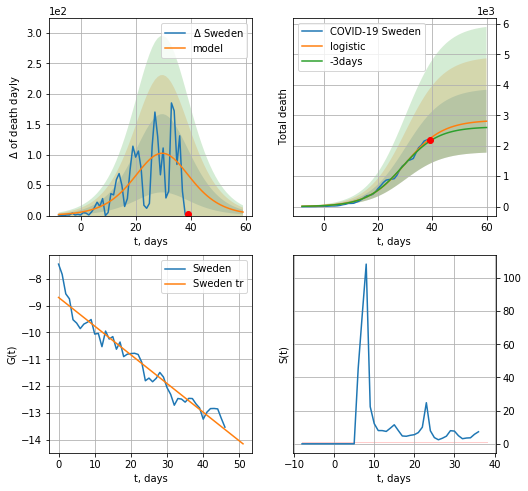

Sweden data at: 2020-04-26
+3 day model MAPE: 0.04076885953125582
model: logistic
coeffs:  [2.84348692e+03 1.44147923e-01 3.01457663e+01]
rational stdev:  0.36809271425915363
forecast at the end of period: +21 days
	 total death:  2805 ± 1032
trend coefficient of determination: 0.941803
 intercept: -8.693820
 slope: -0.106957


In [144]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


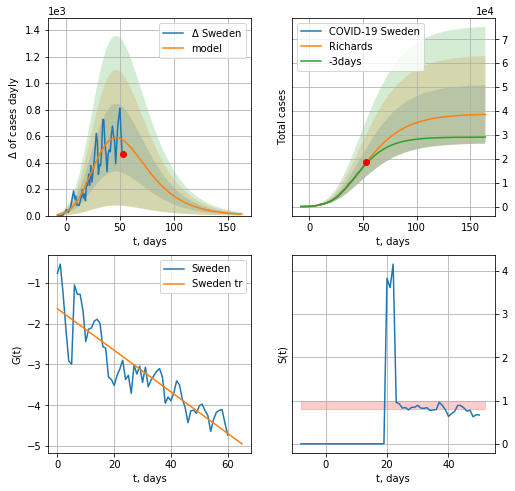

Sweden data at: 2020-04-26
+3 day model MAPE: 0.033234872520722
model: Richards
coeffs:  [ 3.87899923e+04  4.12887617e-01 -4.94489725e+00  1.05144230e-01]
rational stdev:  0.3166205276837206
forecast at the end of period: +111 days
	 deltaDaycases:  10
	 total cases:  38550 ± 12205
	 total death:  4537 ± 4309
trend coefficient of determination: 0.794082
 intercept: -1.633891
 slope: -0.050912


In [147]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


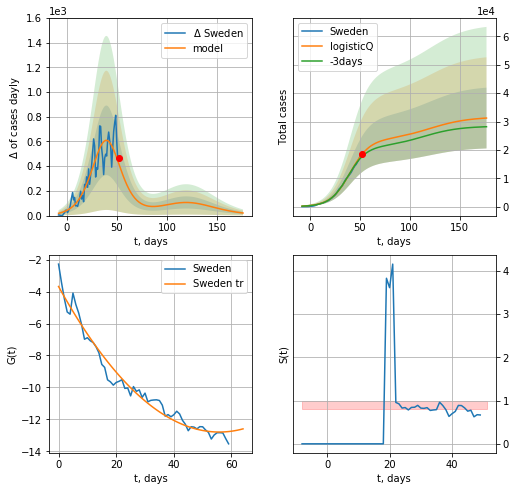

Sweden data at: 2020-04-26
+3 day model MAPE: 0.04879809862198388
model: logisticQ
coeffs:  [ 2.34295607e+04  2.64003438e-06  4.00579090e+01 -3.89468970e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.3430714851325964
forecast at the end of period: +125 days
	 deltaDaycases:  20
	 total cases:  31216 ± 10709
	 total death:  3674 ± 3781
trend coefficient of determination: 0.968806
 intercept_: -3.682773956862917
 coeffs_: [ 0.        -0.3266465  0.0029284]


In [149]:
#trend3(dfCN[:-1],dfKR,dfSG[:],'CN','KR','SG',40,40,40)
x = forecastRRR('Sweden',dfSW[1:],d1,22*7-dT,1.0,addpred=True,xcoef=[.35,.5,3.,1])

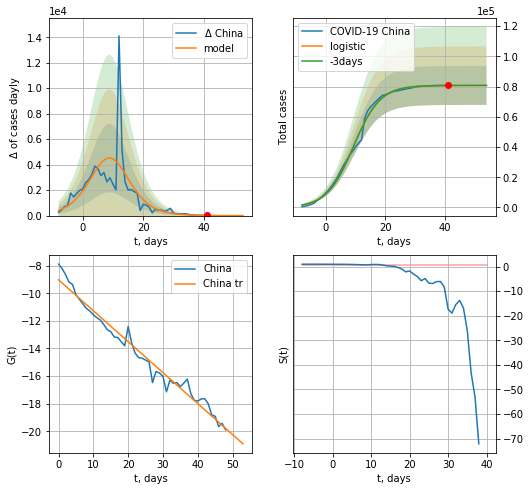

China data at: 2020-04-26
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  80806 ± 12905
	 total death:  4519 ± 2165
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


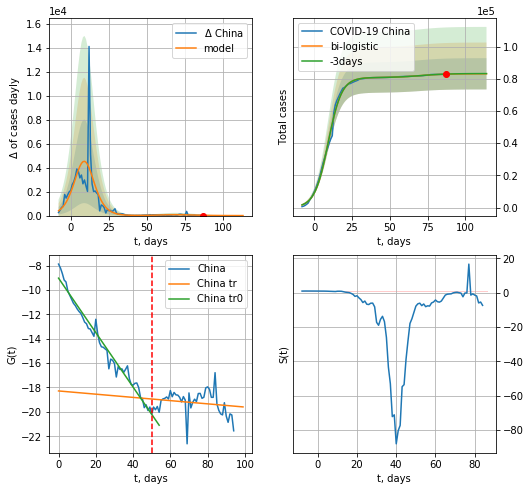

China data at: 2020-04-26
+3 day model MAPE: 0.0009084592637288639
model: bi-logistic
coeffs:  [2.37127037e+03 1.17656125e-01 6.94536517e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.1168886782036554
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  83168 ± 9721
	 total death:  4651 ± 1630
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.030386
 intercept: -18.283872
 slope: -0.013219


In [150]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [151]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

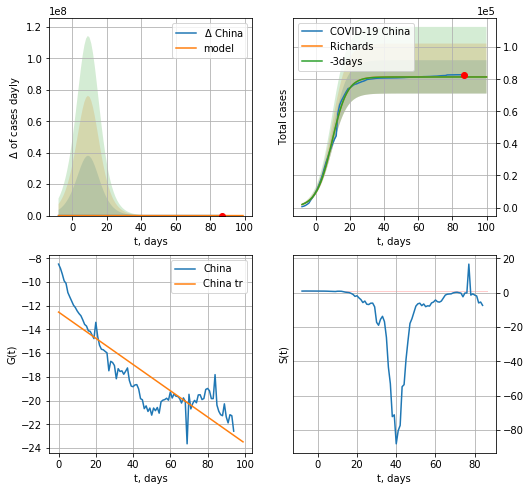

China data at: 2020-04-26
+3 day model MAPE: 0.0009256170026886521
model: Richards
coeffs:  [8.14945169e+04 2.08476454e-01 9.98556856e+00 1.09005410e+00]
rational stdev:  0.12745590229883463
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  81494 ± 10386
	 total death:  4558 ± 1742
trend coefficient of determination: 0.755213
 intercept: -12.532946
 slope: -0.110498


In [152]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

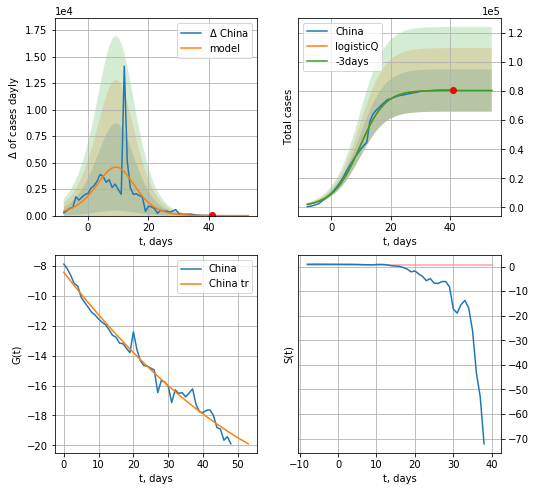

China data at: 2020-04-26
+3 day model MAPE: 0.001323463540469882
model: logisticQ
coeffs:  [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev:  0.18101878821480147
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  80417 ± 14557
	 total death:  4498 ± 2442
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:236: RuntimeWarning: overflow encountered in exp


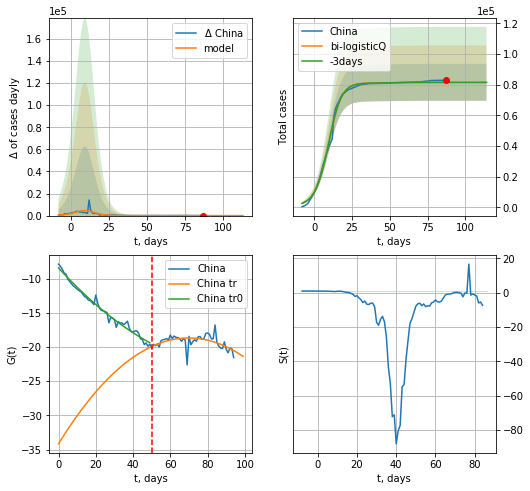

China data at: 2020-04-26
+3 day model MAPE: 0.001100266749359217
model: bi-logisticQ
coeffs:  [1.11715943e+03 9.65743607e-04 2.50215554e+01 1.40370320e-02] [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev:  0.1475034752860219
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  81534 ± 12026
	 total death:  4560 ± 2017
bi-logistic approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.274564
 intercept_: -34.16082808411436
 coeffs_: [ 0.          0.44270201 -0.00316652]


In [153]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [154]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date    cases  active  death
67 2020-04-22  10702.0  2051.0  240.0
68 2020-04-23  10708.0  1967.0  240.0
69 2020-04-24  10718.0  1843.0  240.0
70 2020-04-25  10728.0  1769.0  242.0
71 2020-04-26  10738.0  1731.0  243.0


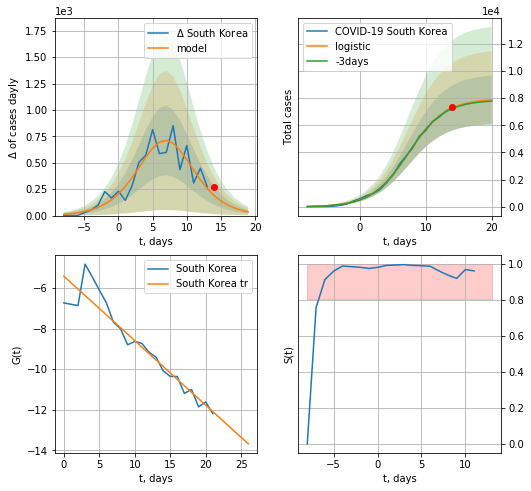

South Korea data at: 2020-04-26
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +6 days
	 deltaDaycases:  35
	 total cases:  7857 ± 1788
	 total death:  177 ± 120
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


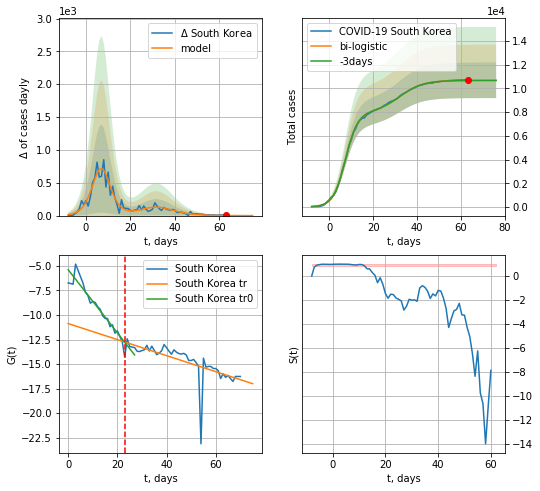

South Korea data at: 2020-04-26
+3 day model MAPE: 0.0014438772804294528
model: bi-logistic
coeffs:  [2.74256197e+03 1.87351303e-01 3.21034833e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.14052807227024397
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  10682 ± 1501
	 total death:  241 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.455619
 intercept: -10.875652
 slope: -0.081569


In [157]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,5*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,6*7-dT,x,1.0,vL=23)

In [152]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

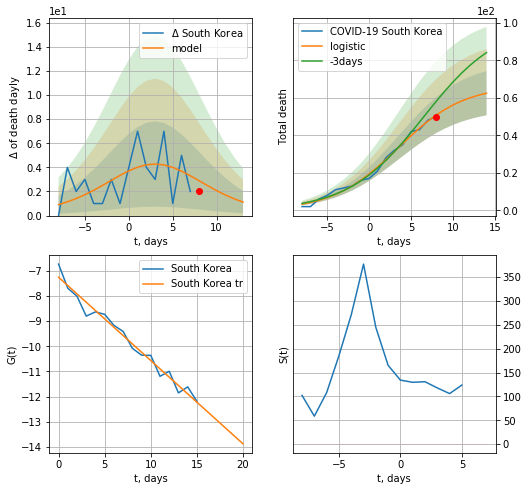

South Korea data at: 2020-04-26
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +6 days
	 total death:  62 ± 11
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


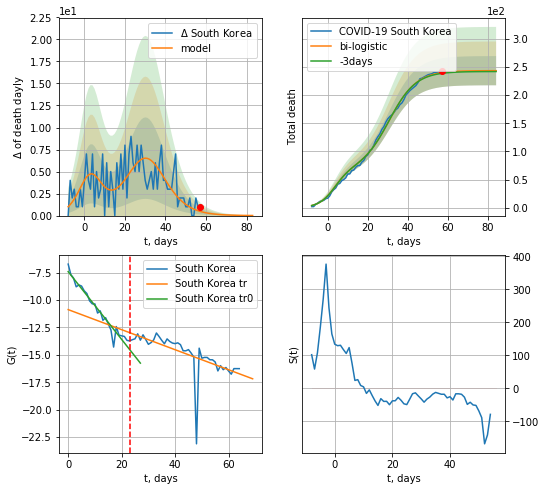

South Korea data at: 2020-04-26
+3 day model MAPE: 0.005391122651825378
model: bi-logistic
coeffs:  [1.76841682e+02 1.47301624e-01 3.06972885e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10645194334070154
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  243 ± 25
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.426037
 intercept: -10.878569
 slope: -0.091404


In [158]:
x = forecast('South Korea',dfKR[6:23],d1,5*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


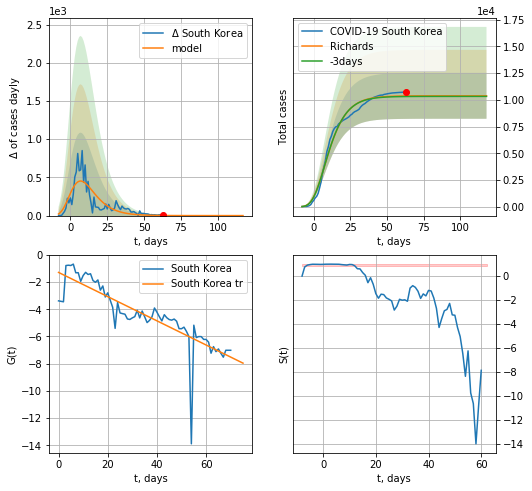

South Korea data at: 2020-04-26
+3 day model MAPE: 0.005180771918879036
model: Richards
coeffs:  [ 1.03844918e+04  3.01902718e+01 -3.92075516e+01  3.93650221e-03]
rational stdev:  0.20687684320949237
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  10384 ± 2148
	 total death:  234 ± 145
trend coefficient of determination: 0.704119
 intercept: -1.288215
 slope: -0.088989


In [159]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


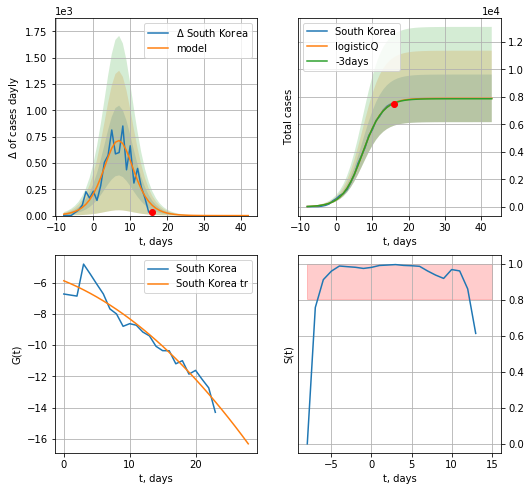

South Korea data at: 2020-04-26
+3 day model MAPE: 0.003360680685689137
model: logisticQ
coeffs:  [ 7.90013984e+03  8.06152941e-05  7.33800031e+00 -4.48711989e+03]
rational stdev:  0.2192378379068146
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  7900 ± 1732
	 total death:  178 ± 117
trend coefficient of determination: 0.934689
 intercept_: -5.890495861491463
 coeffs_: [ 0.         -0.17096071 -0.00718004]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:236: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


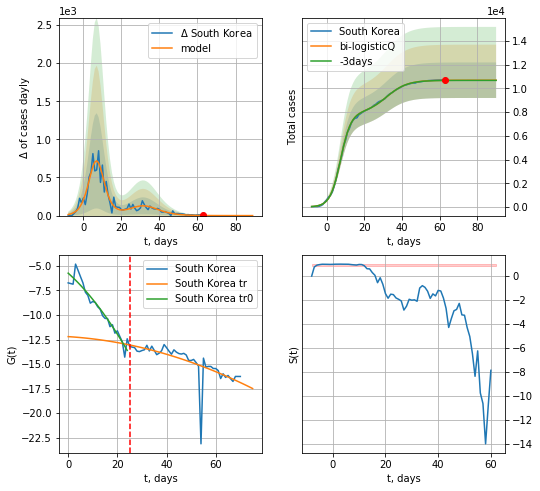

South Korea data at: 2020-04-26
+3 day model MAPE: 0.0013760856650653602
model: bi-logisticQ
coeffs:  [ 2.78736424e+03  2.44012232e-06  3.19193401e+01 -7.51577457e+04] [ 7.90013984e+03  8.06152941e-05  7.33800031e+00 -4.48711989e+03]
rational stdev:  0.140204227623333
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  10687 ± 1498
	 total death:  241 ± 101
bi-logistic approximation splitting point: 25
trend coefficient of determination: 0.925965
 intercept_: -5.745633553515705
 coeffs_: [ 0.         -0.22458651 -0.00428776]
trend coefficient of determination: 0.458516
 intercept_: -12.204909734702223
 coeffs_: [ 0.         -0.01567749 -0.0007301 ]


In [160]:
vL=25
x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


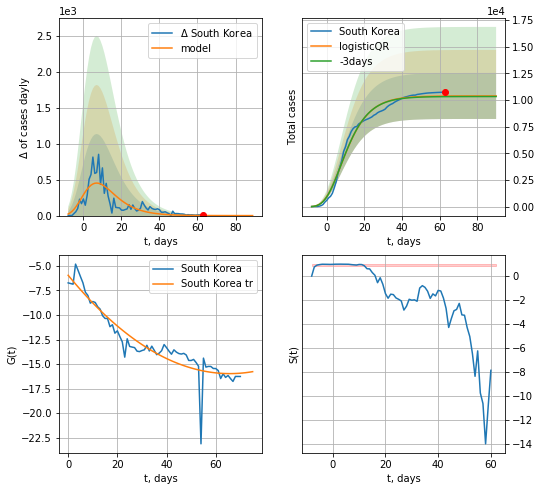

South Korea data at: 2020-04-26
+3 day model MAPE: 0.00514795277548316
model: logisticQR
coeffs:  [ 1.03748835e+04  1.59871528e-01 -6.19998591e+01 -2.03386771e+03
  3.51292930e-04]
rational stdev:  0.20757147611583066
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  10374 ± 2153
	 total death:  234 ± 145
trend coefficient of determination: 0.865096
 intercept_: -5.960729960998801
 coeffs_: [ 0.         -0.30451194  0.00231621]


In [161]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
          date  cases  active  death
90 2020-04-22  10141    9233   12.0
91 2020-04-23  11178   10242   12.0
92 2020-04-24  12075   11107   12.0
93 2020-04-25  12693   11679   12.0
94 2020-04-26  13624   12552   12.0


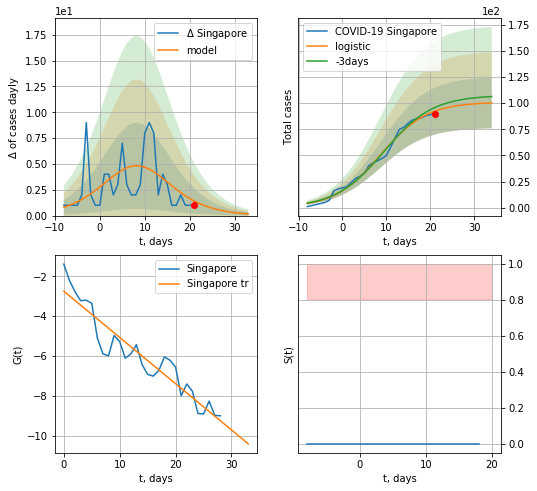

Singapore data at: 2020-04-26
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  100 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


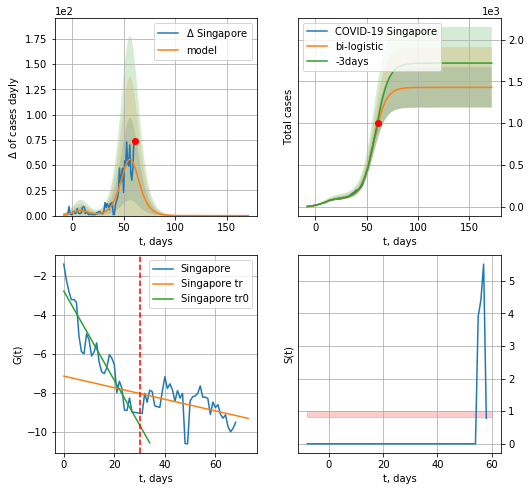

Singapore data at: 2020-04-26
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +111 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


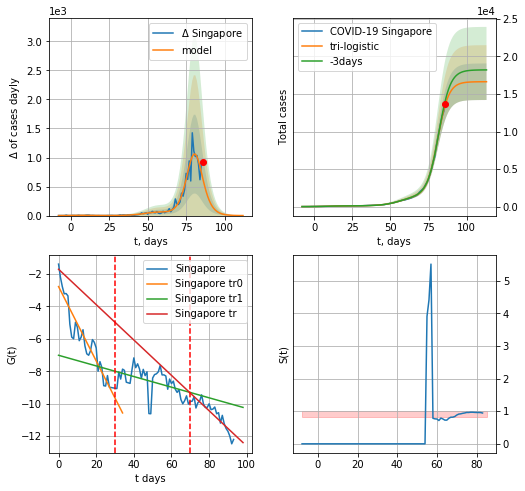

Singapore data at: 2020-04-26
+3 day model MAPE: 0.046484289712055385
model: tri-logistic
coeffs:  [1.52041219e+04 2.79210802e-01 8.10037631e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14634783914506286
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  16629 ± 2433
	 total death:  14 ± 6
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.816342
 intercept: -1.701537
 slope: -0.109138


In [163]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


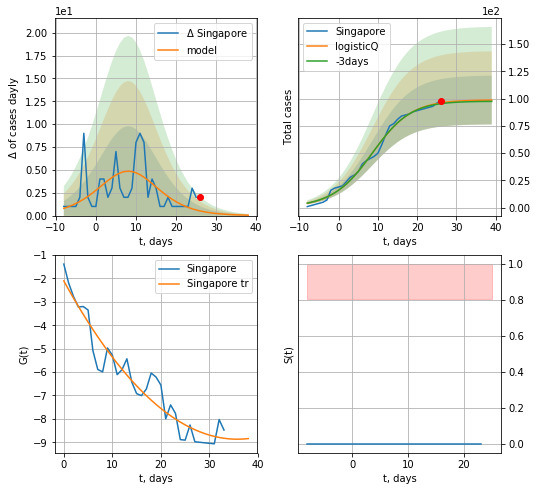

Singapore data at: 2020-04-26
+3 day model MAPE: 0.00815790072727744
model: logisticQ
coeffs:  [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev:  0.22659881459916748
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  98 ± 22
	 total death:  0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:236: RuntimeWarning: overflow encountered in exp


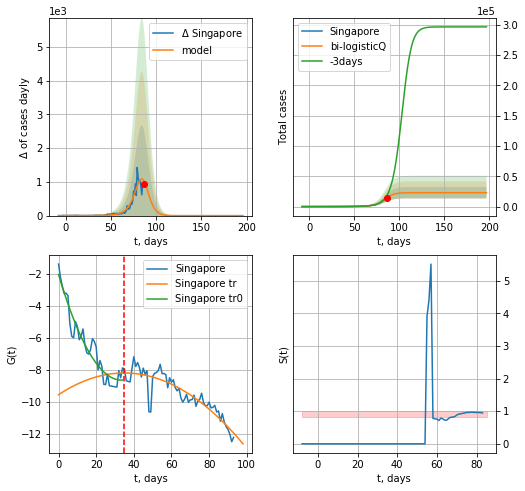

Singapore data at: 2020-04-26
+3 day model MAPE: 0.25615357224022445
model: bi-logisticQ
coeffs:  [ 2.27993366e+04  1.41928022e-03  8.36770066e+01 -5.02100919e+01] [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev:  0.40859374032777246
forecast at the end of period: +111 days
	 deltaDaycases:  0
	 total cases:  22898 ± 9356
	 total death:  20 ± 24
bi-logistic approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.797281
 intercept_: -9.53874459644518
 coeffs_: [ 0.          0.07767881 -0.00111177]


In [164]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,vL=vL)

In [165]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


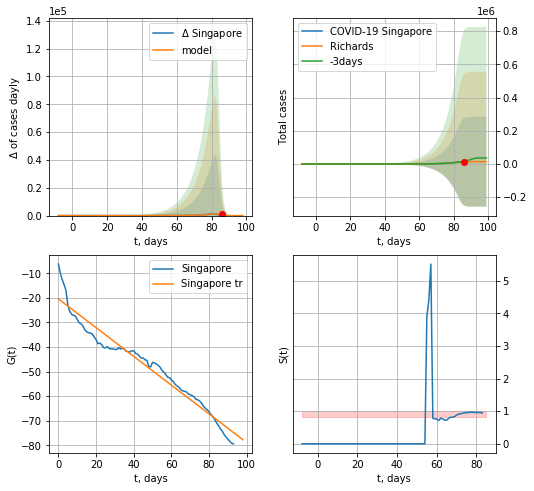

Singapore data at: 2020-04-26
+3 day model MAPE: 0.26413346062856674
model: Richards
coeffs:  [1.38106005e+04 1.26036430e-01 8.45930724e+01 8.06062299e+00]
rational stdev:  19.602408250823498
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  13810 ± 270721
	 total death:  12 ± 705
trend coefficient of determination: 0.949272
 intercept: -20.452775
 slope: -0.584587


In [166]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


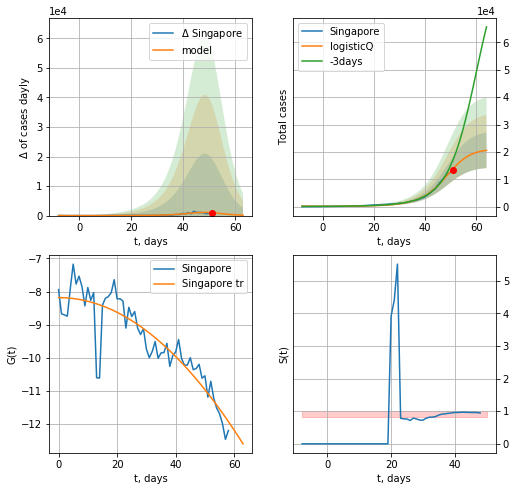

Singapore data at: 2020-04-26
+3 day model MAPE: 0.24271423935127606
model: logisticQ
coeffs:  [ 2.10493541e+04  2.21643768e-03  4.77357041e+01 -4.29080860e+01]
rational stdev:  0.3131631967727281
forecast at the end of period: +13 days
	 deltaDaycases:  132
	 total cases:  20612 ± 6455
	 total death:  18 ± 16
trend coefficient of determination: 0.797282
 intercept_: -8.183411381280441
 coeffs_: [ 0.00000000e+00  5.19456074e-06 -1.11427198e-03]


In [167]:
#trend3(dfLT,dfES,dfLV[:],'LT','ES','LV',40,40,40)
x = forecastRRR('Singapore',dfSG[35:],d1,6*7-dT,1.0)

In [168]:
#+1932/2944.#2020-04-03
#shift = 1.0#1+1849/1900.#2020-04-02
#shift = 1.+3288./2809
#x =forecast('Lithuania',dfLT[:],d1,8*7-dT,shift,addpred=True,xcoef=[0.25,1.,3.])
#xx =forecast2('Lithuania',dfLT[:],d1,3*7-dT,x)

In [169]:
#x =forecastR('Lithuania',dfLT[:],d1,7*6-dT,shift)

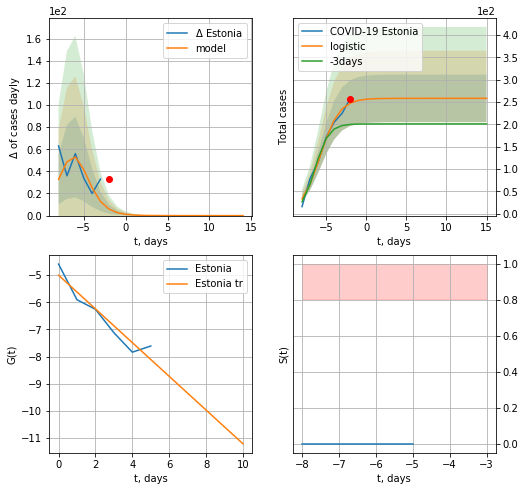

Estonia data at: 2020-04-26
+3 day model MAPE: 0.26329059885154926
model: logistic
coeffs:  [258.51169182   0.83984365  -5.73516243]
rational stdev:  0.20630354623999803
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  258 ± 53
	 total death:  7 ± 4
trend coefficient of determination: 0.908255
 intercept: -5.002820
 slope: -0.620580


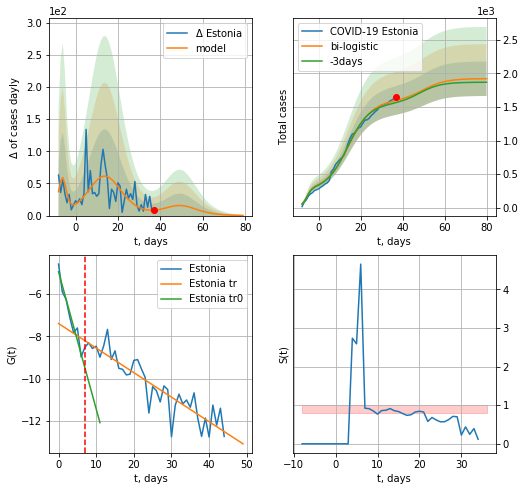

Estonia data at: 2020-04-26
+3 day model MAPE: 0.01986108012459756
model: bi-logistic
coeffs:  [1.33171257e+03 1.84416188e-01 1.42322924e+01] [258.51169182   0.83984365  -5.73516243]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.13387615970668867
forecast at the end of period: +43 days
	 deltaDaycases:  0
	 total cases:  1921 ± 257
	 total death:  57 ± 22
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.942621
 intercept: -4.958003
 slope: -0.647470
trend coefficient of determination: 0.815903
 intercept: -7.400532
 slope: -0.115863


In [170]:
shift = 1.0
x = forecast('Estonia',dfES[:7],d1,17,1.)
xx = forecast2('Estonia',dfES[:],d1,12*6-dT,x,1.,addpred=True,xcoef=[0.25,1.,3.5],vL=7)

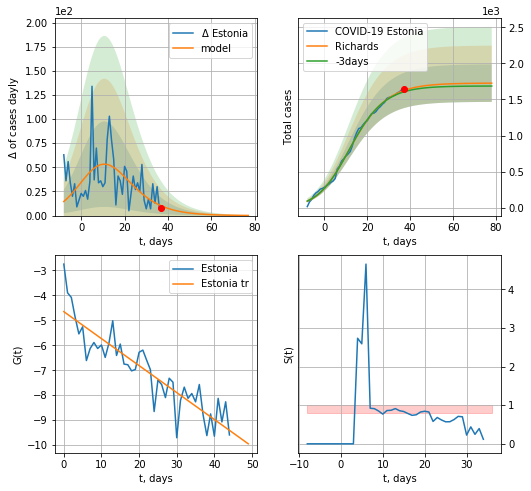

Estonia data at: 2020-04-26
+3 day model MAPE: 0.012392401076172864
model: Richards
coeffs:  [1.72709288e+03 1.85901110e-01 6.03014004e+00 5.76601720e-01]
rational stdev:  0.1504993826528031
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1725 ± 259
	 total death:  51 ± 23
trend coefficient of determination: 0.805059
 intercept: -4.651087
 slope: -0.108127


In [171]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


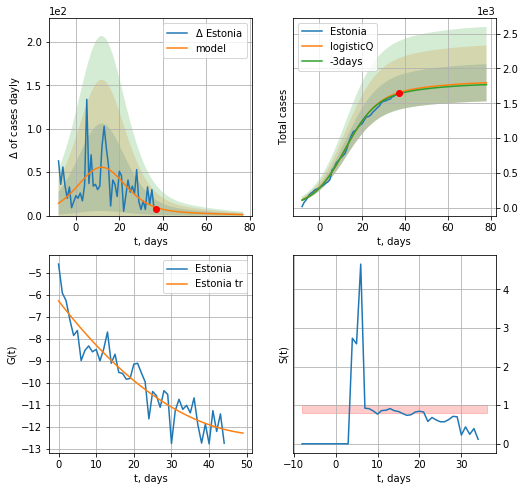

Estonia data at: 2020-04-26
+3 day model MAPE: 0.011346798633552752
model: logisticQ
coeffs:  [ 1.66773441e+03  4.15267922e-06  1.22579230e+01 -3.17411180e+04]
scenario coeffs:  [0.0875, 0.5, 4.0, 1]
rational stdev:  0.1490243409702052
forecast at the end of period: +41 days
	 deltaDaycases:  1
	 total cases:  1794 ± 267
	 total death:  53 ± 23
trend coefficient of determination: 0.871178
 intercept_: -6.2638559890325425
 coeffs_: [ 0.         -0.2213252   0.00201536]


In [172]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
46 2020-04-22  761.0   617.0   11.0
47 2020-04-23  778.0   634.0   11.0
48 2020-04-24  784.0   505.0   12.0
49 2020-04-25  804.0   525.0   12.0
50 2020-04-26  812.0   533.0   12.0


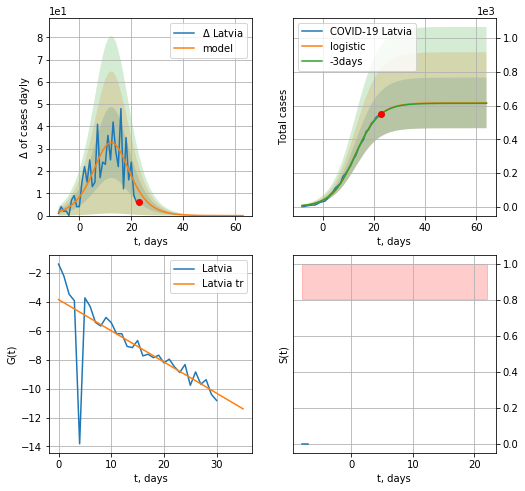

Latvia data at: 2020-04-26
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  9 ± 6
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


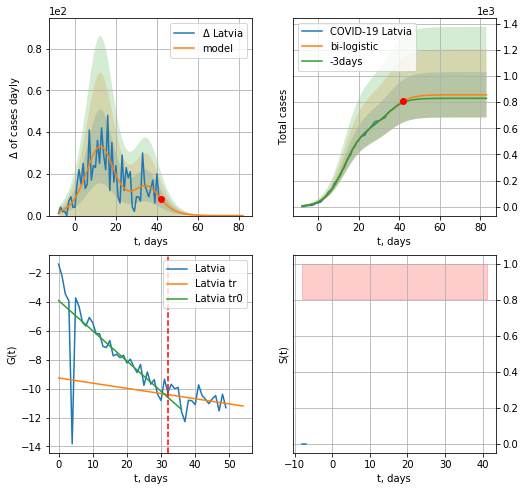

Latvia data at: 2020-04-26
+3 day model MAPE: 0.01599886928129763
model: bi-logistic
coeffs:  [2.39995062e+02 2.22746668e-01 3.55624672e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.20228268843538055
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  856 ± 173
	 total death:  12 ± 7
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.077294
 intercept: -9.259991
 slope: -0.035944


In [173]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


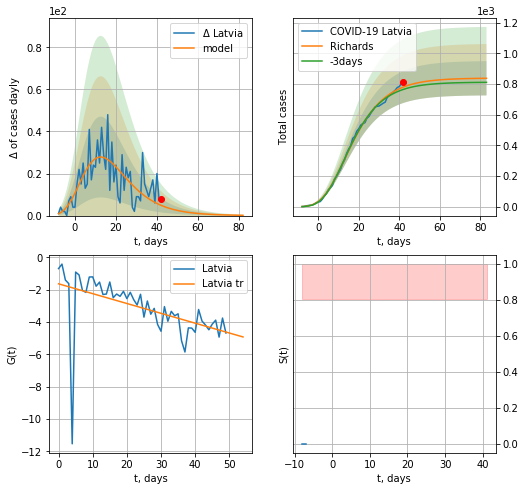

Latvia data at: 2020-04-26
+3 day model MAPE: 0.021165218258924274
model: Richards
coeffs:  [ 8.39383014e+02  9.52730256e+00 -3.82804300e+01  9.52302528e-03]
rational stdev:  0.13331911231488836
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  837 ± 111
	 total death:  12 ± 4
trend coefficient of determination: 0.250459
 intercept: -1.640571
 slope: -0.060852


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


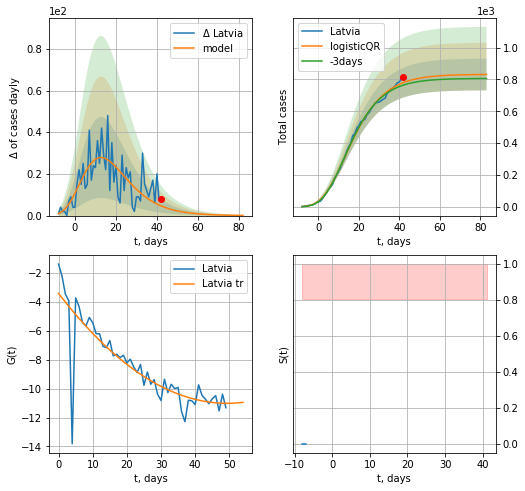

Latvia data at: 2020-04-26
+3 day model MAPE: 0.02145334646917686
model: logisticQR
coeffs:  [ 8.31669031e+02  4.54116735e-02 -5.97727408e+01 -7.91630794e+02
  2.28961513e-03]
rational stdev:  0.11991879809734256
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  830 ± 99
	 total death:  12 ± 4
trend coefficient of determination: 0.714500
 intercept_: -3.4110560534854706
 coeffs_: [ 0.         -0.30771477  0.0031137 ]


In [174]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


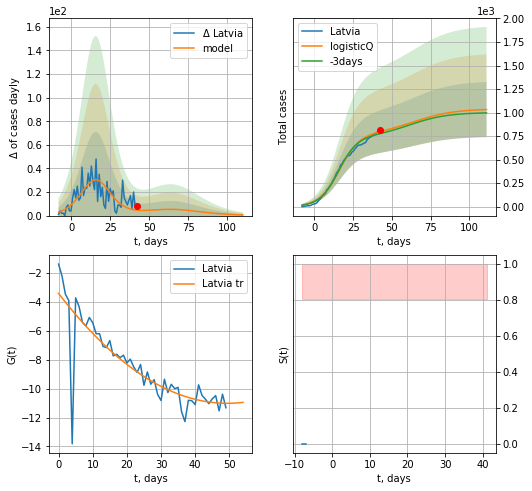

Latvia data at: 2020-04-26
+3 day model MAPE: 0.02813718644733506
model: logisticQ
coeffs:  [ 7.69895389e+02  1.26182354e-06  1.61352378e+01 -1.23328156e+05]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.2835296615791745
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  1032 ± 292
	 total death:  15 ± 12
trend coefficient of determination: 0.714500
 intercept_: -3.4110560534854706
 coeffs_: [ 0.         -0.30771477  0.0031137 ]


In [175]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=[.35,.5,4.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


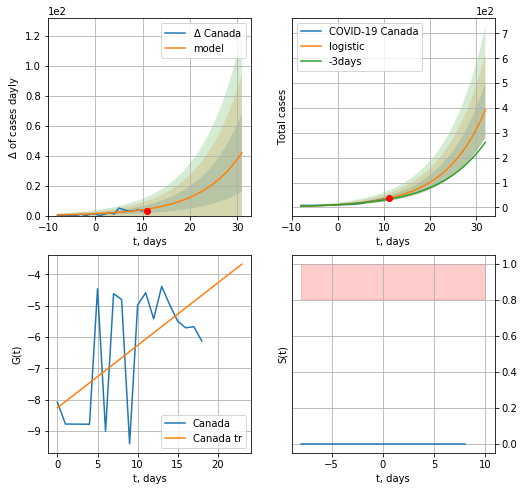

Canada data at: 2020-04-26
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  21 ± 17
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


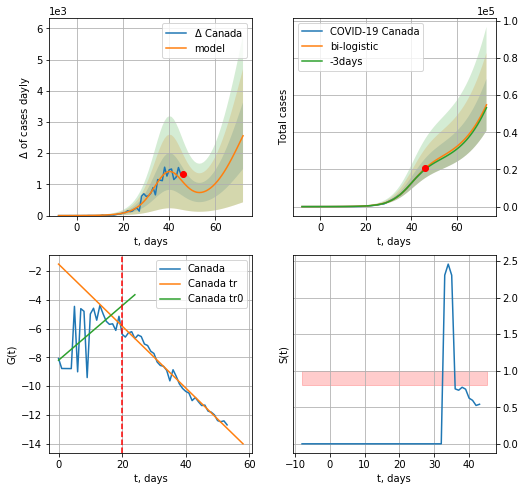

Canada data at: 2020-04-26
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +27 days
	 deltaDaycases:  2559
	 total cases:  54805 ± 13971
	 total death:  2991 ± 2287
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


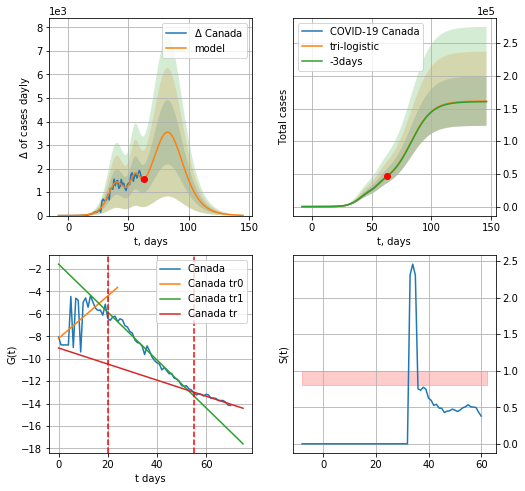

Canada data at: 2020-04-26
+3 day model MAPE: 0.014169524324311756
model: tri-logistic
coeffs:  [1.20268635e+04 3.46471587e-01 5.58825159e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.23453236788054968
forecast at the end of period: +83 days
	 deltaDaycases:  11
	 total cases:  161283 ± 37826
	 total death:  8804 ± 6194
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.911203
 intercept: -9.047623
 slope: -0.071594


In [176]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
67 2020-04-22  40190.0   24230  1974.0
68 2020-04-23  42110.0   25202  2147.0
69 2020-04-24  43888.0   26117  2302.0
70 2020-04-25  45354.0   26464  2465.0
71 2020-04-26  46895.0   27014  2560.0


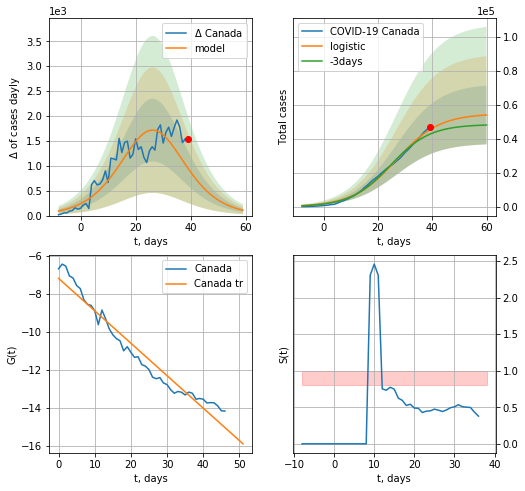

Canada data at: 2020-04-26
+3 day model MAPE: 0.06738264663020217
model: logistic
coeffs:  [5.47379592e+04 1.25533674e-01 2.66442417e+01]
rational stdev:  0.31973963937171174
forecast at the end of period: +21 days
	 deltaDaycases:  107
	 total cases:  53919 ± 17240
	 total death:  2943 ± 2822
trend coefficient of determination: 0.951121
 intercept: -7.193219
 slope: -0.170545


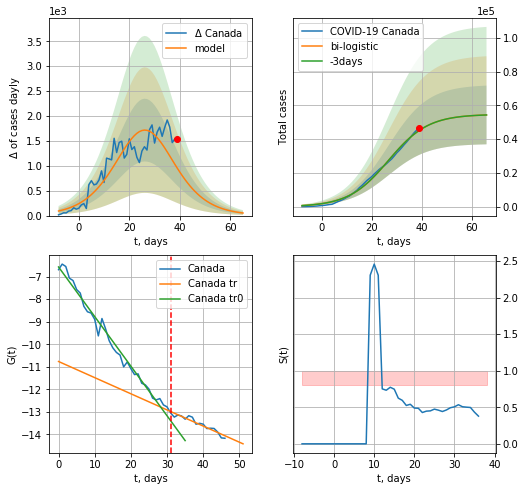

Canada data at: 2020-04-26
+3 day model MAPE: 0.0
model: bi-logistic
coeffs:  [171.28867515  -1.16544817 -37.24226438] [5.47379592e+04 1.25533674e-01 2.66442417e+01]
rational stdev:  0.31973963937171174
forecast at the end of period: +27 days
	 deltaDaycases:  51
	 total cases:  54349 ± 17377
	 total death:  2966 ± 2845
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.911203
 intercept: -10.765875
 slope: -0.071594


In [177]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,3*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,8*7-dT,x,1.,vL=31,cases='cases')

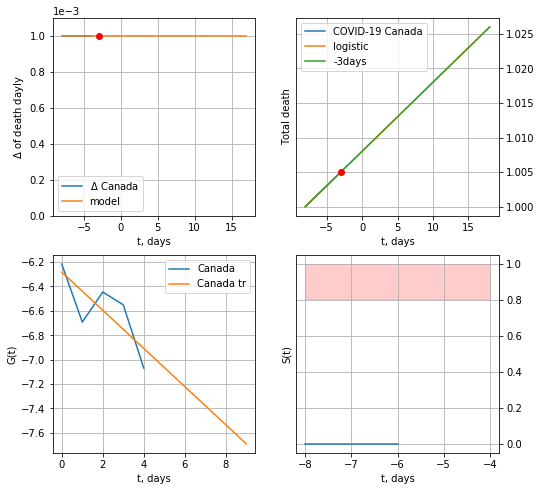

Canada data at: 2020-04-25
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


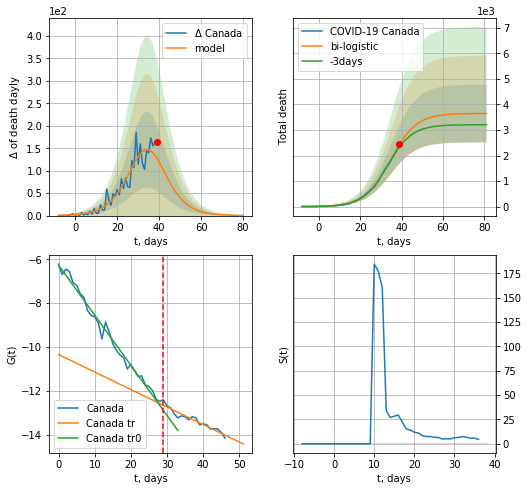

Canada data at: 2020-04-25
+3 day model MAPE: 0.05062483152176242
model: bi-logistic
coeffs:  [3.64541915e+03 1.61313845e-01 3.47167994e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3098092489458458
forecast at the end of period: +42 days
	 deltaDaydeath:  0
	 total death:  3644 ± 1129
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.921525
 intercept: -10.341911
 slope: -0.079867


In [272]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


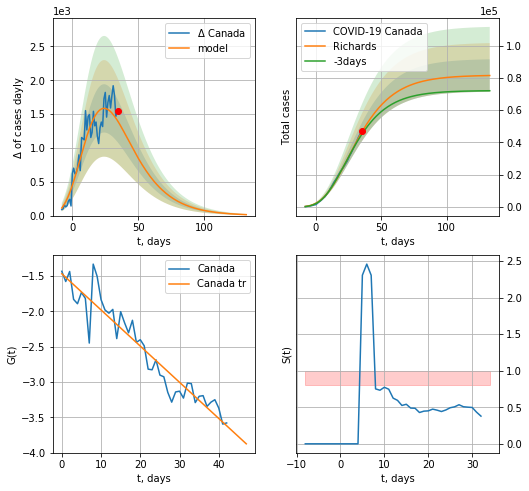

Canada data at: 2020-04-26
+3 day model MAPE: 0.03181010728844749
model: Richards
coeffs:  [ 8.17626496e+04  3.49062418e+00 -5.42135099e+01  1.52154836e-02]
rational stdev:  0.12324812183568545
forecast at the end of period: +98 days
	 deltaDaycases:  14
	 total cases:  81504 ± 10045
	 total death:  4449 ± 1644
trend coefficient of determination: 0.905984
 intercept: -1.466953
 slope: -0.051223


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app


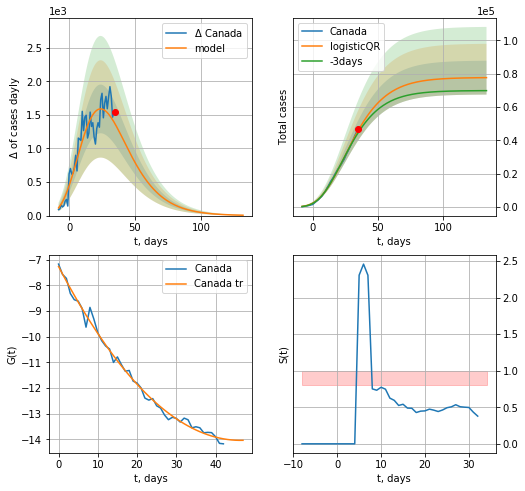

Canada data at: 2020-04-26
+3 day model MAPE: 0.03216094631792431
model: logisticQR
coeffs:  [ 7.77349008e+04  1.15858162e-02 -8.22437139e+01 -6.58390740e+02
  6.10005329e-03]
rational stdev:  0.13075606359346653
forecast at the end of period: +98 days
	 deltaDaycases:  5
	 total cases:  77659 ± 10154
	 total death:  4239 ± 1662
trend coefficient of determination: 0.992693
 intercept_: -7.267224606005135
 coeffs_: [ 0.         -0.29223541  0.00315415]


In [178]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


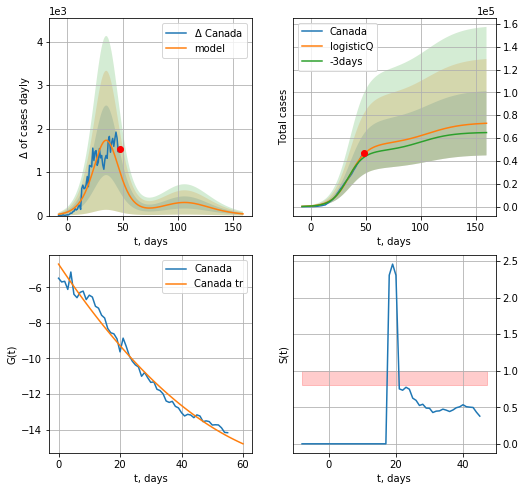

Canada data at: 2020-04-26
+3 day model MAPE: 0.06719859880740826
model: logisticQ
coeffs:  [ 5.44990931e+04  2.18323492e-06  3.55610097e+01 -5.77818110e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.38540976778783975
forecast at the end of period: +112 days
	 deltaDaycases:  39
	 total cases:  72941 ± 28112
	 total death:  3981 ± 4602
trend coefficient of determination: 0.983274
 intercept_: -4.7014547727473595
 coeffs_: [ 0.         -0.25919321  0.0015159 ]


In [179]:
x = forecastRRR('Canada',dfCA[15:],d1,7*16,1.,addpred=True,xcoef=[0.35,.5,3,1])

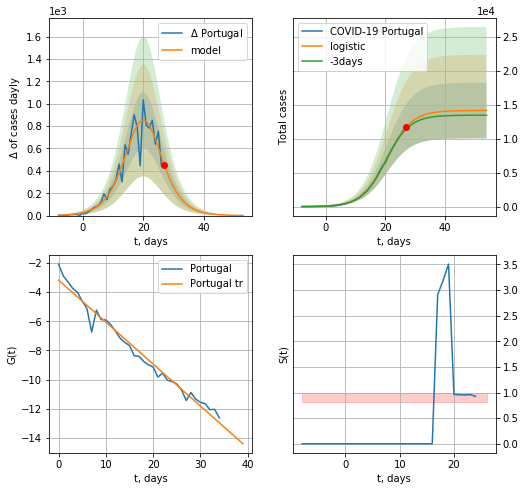

Portugal data at: 2020-04-26
+3 day model MAPE: 0.02892624169663467
model: logistic
coeffs:  [1.41442510e+04 2.41786786e-01 2.05224861e+01]
rational stdev:  0.2898390257045352
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  14139 ± 4098
	 total death:  535 ± 465
trend coefficient of determination: 0.976589
 intercept: -3.176863
 slope: -0.287805


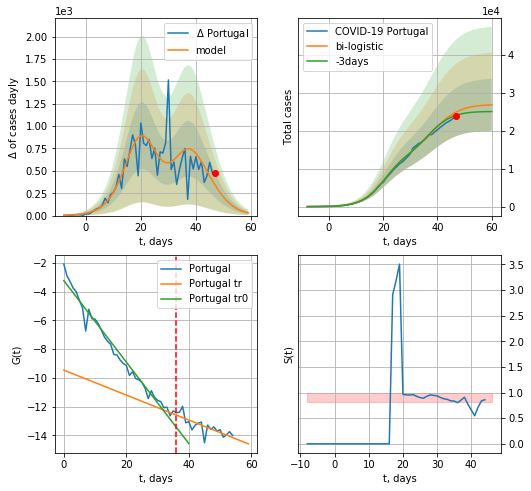

Portugal data at: 2020-04-26
+3 day model MAPE: 0.04073342958806919
model: bi-logistic
coeffs:  [1.02132562e+04 2.43692088e-01 3.76592403e+01] [1.41442510e+04 2.41786786e-01 2.05224861e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.25522974615858995
forecast at the end of period: +13 days
	 deltaDaycases:  30
	 total cases:  26798 ± 6839
	 total death:  1014 ± 776
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975280
 intercept: -3.225895
 slope: -0.283479
trend coefficient of determination: 0.600355
 intercept: -9.451884
 slope: -0.086935


In [180]:
vL = 36
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


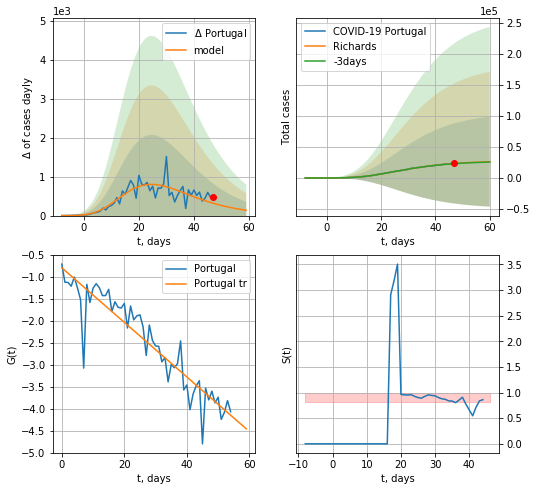

Portugal data at: 2020-04-26
+3 day model MAPE: 0.015597034331407508
model: Richards
coeffs:  [ 2.79568550e+04  5.78740689e+00 -2.97882317e+01  1.35514420e-02]
rational stdev:  2.756485986795354
forecast at the end of period: +13 days
	 deltaDaycases:  137
	 total cases:  26210 ± 72248
	 total death:  991 ± 8195
trend coefficient of determination: 0.856143
 intercept: -0.795211
 slope: -0.061915


In [181]:
x = forecastRR('Portugal',dfPT[:],d1,6*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


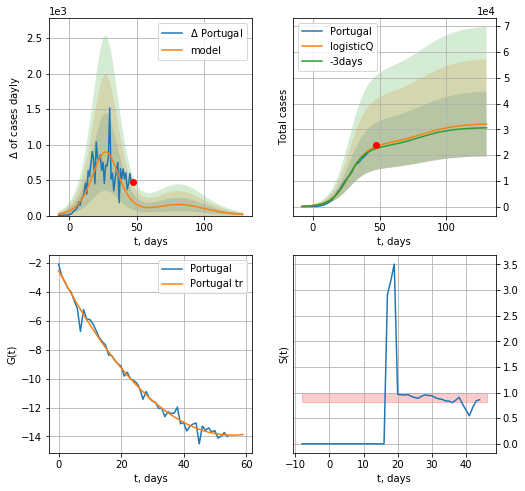

Portugal data at: 2020-04-26
+3 day model MAPE: 0.036875029678418894
model: logisticQ
coeffs:  [ 2.39121418e+04  1.83922117e-06  2.73202467e+01 -8.06496612e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3916959277962119
forecast at the end of period: +83 days
	 deltaDaycases:  17
	 total cases:  32051 ± 12554
	 total death:  1212 ± 1424
trend coefficient of determination: 0.990254
 intercept_: -2.5198067931096926
 coeffs_: [ 0.         -0.41057542  0.00370039]


In [182]:
x = forecastRRR('Portugal',dfPT[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1])

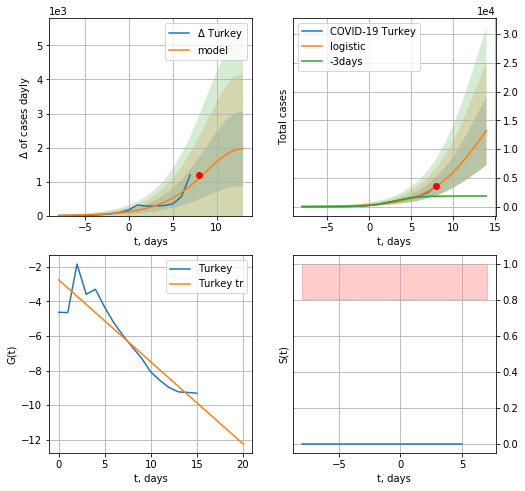

Turkey data at: 2020-04-26
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +6 days
	 deltaDaycases:  1970
	 total cases:  13211 ± 6013
	 total death:  336 ± 458
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


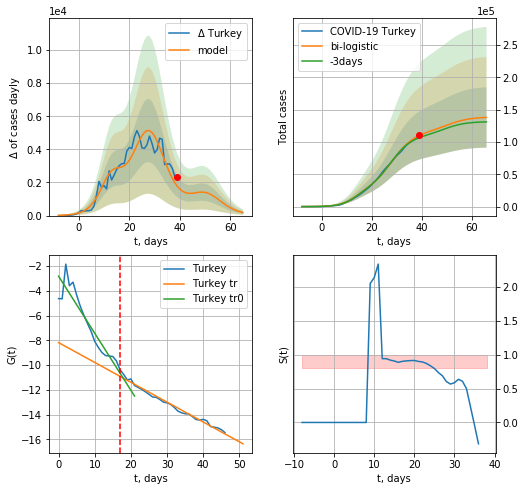

Turkey data at: 2020-04-26
+3 day model MAPE: 0.03391492224534678
model: bi-logistic
coeffs:  [9.14797041e+04 2.20832166e-01 2.81062892e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.338333891223108
forecast at the end of period: +27 days
	 deltaDaycases:  180
	 total cases:  137858 ± 46642
	 total death:  3511 ± 3563
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.983441
 intercept: -8.181832
 slope: -0.160462


In [183]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,5*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


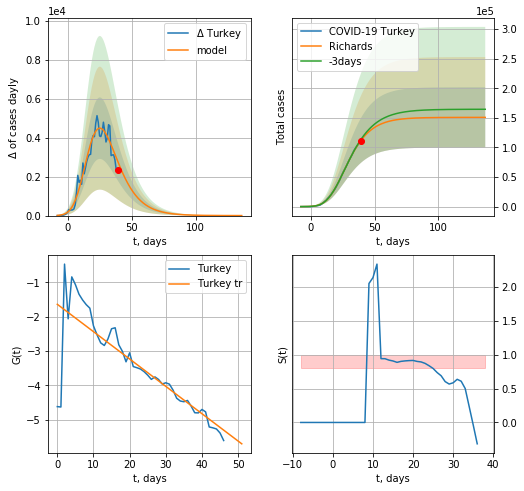

Turkey data at: 2020-04-26
+3 day model MAPE: 0.017040424190569416
model: Richards
coeffs:  [1.50859482e+05 5.74895167e-01 4.03929885e+00 1.51531605e-01]
rational stdev:  0.33807353309731725
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  150850 ± 50998
	 total death:  3842 ± 3896
trend coefficient of determination: 0.692881
 intercept: -1.640619
 slope: -0.079569


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


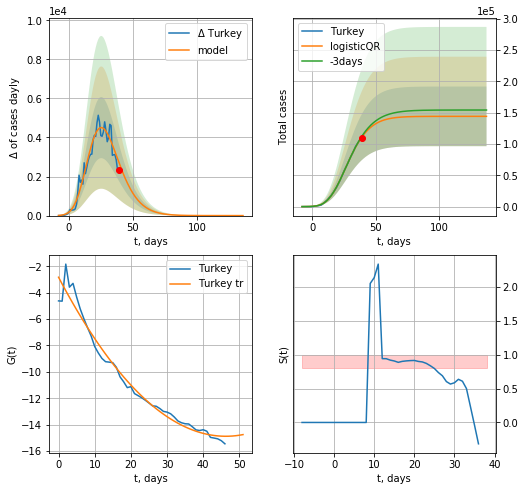

Turkey data at: 2020-04-26
+3 day model MAPE: 0.01353419620797823
model: logisticQR
coeffs:  [ 1.43993079e+05  2.77754436e-02 -7.28709680e+01 -7.34751331e+01
  1.57185841e-02]
rational stdev:  0.33031117138275146
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  143993 ± 47562
	 total death:  3667 ± 3633
trend coefficient of determination: 0.973708
 intercept_: -2.832374302934597
 coeffs_: [ 0.         -0.52111203  0.00563403]


In [184]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


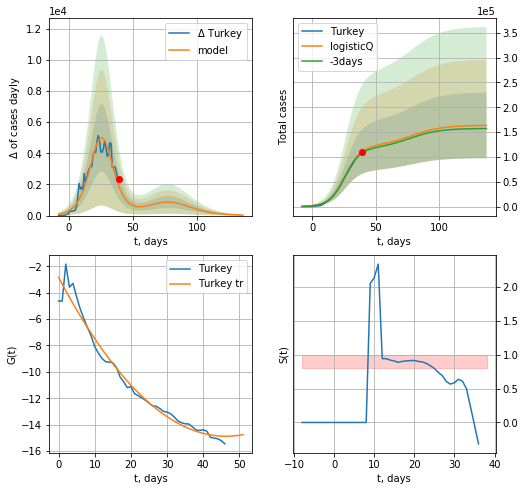

Turkey data at: 2020-04-26
+3 day model MAPE: 0.025017632498818314
model: logisticQ
coeffs:  [ 1.21357062e+05  4.27392416e-06  2.59900542e+01 -3.82116457e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.40423115544115895
forecast at the end of period: +98 days
	 deltaDaycases:  28
	 total cases:  163497 ± 66090
	 total death:  4164 ± 5049
trend coefficient of determination: 0.973708
 intercept_: -2.832374302934597
 coeffs_: [ 0.         -0.52111203  0.00563403]


In [185]:
x = forecastRRR('Turkey',dfTR[:],d1,14*7,1.,addpred=True,xcoef=[0.35,.5,3,1])

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [186]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.014778325123152709

In [187]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

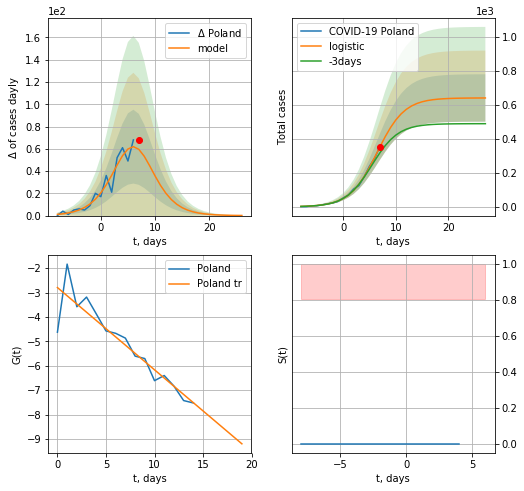

Poland data at: 2020-04-26
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  640 ± 139
	 total death:  29 ± 18
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


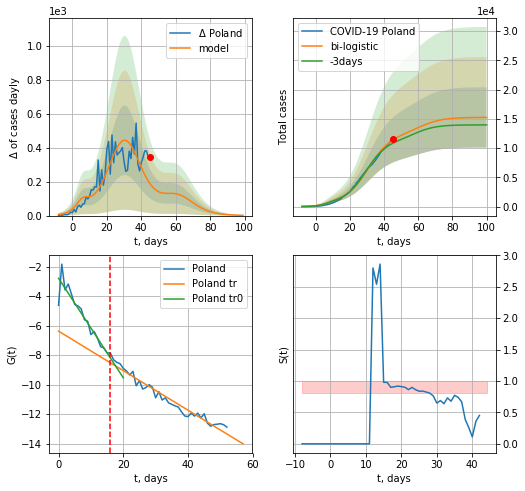

Poland data at: 2020-04-26
+3 day model MAPE: 0.051844894427519495
model: bi-logistic
coeffs:  [1.16900272e+04 1.50596997e-01 3.07189276e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.338314347156494
forecast at the end of period: +55 days
	 deltaDaycases:  1
	 total cases:  15244 ± 5157
	 total death:  702 ± 712
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.953522
 intercept: -6.376774
 slope: -0.133978


In [188]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


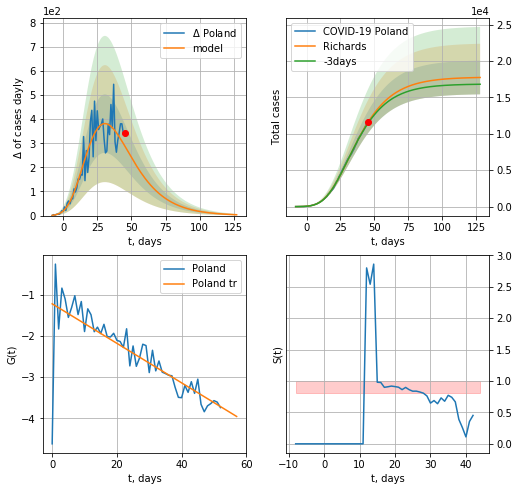

Poland data at: 2020-04-26
+3 day model MAPE: 0.013639413533723329
model: Richards
coeffs:  [ 1.77928174e+04  2.52831004e+00 -3.25860671e+01  2.33433635e-02]
rational stdev:  0.13058523929180546
forecast at the end of period: +83 days
	 deltaDaycases:  3
	 total cases:  17734 ± 2315
	 total death:  816 ± 319
trend coefficient of determination: 0.641630
 intercept: -1.224659
 slope: -0.047860


In [189]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


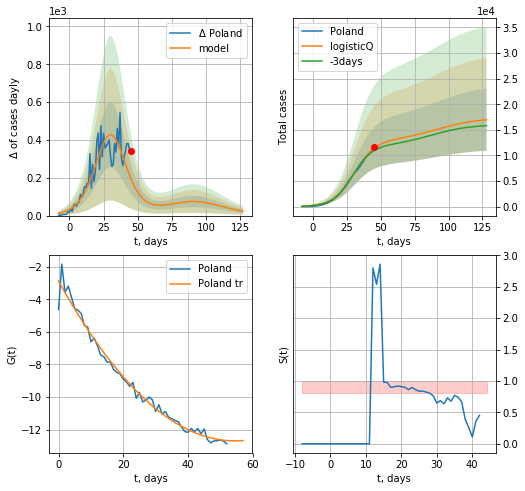

Poland data at: 2020-04-26
+3 day model MAPE: 0.04533282624802175
model: logisticQ
coeffs:  [ 1.28436868e+04  2.77973089e-06  3.05052561e+01 -4.73458332e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3563645076280276
forecast at the end of period: +83 days
	 deltaDaycases:  23
	 total cases:  16967 ± 6046
	 total death:  781 ± 834
trend coefficient of determination: 0.982571
 intercept_: -2.8705778315758232
 coeffs_: [ 0.         -0.36086582  0.0033122 ]


In [190]:
x =  forecastRRR('Poland',dfPL[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

IS
          date    cases  active  death
60 2020-04-22  14498.0    9094  189.0
61 2020-04-23  14803.0    9000  192.0
62 2020-04-24  15058.0    8861  194.0
63 2020-04-25  15298.0    8664  199.0
64 2020-04-26  15443.0    8511  201.0


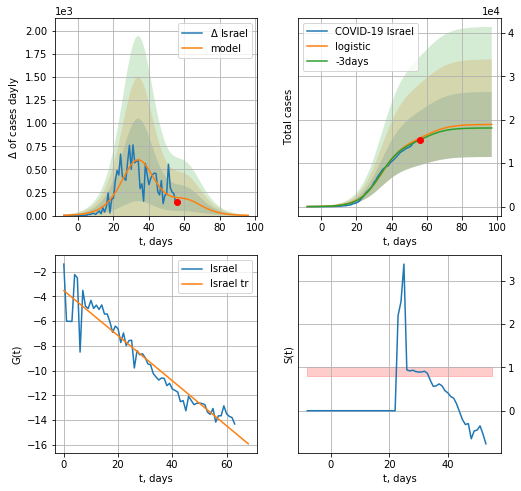

Israel data at: 2020-04-26
+3 day model MAPE: 0.02728791837819538
model: logistic
coeffs:  [1.51470733e+04 1.57474761e-01 3.42578004e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.39592346745416046
forecast at the end of period: +41 days
	 deltaDaycases:  2
	 total cases:  18918 ± 7490
	 total death:  246 ± 292
trend coefficient of determination: 0.912910
 intercept: -3.529401
 slope: -0.182165


In [191]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


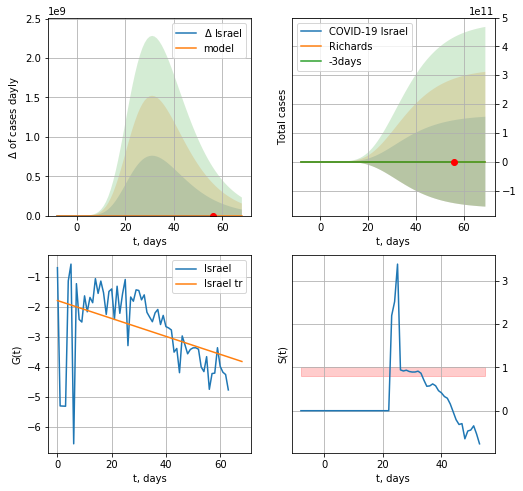

Israel data at: 2020-04-26
+3 day model MAPE: 0.01891379029224867
model: Richards
coeffs:  [ 1.69727547e+04  7.81096786e+00 -1.92575686e+01  1.12997491e-02]
rational stdev:  9525004.783062622
forecast at the end of period: +13 days
	 deltaDaycases:  55
	 total cases:  16362 ± 155851659191
	 total death:  212 ± 6057903042
trend coefficient of determination: 0.179483
 intercept: -1.796382
 slope: -0.029890


In [192]:
x = forecastRR('Israel',dfIS[:],d1,6*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


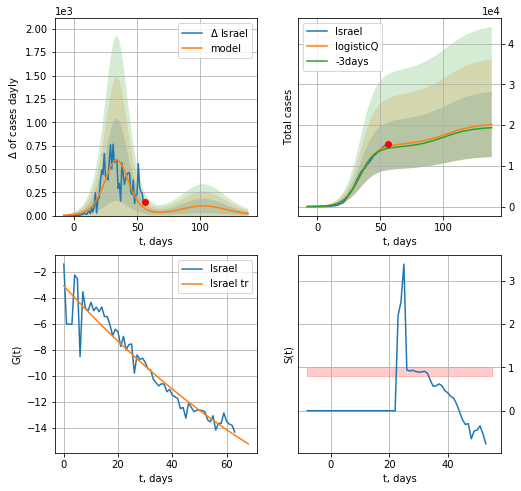

Israel data at: 2020-04-26
+3 day model MAPE: 0.03718553741991791
model: logisticQ
coeffs:  [ 1.51461207e+04  1.52987198e-06  3.42572730e+01 -1.02886211e+05]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3960547424857343
forecast at the end of period: +83 days
	 deltaDaycases:  22
	 total cases:  20158 ± 7983
	 total death:  262 ± 311
trend coefficient of determination: 0.916645
 intercept_: -3.0720112409440787
 coeffs_: [ 0.         -0.22644984  0.0007031 ]


In [193]:
x = forecastRRR('Israel',dfIS[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


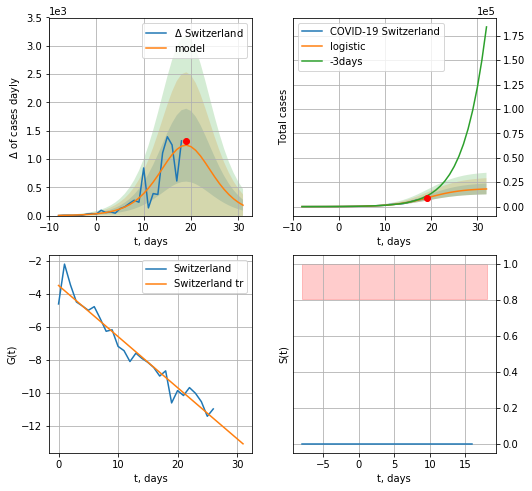

Switzerland data at: 2020-04-26
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +13 days
	 deltaDaycases:  183
	 total cases:  18076 ± 5532
	 total death:  1001 ± 919
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


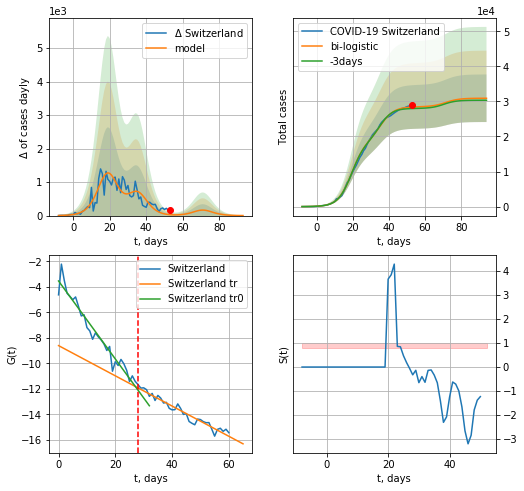

Switzerland data at: 2020-04-26
+3 day model MAPE: 0.015389950918639842
model: bi-logistic
coeffs:  [9.76723676e+03 2.69855526e-01 3.57108800e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.21947473572510207
forecast at the end of period: +41 days
	 deltaDaycases:  1
	 total cases:  30909 ± 6783
	 total death:  1712 ± 1127
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.944347
 intercept: -8.605211
 slope: -0.118490


In [194]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


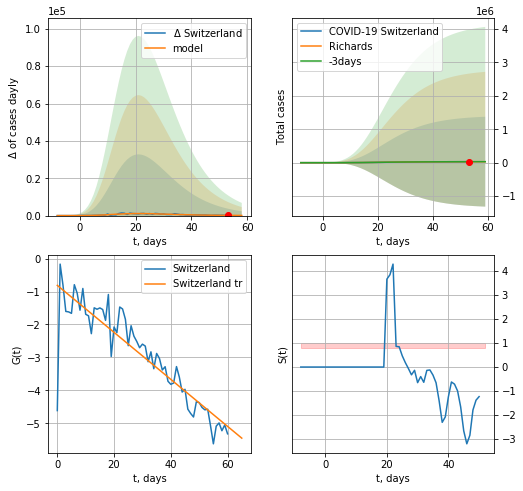

Switzerland data at: 2020-04-26
+3 day model MAPE: 0.0013110246341507985
model: Richards
coeffs:  [ 3.02809241e+04  6.22811873e+00 -2.06942177e+01  1.57784120e-02]
rational stdev:  45.52600178410486
forecast at the end of period: +6 days
	 deltaDaycases:  76
	 total cases:  29528 ± 1344321
	 total death:  1635 ± 223305
trend coefficient of determination: 0.793643
 intercept: -0.812759
 slope: -0.071378


In [195]:
x = forecastRR('Switzerland',dfSZ[:],d1,7*5-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


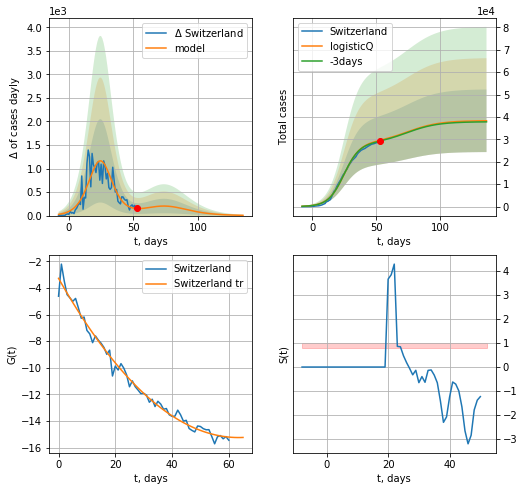

Switzerland data at: 2020-04-26
+3 day model MAPE: 0.01097069333400644
model: logisticQ
coeffs:  [ 2.84229858e+04  1.58377564e-06  2.48298065e+01 -1.02241676e+05]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.364551607545872
forecast at the end of period: +83 days
	 deltaDaycases:  5
	 total cases:  38303 ± 13963
	 total death:  2122 ± 2320
trend coefficient of determination: 0.986628
 intercept_: -3.282590714500456
 coeffs_: [ 0.         -0.3768793   0.00297101]


In [196]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*16-dT,addpred=True,xcoef=[0.35,.5,3,1])

In [197]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date   cases  active  death
43 2020-04-22  6592.0    5994  174.0
44 2020-04-23  7170.0    6479  187.0
45 2020-04-24  7647.0    6853  193.0
46 2020-04-25  8125.0    7142  201.0
47 2020-04-26  8617.0    7568  209.0


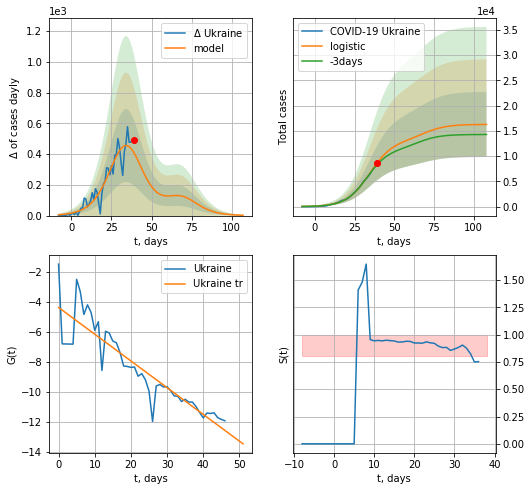

Ukraine data at: 2020-04-26
+3 day model MAPE: 0.04686118234456264
model: logistic
coeffs:  [1.30219543e+04 1.39063839e-01 3.44743887e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.39584562112567473
forecast at the end of period: +69 days
	 deltaDaycases:  2
	 total cases:  16262 ± 6437
	 total death:  394 ± 467
trend coefficient of determination: 0.815262
 intercept: -4.387093
 slope: -0.177877


In [198]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:130: RuntimeWarning: invalid value encountered in true_divide


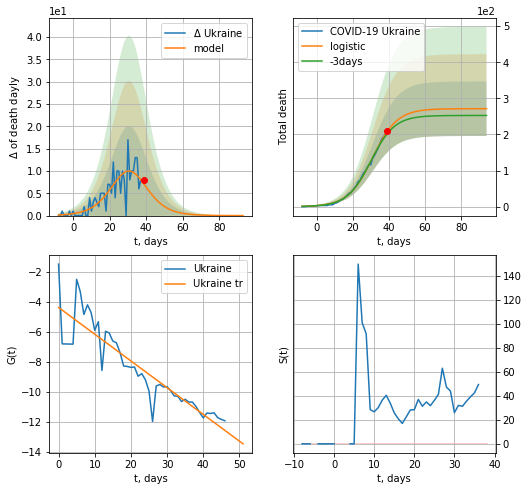

Ukraine data at: 2020-04-26
+3 day model MAPE: 0.03313072238809364
model: logistic
coeffs:  [2.71286579e+02 1.47366706e-01 3.10459076e+01]
rational stdev:  0.27856639053553756
forecast at the end of period: +55 days
	 total death:  271 ± 75
trend coefficient of determination: 0.815262
 intercept: -4.387093
 slope: -0.177877


In [199]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

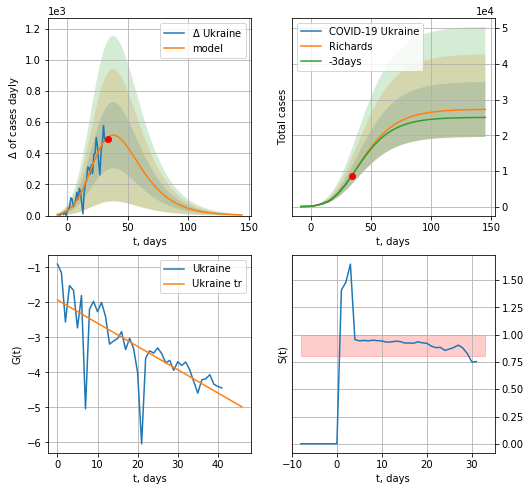

Ukraine data at: 2020-04-26
+3 day model MAPE: 0.005061420566236939
model: Richards
coeffs:  [2.73090169e+04 3.20171072e-01 7.06719460e+00 1.74260980e-01]
rational stdev:  0.2829021907237145
forecast at the end of period: +111 days
	 deltaDaycases:  4
	 total cases:  27237 ± 7705
	 total death:  660 ± 560
trend coefficient of determination: 0.571438
 intercept: -1.932216
 slope: -0.066320


In [201]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


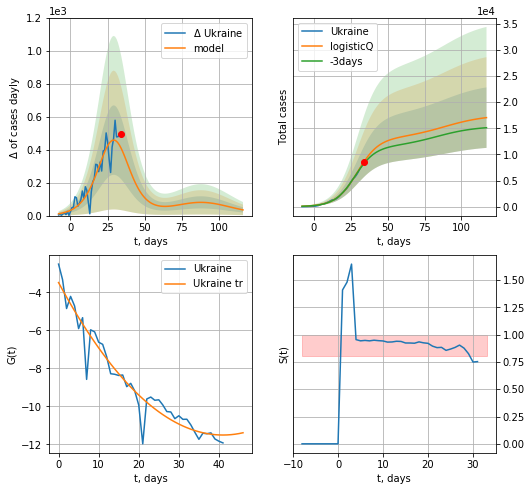

Ukraine data at: 2020-04-26
+3 day model MAPE: 0.04699464414675931
model: logisticQ
coeffs:  [ 1.30268920e+04  1.21651383e-05  2.94815828e+01 -1.14030937e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3398098113193709
forecast at the end of period: +83 days
	 deltaDaycases:  34
	 total cases:  17043 ± 5791
	 total death:  413 ± 421
trend coefficient of determination: 0.931774
 intercept_: -3.4866938658745266
 coeffs_: [ 0.         -0.39134006  0.00477252]


In [202]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*16-dT,addpred=True,xcoef=[0.35,.5,3,1])

In [203]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

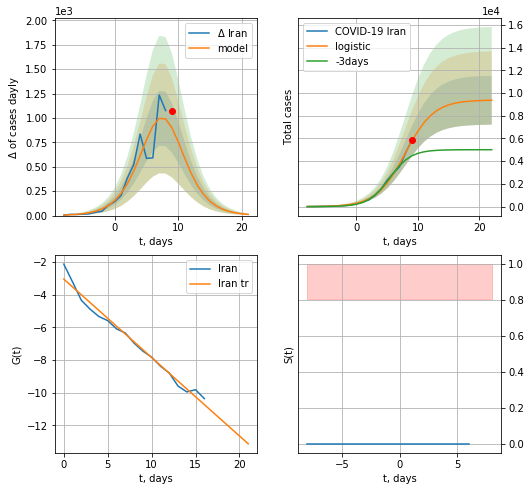

Iran data at: 2020-04-26
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +13 days
	 deltaDaycases:  11
	 total cases:  9363 ± 2151
	 total death:  590 ± 406
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


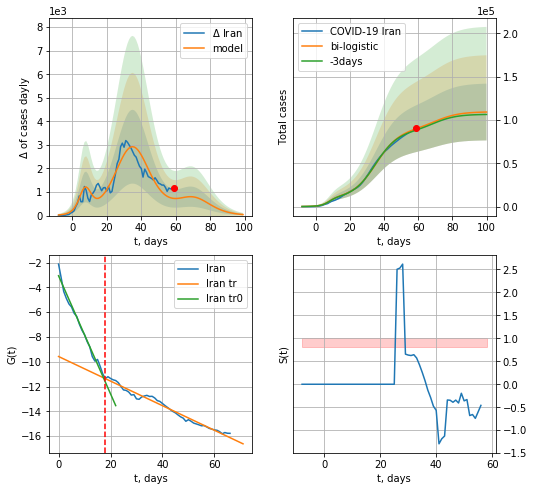

Iran data at: 2020-04-26
+3 day model MAPE: 0.018347610743053473
model: bi-logistic
coeffs:  [8.00623334e+04 1.45379867e-01 3.53197393e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30007821371330534
forecast at the end of period: +41 days
	 deltaDaycases:  43
	 total cases:  109180 ± 32762
	 total death:  6890 ± 6202
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.979338
 intercept: -9.574933
 slope: -0.099236


In [204]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


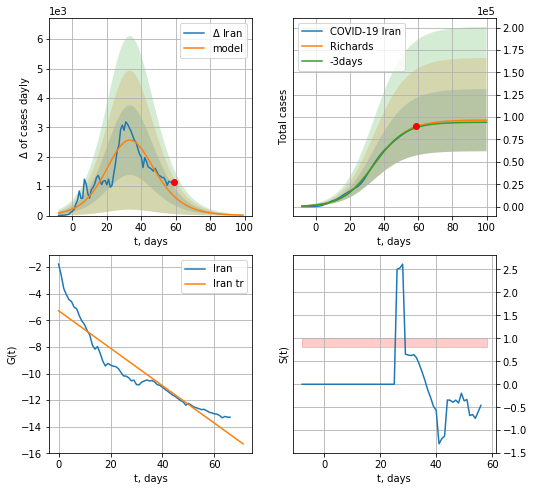

Iran data at: 2020-04-26
+3 day model MAPE: 0.012315048715334308
model: Richards
coeffs:  [9.67507580e+04 1.26522330e-01 3.13394960e+01 7.82130254e-01]
rational stdev:  0.35934894851066496
forecast at the end of period: +41 days
	 deltaDaycases:  14
	 total cases:  96612 ± 34717
	 total death:  6096 ± 6571
trend coefficient of determination: 0.875075
 intercept: -5.277968
 slope: -0.140983


In [205]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


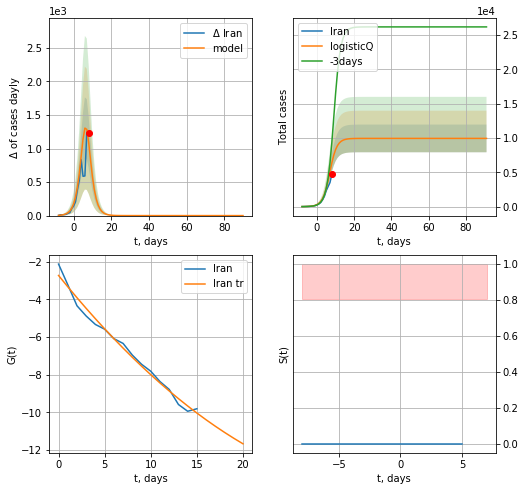

Iran data at: 2020-04-26
+3 day model MAPE: 0.4197621815403343
model: logisticQ
coeffs:  [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.20300711074298855
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  9947 ± 2019
	 total death:  627 ± 381
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:236: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


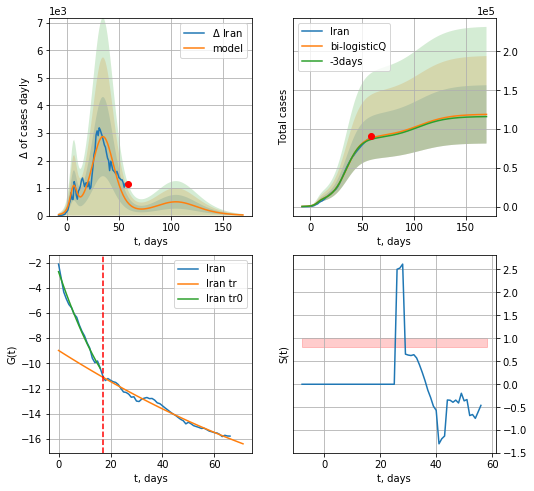

Iran data at: 2020-04-26
+3 day model MAPE: 0.019425801964123496
model: bi-logisticQ
coeffs:  [ 8.28412444e+04  1.92238749e-06  3.50386990e+01 -7.16813332e+04] [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.31624906032161715
forecast at the end of period: +111 days
	 deltaDaycases:  22
	 total cases:  118879 ± 37595
	 total death:  7502 ± 7117
bi-logistic approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.982425
 intercept_: -8.974182681133568
 coeffs_: [ 0.         -0.13098482  0.00037435]


In [207]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date    cases  active  death
53 2020-04-22  57999.0   53066  513.0
54 2020-04-23  62773.0   57327  555.0
55 2020-04-24  68622.0   62439  615.0
56 2020-04-25  74588.0   67657  681.0
57 2020-04-26  80949.0   73435  747.0


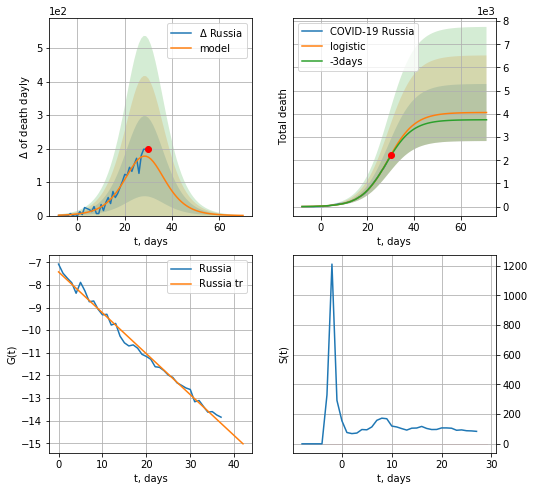

Russia data at: 2020-04-26
+3 day model MAPE: 0.02147473034620079
model: logistic
coeffs:  [4.06041544e+03 1.75093975e-01 2.89142734e+01]
rational stdev:  0.30302911311460123
forecast at the end of period: +41 days
	 total death:  4057 ± 1229
trend coefficient of determination: 0.991156
 intercept: -7.422298
 slope: -0.180956


In [208]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

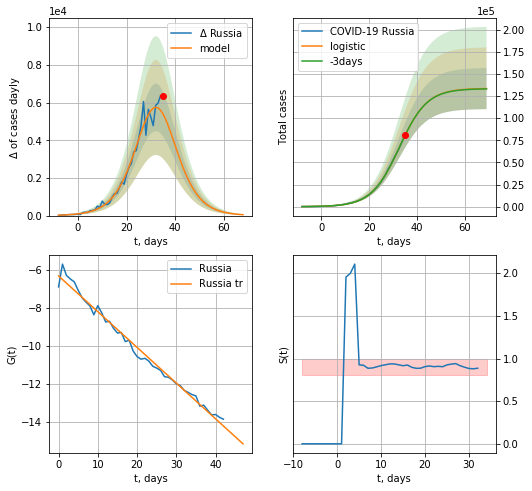

Russia data at: 2020-04-26
+3 day model MAPE: 0.0008074017789648009
model: logistic
coeffs:  [1.33632816e+05 1.72217613e-01 3.25913862e+01]
rational stdev:  0.17407618738735745
forecast at the end of period: +34 days
	 deltaDaycases:  47
	 total cases:  133380 ± 23218
	 total death:  1230 ± 642
trend coefficient of determination: 0.986896
 intercept: -6.323761
 slope: -0.187548


In [209]:
x = forecast('Russia',dfRS[14:],d1,9*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


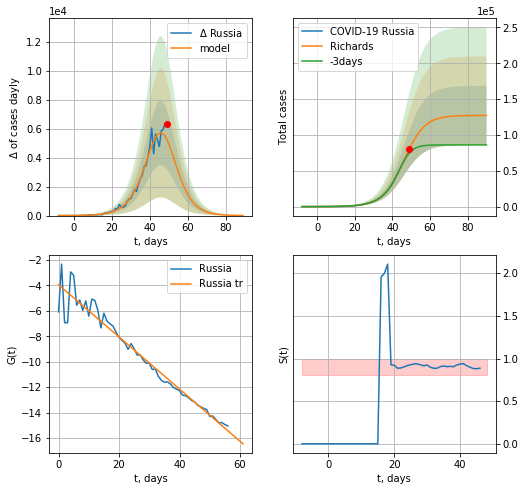

Russia data at: 2020-04-26
+3 day model MAPE: 0.10487947074258018
model: Richards
coeffs:  [1.27256090e+05 1.68116633e-01 4.67862111e+01 1.10594101e+00]
rational stdev:  0.32384240969720024
forecast at the end of period: +41 days
	 deltaDaycases:  7
	 total cases:  127218 ± 41198
	 total death:  1173 ± 1139
trend coefficient of determination: 0.950003
 intercept: -3.947775
 slope: -0.204935


In [210]:
x = forecastRR('Russia',dfRS[:],d1,10*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

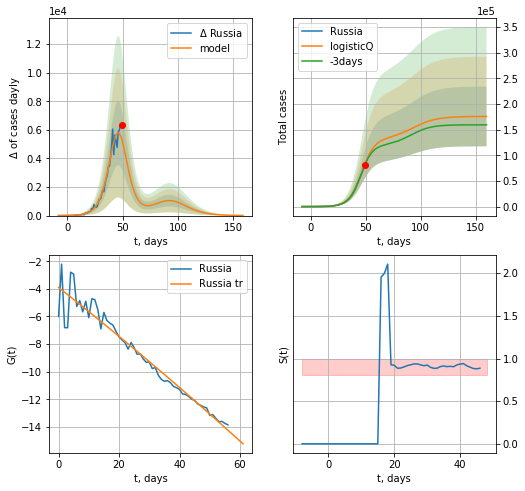

Russia data at: 2020-04-26
+3 day model MAPE: 0.020606445861991618
model: logisticQ
coeffs:  [ 1.30120330e+05  1.57370464e-04  4.62788812e+01 -1.07396673e+03]
scenario coeffs:  [0.35, 0.5, 2.0, 1]
rational stdev:  0.33123098476797763
forecast at the end of period: +111 days
	 deltaDaycases:  7
	 total cases:  175597 ± 58163
	 total death:  1620 ± 1609
trend coefficient of determination: 0.938635
 intercept_: -3.899189605787403
 coeffs_: [ 0.         -0.17267044 -0.00021282]


In [211]:
x = forecastRRR('Russia',dfRS[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,2.,1])

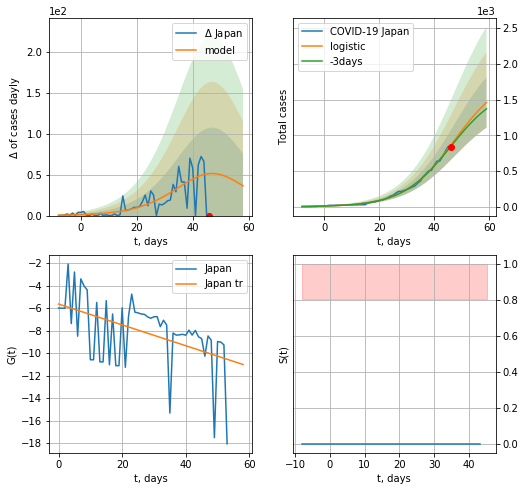

Japan data at: 2020-04-26
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +13 days
	 deltaDaycases:  36
	 total cases:  1458 ± 352
	 total death:  40 ± 29
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


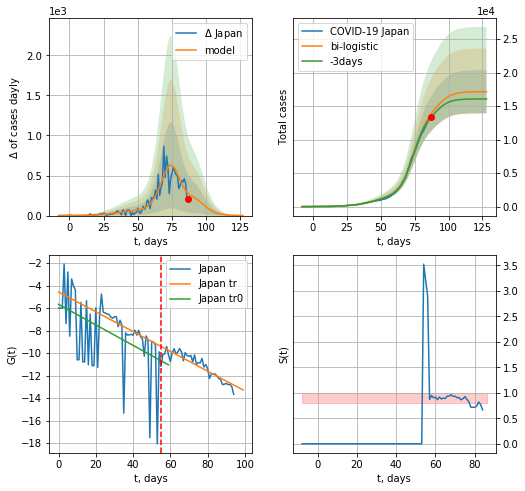

Japan data at: 2020-04-26
+3 day model MAPE: 0.04015530258183253
model: bi-logistic
coeffs:  [1.22261476e+04 1.98091801e-01 7.45527735e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18799418834920895
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  17145 ± 3223
	 total death:  474 ± 267
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.796210
 intercept: -4.571944
 slope: -0.087966


In [213]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

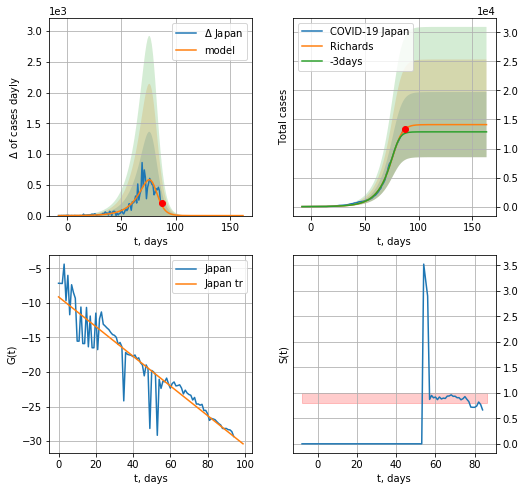

Japan data at: 2020-04-26
+3 day model MAPE: 0.060665985004948866
model: Richards
coeffs:  [1.41140591e+04 9.29449363e-02 8.00703146e+01 2.64888614e+00]
rational stdev:  0.3971950559401989
forecast at the end of period: +76 days
	 deltaDaycases:  0
	 total cases:  14114 ± 5606
	 total death:  390 ± 464
trend coefficient of determination: 0.881270
 intercept: -9.123501
 slope: -0.214934


In [214]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

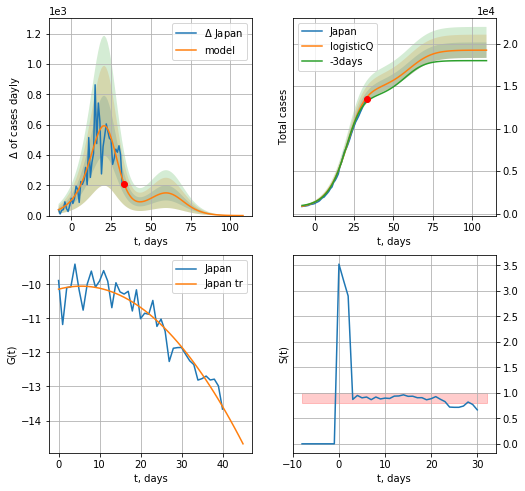

Japan data at: 2020-04-26
+3 day model MAPE: 0.04315376708967864
model: logisticQ
coeffs:  [ 1.42551868e+04  1.94915833e-03  1.93034379e+01 -6.29592392e+01]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.047444884793157116
forecast at the end of period: +76 days
	 deltaDaycases:  0
	 total cases:  19243 ± 913
	 total death:  532 ± 75
trend coefficient of determination: 0.902331
 intercept_: -10.146315696191685
 coeffs_: [ 0.          0.03258188 -0.00296421]


In [215]:
x = forecastRRR('Japan',dfJP[54:],d1,15*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


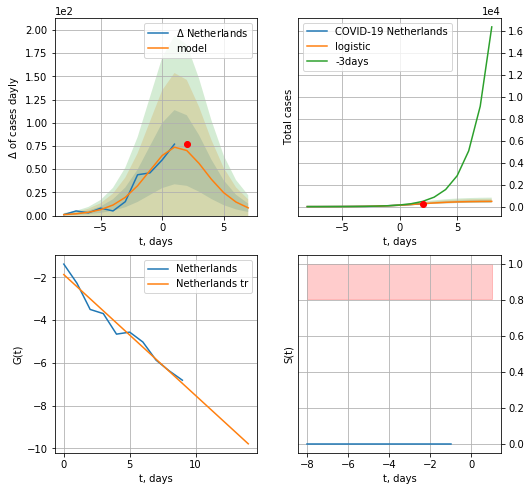

Netherlands data at: 2020-04-26
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  477 ± 113
	 total death:  56 ± 39
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


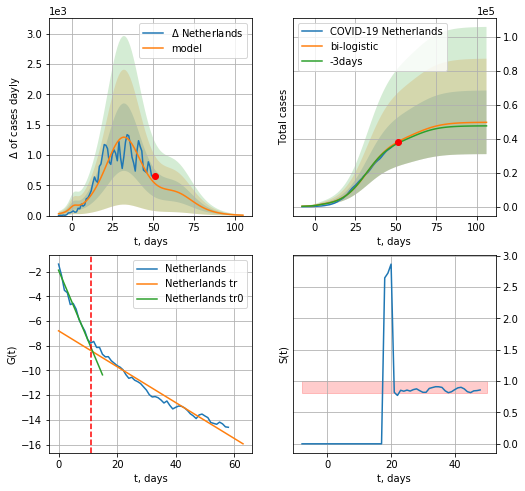

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.024128068707429277
model: bi-logistic
coeffs:  [3.94453094e+04 1.29370132e-01 3.23445414e+01] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37738270367565085
forecast at the end of period: +55 days
	 deltaDaycases:  6
	 total cases:  49744 ± 18772
	 total death:  5882 ± 6659
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.960372
 intercept: -6.785874
 slope: -0.145243


In [217]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
55 2020-04-22  34842   30538  4054.0
56 2020-04-23  35729   31302  4177.0
57 2020-04-24  36535   31996  4289.0
58 2020-04-25  37190   32531  4409.0
59 2020-04-26  37845   33120  4475.0


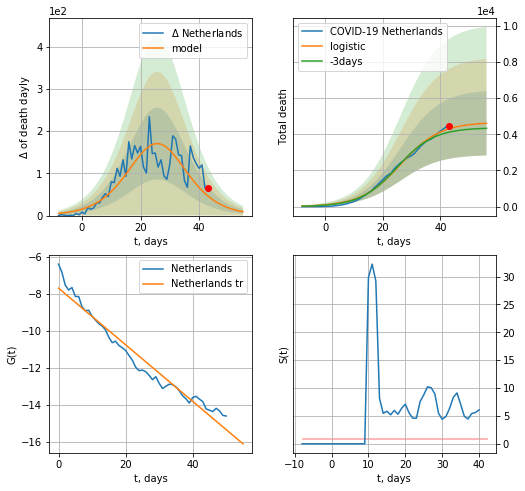

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.04737546482673416
model: logistic
coeffs:  [4.66757500e+03 1.46285722e-01 2.61684140e+01]
rational stdev:  0.38541001729319585
forecast at the end of period: +13 days
	 total death:  4608 ± 1776
trend coefficient of determination: 0.956739
 intercept: -7.682240
 slope: -0.153068


In [218]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


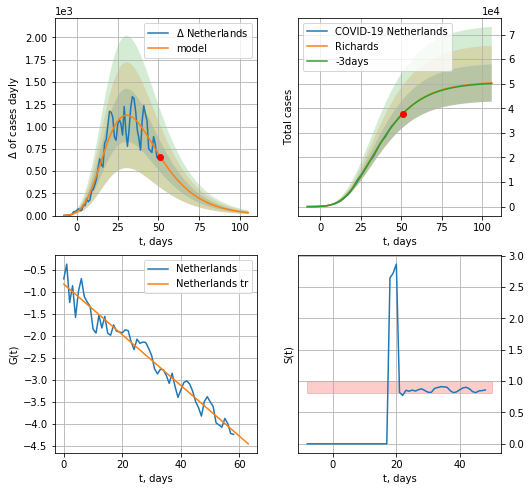

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.002086670651658265
model: Richards
coeffs:  [ 5.08516925e+04  3.44077745e+00 -3.53721494e+01  1.76675594e-02]
rational stdev:  0.15085908967326542
forecast at the end of period: +55 days
	 deltaDaycases:  33
	 total cases:  50321 ± 7591
	 total death:  5950 ± 2692
trend coefficient of determination: 0.956311
 intercept: -0.826124
 slope: -0.057661


In [219]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


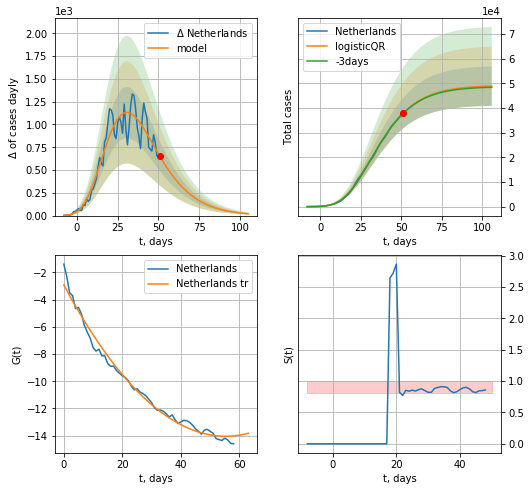

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.0035906936125688097
model: logisticQR
coeffs:  [ 4.91822705e+04  1.88635492e-02 -6.91069320e+01 -5.61655700e+02
  4.80440258e-03]
rational stdev:  0.16368283710474646
forecast at the end of period: +55 days
	 deltaDaycases:  20
	 total cases:  48926 ± 8008
	 total death:  5785 ± 2840
trend coefficient of determination: 0.985636
 intercept_: -2.9204978481930475
 coeffs_: [ 0.         -0.40248737  0.00364159]


In [220]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


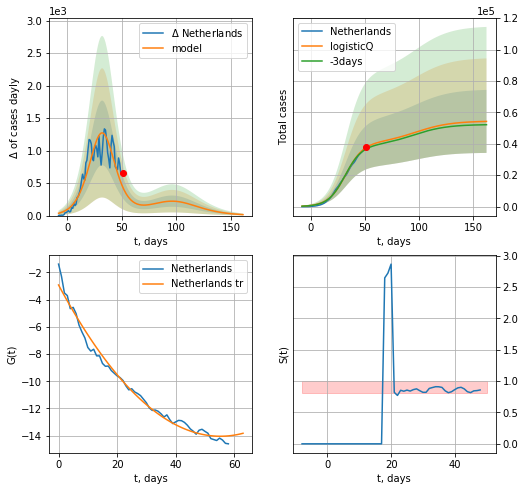

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.026154457230230552
model: logisticQ
coeffs:  [ 4.03524172e+04  1.93118658e-06  3.23015730e+01 -6.45836566e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.3697198328114882
forecast at the end of period: +111 days
	 deltaDaycases:  15
	 total cases:  54238 ± 20053
	 total death:  6413 ± 7113
trend coefficient of determination: 0.985636
 intercept_: -2.9204978481930475
 coeffs_: [ 0.         -0.40248737  0.00364159]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:179: RuntimeWarning: invalid value encountered in true_divide


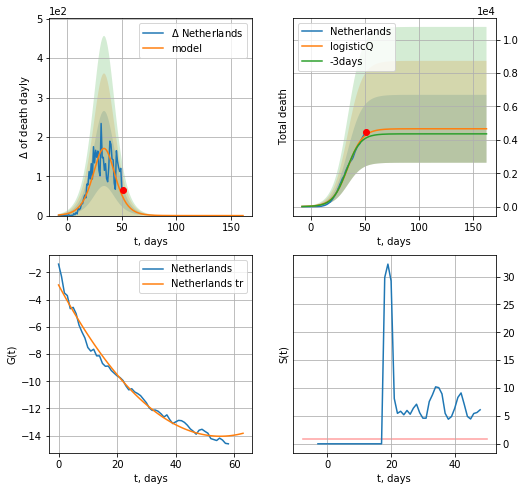

Netherlands data at: 2020-04-26
+3 day model MAPE: 0.04743137153919452
model: logisticQ
coeffs:  [ 4.66436953e+03  2.00565488e-06  3.41568096e+01 -7.29860704e+04]
rational stdev:  0.43627955880532326
forecast at the end of period: +111 days
	 total death:  4664 ± 2034
trend coefficient of determination: 0.985636
 intercept_: -2.9204978481930475
 coeffs_: [ 0.         -0.40248737  0.00364159]


In [402]:
x = forecastRRR('Netherlands',dfNL[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])
x = forecastRRR('Netherlands',dfNL[:],d1,20*7-dT,addpred=False,xcoef=[0.35,.5,3.,1],cases='death')

In [223]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

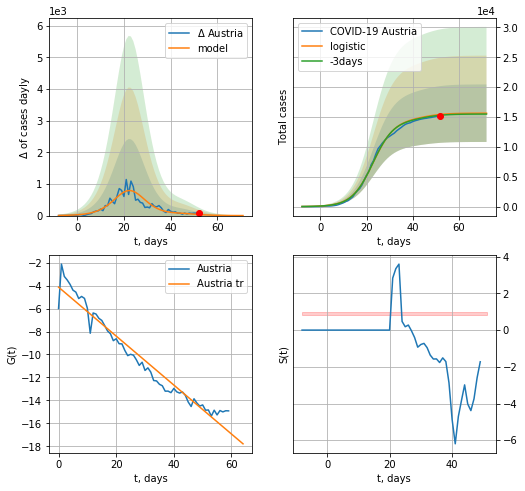

Austria data at: 2020-04-26
+3 day model MAPE: 0.00851366262017673
model: logistic
coeffs:  [1.47185100e+04 2.15194798e-01 2.28446519e+01]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.30789321412045845
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  15634 ± 4813
	 total death:  556 ± 513
trend coefficient of determination: 0.950679
 intercept: -4.130002
 slope: -0.213426


In [224]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


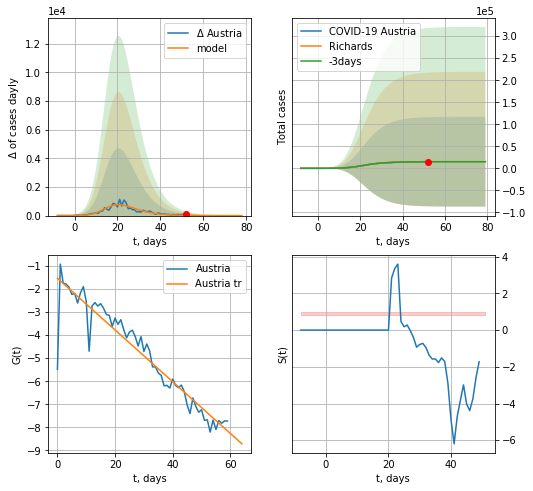

Austria data at: 2020-04-26
+3 day model MAPE: 0.00706974029423197
model: Richards
coeffs:  [1.50832195e+04 6.11864828e-01 1.21197906e+01 2.53332035e-01]
rational stdev:  6.762682645273671
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  15081 ± 101990
	 total death:  536 ± 10874
trend coefficient of determination: 0.891704
 intercept: -1.534430
 slope: -0.112182


In [225]:
x = forecastRR('Austria',dfAT[:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


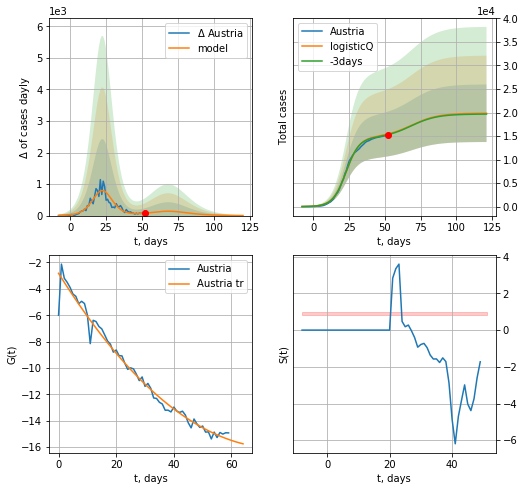

Austria data at: 2020-04-26
+3 day model MAPE: 0.008928223407342641
model: logisticQ
coeffs:  [ 1.47183249e+04  2.11885020e-06  2.28448534e+01 -1.01512860e+05]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.3081559583557623
forecast at the end of period: +69 days
	 deltaDaycases:  2
	 total cases:  19851 ± 6117
	 total death:  706 ± 652
trend coefficient of determination: 0.977150
 intercept_: -2.8214503156255084
 coeffs_: [ 0.         -0.34883303  0.00229537]


In [226]:
x = forecastRRR('Austria',dfAT[:],d1,14*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

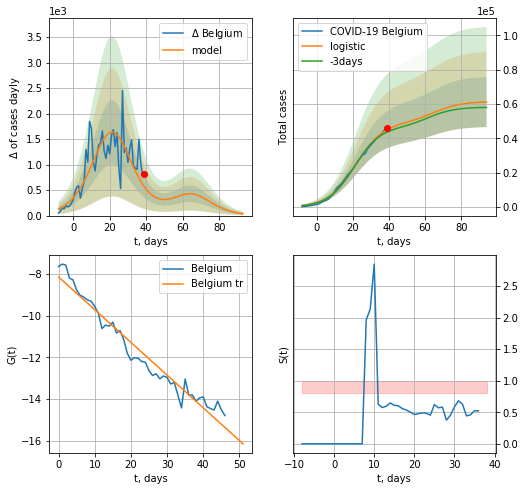

Belgium data at: 2020-04-26
+3 day model MAPE: 0.03361752556436887
model: logistic
coeffs:  [4.91639133e+04 1.32857160e-01 2.17198603e+01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.23848676042662378
forecast at the end of period: +55 days
	 deltaDaycases:  36
	 total cases:  61190 ± 14593
	 total death:  9409 ± 6731
trend coefficient of determination: 0.955467
 intercept: -8.149419
 slope: -0.156568


In [227]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
52 2020-04-22  41889   26194  6262.0
53 2020-04-23  42797   26507  6490.0
54 2020-04-24  44293   27492  6679.0
55 2020-04-25  45325   27991  6917.0
56 2020-04-26  46134   28255  7094.0


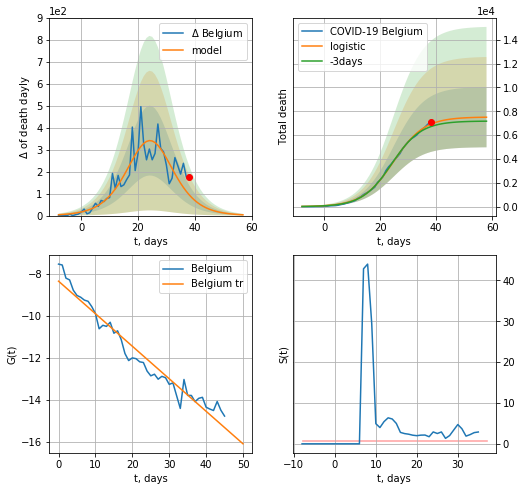

Belgium data at: 2020-04-26
+3 day model MAPE: 0.03199571963716267
model: logistic
coeffs:  [7.52124543e+03 1.81759060e-01 2.46869341e+01]
rational stdev:  0.33652893070459083
forecast at the end of period: +20 days
	 total death:  7503 ± 2525
trend coefficient of determination: 0.953062
 intercept: -8.349533
 slope: -0.155117


In [228]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


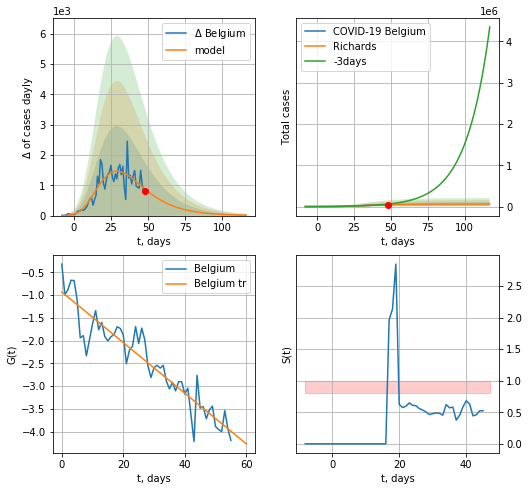

Belgium data at: 2020-04-26
+3 day model MAPE: 0.26964751056013453
model: Richards
coeffs:  [ 6.19206825e+04  4.60841801e+00 -3.61957400e+01  1.40831083e-02]
rational stdev:  0.7780509767399889
forecast at the end of period: +69 days
	 deltaDaycases:  14
	 total cases:  61709 ± 48013
	 total death:  9489 ± 22148
trend coefficient of determination: 0.877830
 intercept: -0.930000
 slope: -0.055671


In [229]:
x = forecastRR('Belgium',dfBG[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


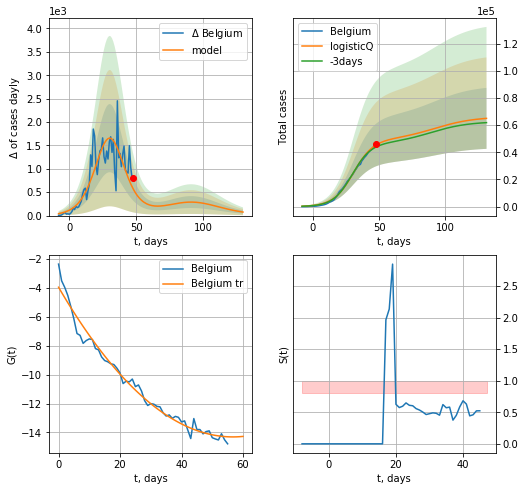

Belgium data at: 2020-04-26
+3 day model MAPE: 0.03559300858627152
model: logisticQ
coeffs:  [ 4.90003013e+04  2.14632589e-06  3.06574647e+01 -6.22863364e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.345474960930839
forecast at the end of period: +83 days
	 deltaDaycases:  75
	 total cases:  64980 ± 22449
	 total death:  9991 ± 10354
trend coefficient of determination: 0.978840
 intercept_: -3.9638975300852515
 coeffs_: [ 0.         -0.3646954   0.00321494]


In [230]:
x = forecastRRR('Belgium',dfBG[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

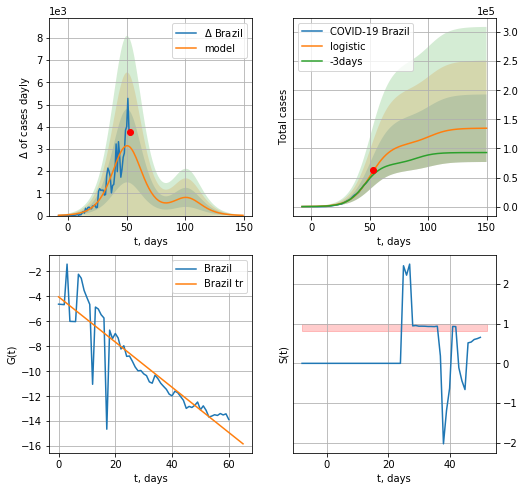

Brazil data at: 2020-04-26
+3 day model MAPE: 0.1267293596936311
model: logistic
coeffs:  [1.07861440e+05 1.16475896e-01 5.07987101e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.43082069468042244
forecast at the end of period: +97 days
	 deltaDaycases:  11
	 total cases:  134730 ± 58044
	 total death:  9151 ± 11827
trend coefficient of determination: 0.810772
 intercept: -4.036100
 slope: -0.181152


In [231]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


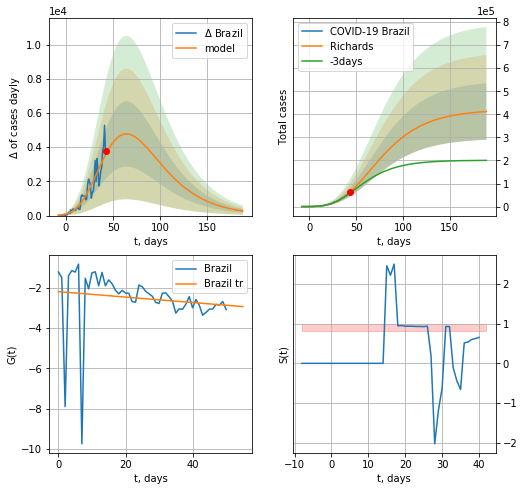

Brazil data at: 2020-04-26
+3 day model MAPE: 0.07102332123499155
model: Richards
coeffs:  [ 4.20673159e+05  1.25713762e+00 -5.35065449e+01  2.48604802e-02]
rational stdev:  0.29659000734296115
forecast at the end of period: +146 days
	 deltaDaycases:  268
	 total cases:  412116 ± 122229
	 total death:  27992 ± 24906
trend coefficient of determination: 0.019101
 intercept: -2.202458
 slope: -0.013489


In [232]:
x = forecastRR('Brazil',dfBZ[10:],d1,25*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


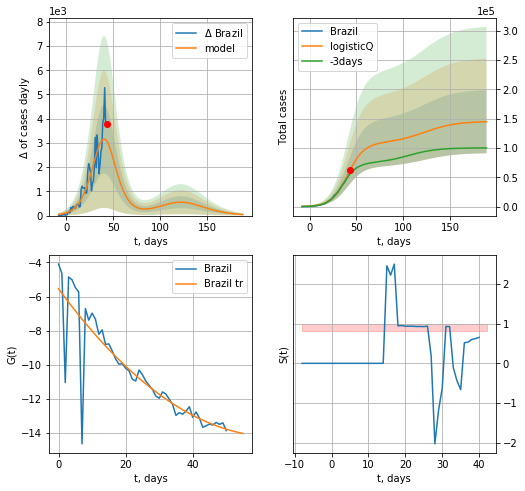

Brazil data at: 2020-04-26
+3 day model MAPE: 0.1263678975286164
model: logisticQ
coeffs:  [ 1.07964962e+05  5.75648329e-06  4.08144093e+01 -2.01922138e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37203530043508215
forecast at the end of period: +146 days
	 deltaDaycases:  44
	 total cases:  145006 ± 53947
	 total death:  9849 ± 10992
trend coefficient of determination: 0.762695
 intercept_: -5.545827552767468
 coeffs_: [ 0.         -0.26848486  0.00207637]


In [233]:
x = forecastRRR('Brazil',dfBZ[10:],d1,25*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

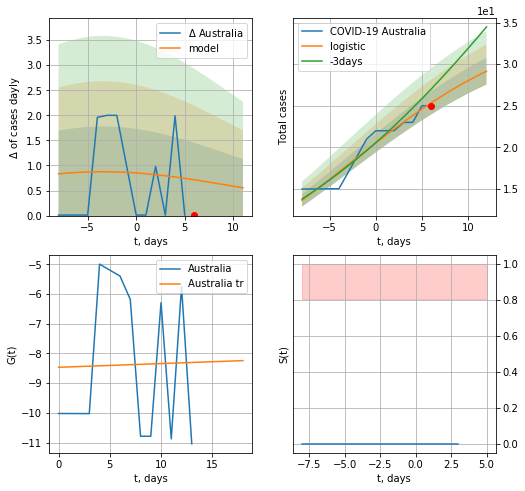

Australia data at: 2020-04-26
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


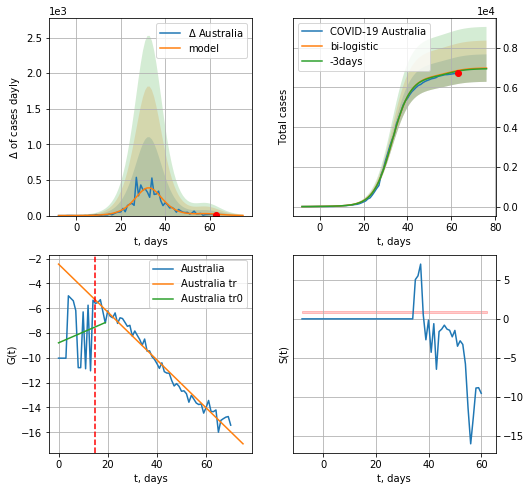

Australia data at: 2020-04-26
+3 day model MAPE: 0.004702004730071421
model: bi-logistic
coeffs:  [6.53779295e+03 2.38905061e-01 3.30151521e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.0989734731072757
forecast at the end of period: +13 days
	 deltaDaycases:  2
	 total cases:  6974 ± 690
	 total death:  86 ± 25
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.977240
 intercept: -2.436910
 slope: -0.193272


In [235]:
x = forecast('Australia',dfAS[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


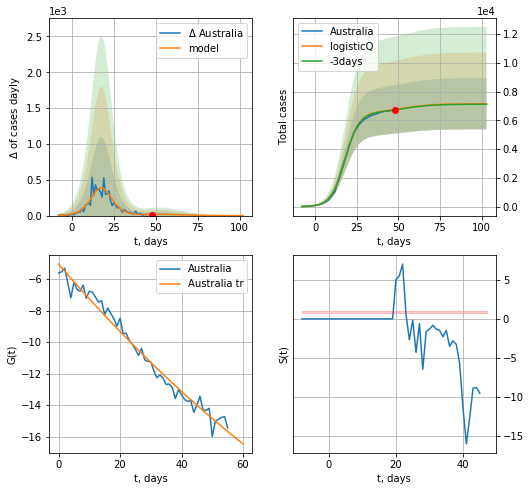

Australia data at: 2020-04-26
+3 day model MAPE: 0.004696620977350431
model: logisticQ
coeffs:  [ 6.57927341e+03  3.94733529e-06  1.79649985e+01 -5.97165235e+04]
scenario coeffs:  [0.0875, 0.5, 3, 1]
rational stdev:  0.24892828498339578
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  7153 ± 1780
	 total death:  88 ± 65
trend coefficient of determination: 0.979186
 intercept_: -5.04293003640014
 coeffs_: [ 0.         -0.22586606  0.0005929 ]


In [236]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=[0.35/4,.5,3,1])

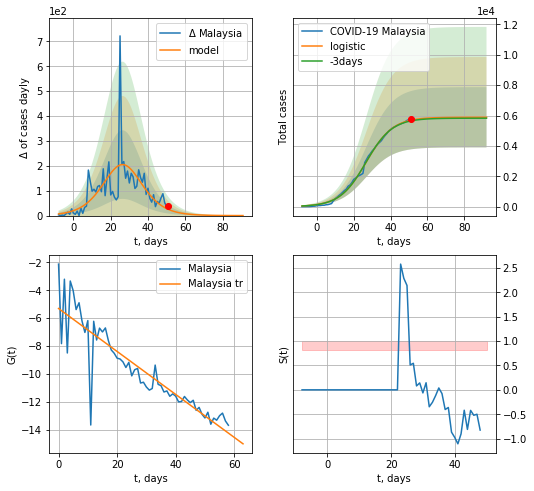

Malaysia data at: 2020-04-26
+3 day model MAPE: 0.008322223840756702
model: logistic
coeffs:  [5.88808045e+03 1.39390407e-01 2.68367938e+01]
rational stdev:  0.33701000010743026
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  5887 ± 1984
	 total death:  99 ± 100
trend coefficient of determination: 0.797049
 intercept: -5.305925
 slope: -0.154190


In [237]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

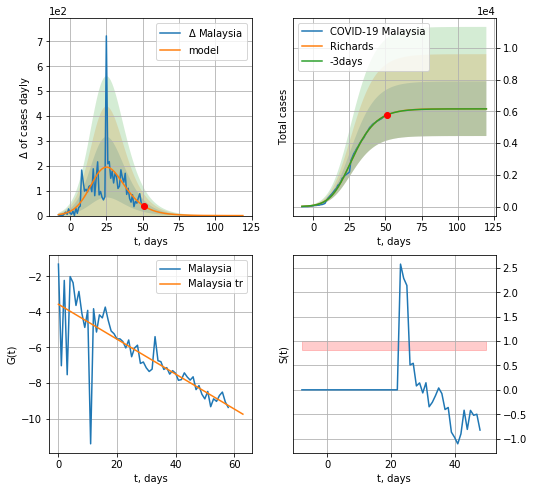

Malaysia data at: 2020-04-26
+3 day model MAPE: 0.0006668992074752164
model: Richards
coeffs:  [6.16908971e+03 2.12833468e-01 1.91335567e+01 5.01209952e-01]
rational stdev:  0.2786703745053077
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  6168 ± 1719
	 total death:  104 ± 86
trend coefficient of determination: 0.625842
 intercept: -3.573687
 slope: -0.097947


In [238]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


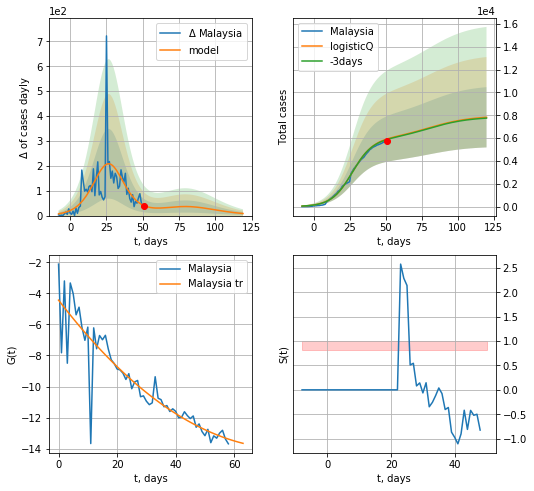

Malaysia data at: 2020-04-26
+3 day model MAPE: 0.007913073024412458
model: logisticQ
coeffs:  [ 5.88715910e+03  3.16801827e-06  2.68351078e+01 -4.39757871e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.33716130764499364
forecast at the end of period: +69 days
	 deltaDaycases:  8
	 total cases:  7824 ± 2638
	 total death:  132 ± 133
trend coefficient of determination: 0.816409
 intercept_: -4.438640049219099
 coeffs_: [ 0.         -0.24551235  0.00157478]


In [239]:
x = forecastRRR('Malaysia',dfML[:],d1,14*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

ZL
          date   cases  active  death
54 2020-04-22  1451.0     370   16.0
55 2020-04-23  1456.0     344   17.0
56 2020-04-24  1461.0     325   18.0
57 2020-04-25  1470.0     310   18.0
58 2020-04-26  1470.5     270   19.0


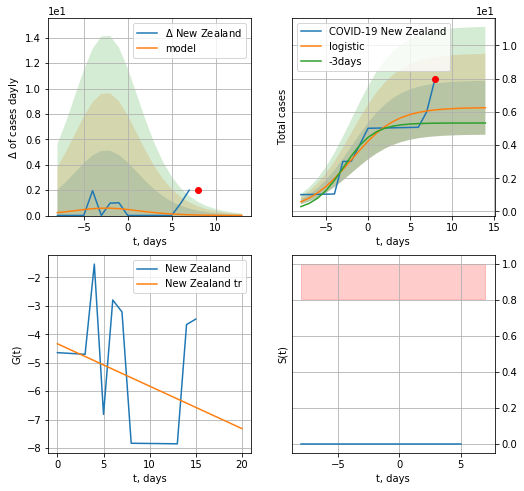

New Zealand data at: 2020-04-26
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


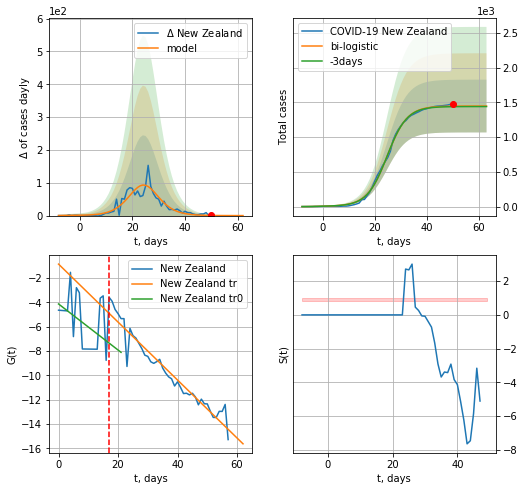

New Zealand data at: 2020-04-26
+3 day model MAPE: 0.005058054271682126
model: bi-logistic
coeffs:  [1.44066716e+03 2.59174208e-01 2.47565004e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.2621775753671613
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1446 ± 379
	 total death:  18 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.933091
 intercept: -0.856697
 slope: -0.238238


In [242]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,5*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

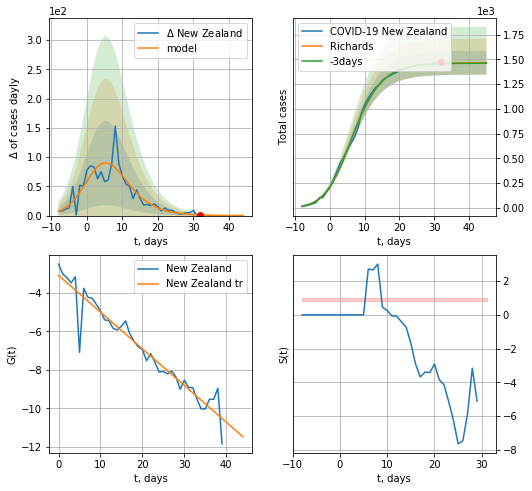

New Zealand data at: 2020-04-26
+3 day model MAPE: 0.003205914930058332
model: Richards
coeffs:  [1.46576942e+03 3.97530293e-01 2.76150374e+00 5.29426743e-01]
rational stdev:  0.08235110031690805
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1465 ± 120
	 total death:  18 ± 4
trend coefficient of determination: 0.920509
 intercept: -3.091232
 slope: -0.190727


In [243]:
x = forecastRR('New Zealand',dfZL[18:],d1,6*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


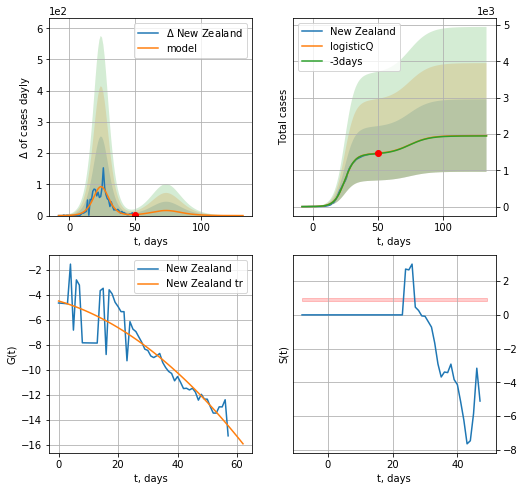

New Zealand data at: 2020-04-26
+3 day model MAPE: 0.005022323231791027
model: logisticQ
coeffs:  [ 1.44807882e+03  5.88591389e-06  2.47173022e+01 -4.35174503e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.5102115253885553
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  1954 ± 997
	 total death:  25 ± 38
trend coefficient of determination: 0.814964
 intercept_: -4.484086662592042
 coeffs_: [ 0.         -0.06964957 -0.00185136]


In [244]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

BR
          date    cases  active  death
54 2020-04-22   7281.0    6454   58.0
55 2020-04-23   8022.0    7024   60.0
56 2020-04-24   8773.0    7590   63.0
57 2020-04-25   9590.0    7950   67.0
58 2020-04-26  10463.0    8696   72.0


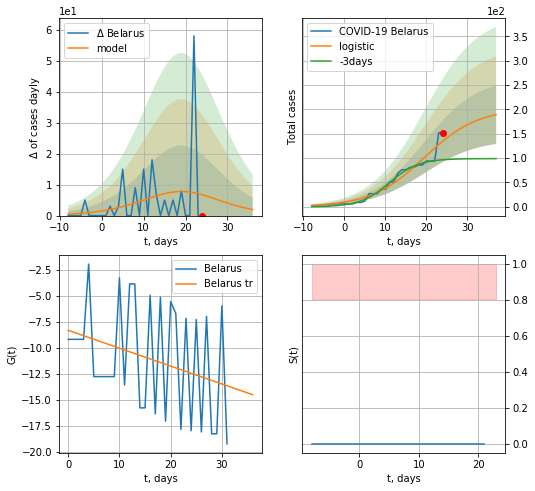

Belarus data at: 2020-04-26
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  189 ± 60
	 total death:  1 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


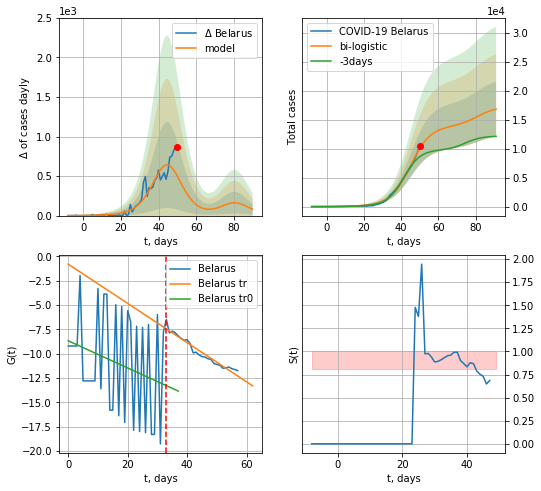

Belarus data at: 2020-04-26
+3 day model MAPE: 0.19120384915975944
model: bi-logistic
coeffs:  [1.36651409e+04 1.87478819e-01 4.50091946e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.2812300893401896
forecast at the end of period: +41 days
	 deltaDaycases:  79
	 total cases:  16825 ± 4731
	 total death:  115 ± 97
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.942684
 intercept: -0.801048
 slope: -0.201636


In [245]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
54 2020-04-22   7281.0    6454   58.0
55 2020-04-23   8022.0    7024   60.0
56 2020-04-24   8773.0    7590   63.0
57 2020-04-25   9590.0    7950   67.0
58 2020-04-26  10463.0    8696   72.0


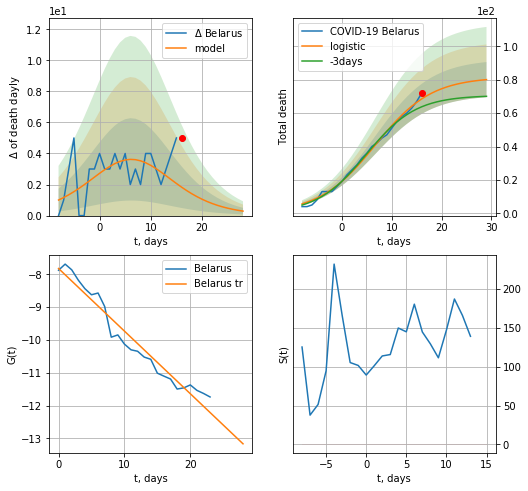

Belarus data at: 2020-04-26
+3 day model MAPE: 0.08339313995885861
model: logistic
coeffs:  [81.58055875  0.1776803   6.67310484]
rational stdev:  0.13145987644039683
forecast at the end of period: +13 days
	 total death:  80 ± 10
trend coefficient of determination: 0.952242
 intercept: -7.818315
 slope: -0.191096


In [246]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[34:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


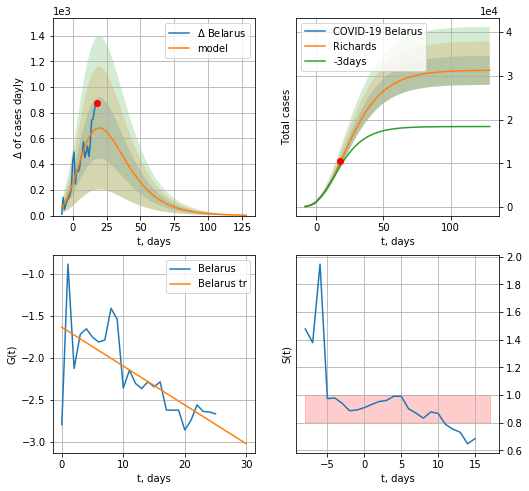

Belarus data at: 2020-04-26
+3 day model MAPE: 0.09709026228458438
model: Richards
coeffs:  [ 3.13123822e+04  2.95954714e+00 -4.51277533e+01  2.02011265e-02]
rational stdev:  0.10570514914224889
forecast at the end of period: +111 days
	 deltaDaycases:  2
	 total cases:  31265 ± 3304
	 total death:  215 ± 68
trend coefficient of determination: 0.497161
 intercept: -1.636517
 slope: -0.046370


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


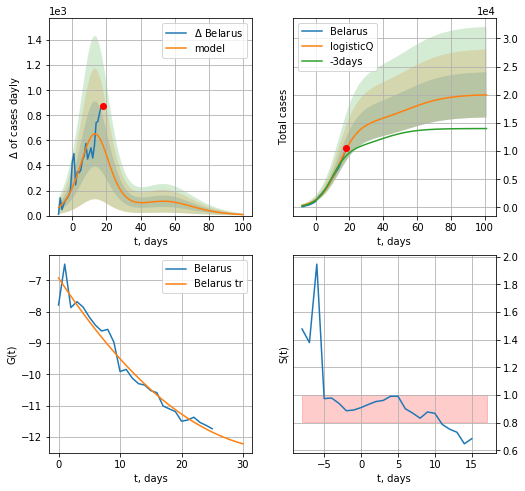

Belarus data at: 2020-04-26
+3 day model MAPE: 0.14837401622478047
model: logisticQ
coeffs:  [ 1.48657108e+04  7.98311735e-06  1.36933372e+01 -2.15796971e+04]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.20106326550595824
forecast at the end of period: +83 days
	 deltaDaycases:  8
	 total cases:  19975 ± 4016
	 total death:  137 ± 82
trend coefficient of determination: 0.961668
 intercept_: -6.926195961561976
 coeffs_: [ 0.         -0.29877026  0.00407684]


In [247]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,4,1])

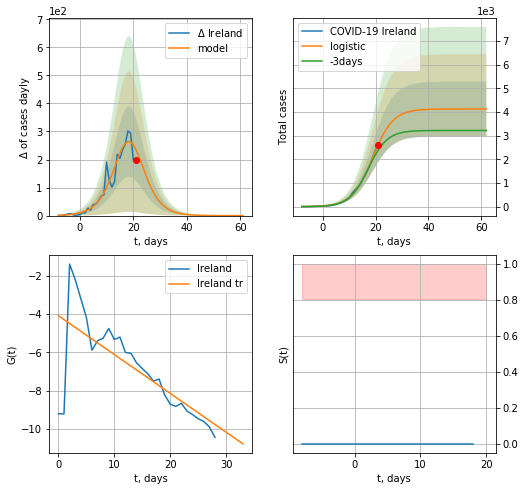

Ireland data at: 2020-04-26
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  232 ± 194
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


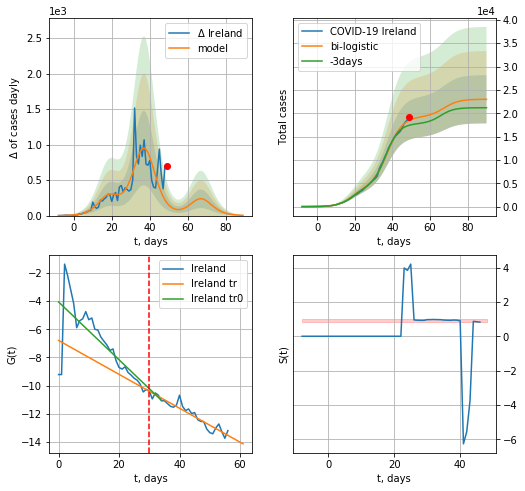

Ireland data at: 2020-04-26
+3 day model MAPE: 0.0640400093560718
model: bi-logistic
coeffs:  [1.51005745e+04 2.50260818e-01 3.74377191e+01] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.22474182208013258
forecast at the end of period: +41 days
	 deltaDaycases:  3
	 total cases:  22989 ± 5166
	 total death:  1297 ± 874
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.901871
 intercept: -6.793341
 slope: -0.120042


In [248]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


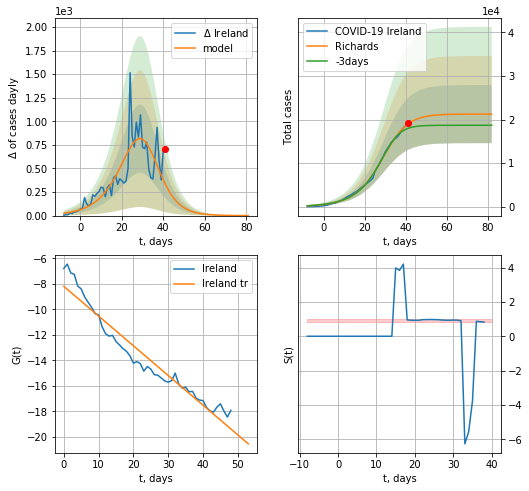

Ireland data at: 2020-04-26
+3 day model MAPE: 0.06378983468095915
model: Richards
coeffs:  [2.12507750e+04 1.19067179e-01 3.14735514e+01 1.48000807e+00]
rational stdev:  0.3137855215952504
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  21248 ± 6667
	 total death:  1199 ± 1128
trend coefficient of determination: 0.938149
 intercept: -8.186909
 slope: -0.233115


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp


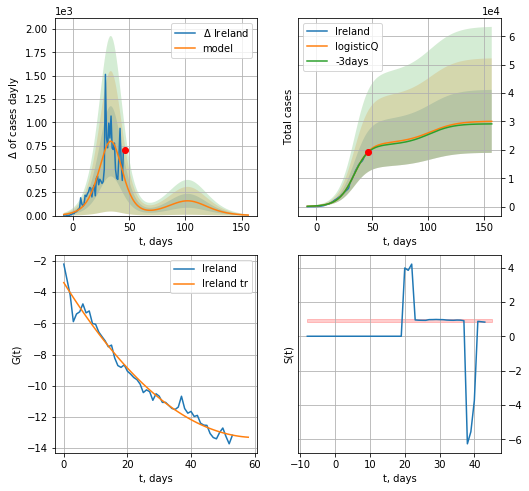

Ireland data at: 2020-04-26
+3 day model MAPE: 0.012605240638837764
model: logisticQ
coeffs:  [ 2.22882385e+04  2.92104557e-04  3.38112652e+01 -4.53700489e+02]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3694538030023708
forecast at the end of period: +111 days
	 deltaDaycases:  5
	 total cases:  30034 ± 11096
	 total death:  1694 ± 1877
trend coefficient of determination: 0.978031
 intercept_: -3.384731706609795
 coeffs_: [ 0.         -0.32809335  0.00270847]


In [251]:
x = forecastRR('Ireland',dfIR[8:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

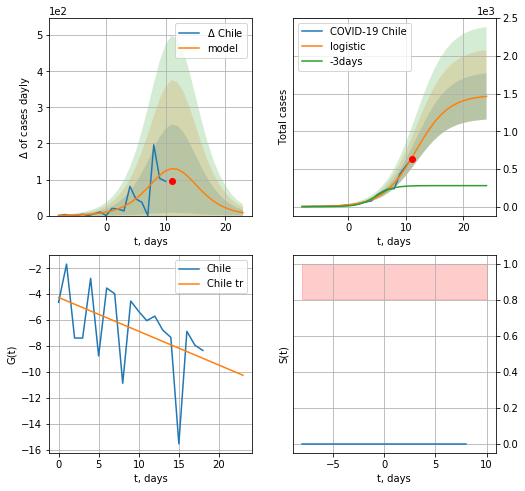

Chile data at: 2020-04-26
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +13 days
	 deltaDaycases:  8
	 total cases:  1462 ± 307
	 total death:  20 ± 12
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


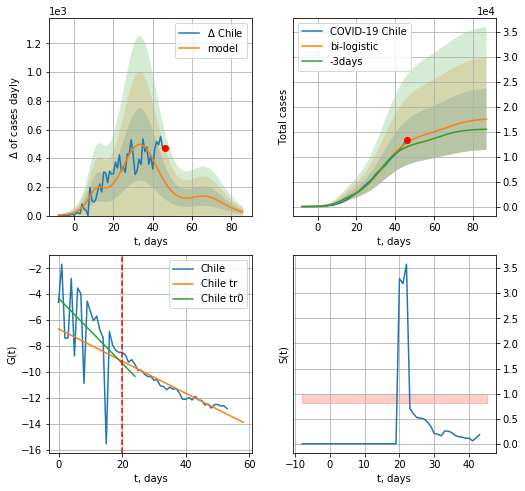

Chile data at: 2020-04-26
+3 day model MAPE: 0.07559825046472758
model: bi-logistic
coeffs:  [1.29709324e+04 1.52459968e-01 3.38366792e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35164405455092046
forecast at the end of period: +41 days
	 deltaDaycases:  25
	 total cases:  17529 ± 6164
	 total death:  248 ± 261
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.935727
 intercept: -6.678329
 slope: -0.124312


In [252]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


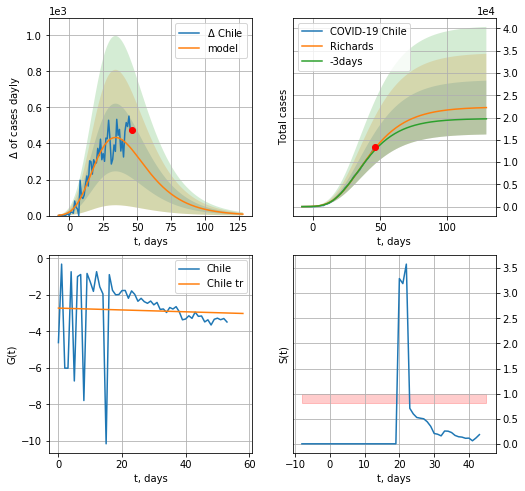

Chile data at: 2020-04-26
+3 day model MAPE: 0.032267240277020354
model: Richards
coeffs:  [ 2.23864631e+04  3.43381411e+00 -4.40797309e+01  1.54430953e-02]
rational stdev:  0.2715956562914272
forecast at the end of period: +83 days
	 deltaDaycases:  8
	 total cases:  22237 ± 6039
	 total death:  315 ± 256
trend coefficient of determination: 0.002023
 intercept: -2.723813
 slope: -0.005052


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


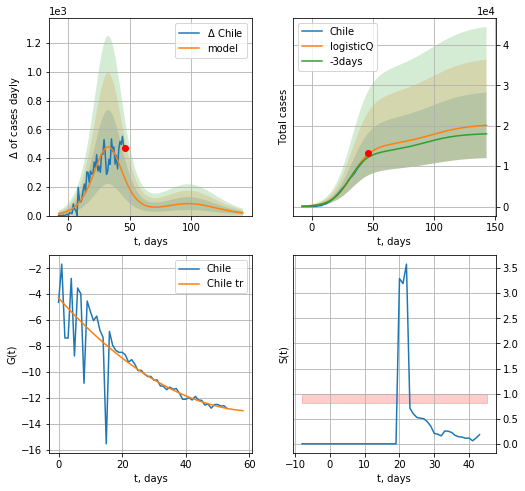

Chile data at: 2020-04-26
+3 day model MAPE: 0.0659250301844858
model: logisticQ
coeffs:  [ 1.51295168e+04  2.11360650e-06  3.27724323e+01 -5.91244286e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.40309554994582764
forecast at the end of period: +97 days
	 deltaDaycases:  18
	 total cases:  20120 ± 8110
	 total death:  285 ± 344
trend coefficient of determination: 0.716281
 intercept_: -4.287427652045345
 coeffs_: [ 0.         -0.27508787  0.00215432]


In [253]:
x = forecastRR('Chile',dfCL[:],d1,16*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

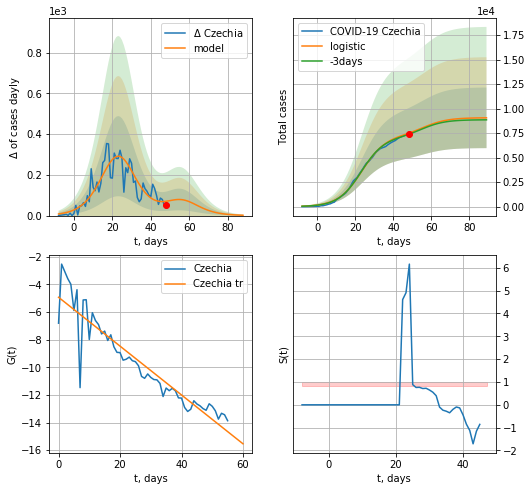

Czechia data at: 2020-04-26
+3 day model MAPE: 0.015010162319683513
model: logistic
coeffs:  [7.26044479e+03 1.60109829e-01 2.35039174e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3412564546640702
forecast at the end of period: +41 days
	 deltaDaycases:  1
	 total cases:  9065 ± 3093
	 total death:  269 ± 275
trend coefficient of determination: 0.863403
 intercept: -4.931702
 slope: -0.176809


In [254]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


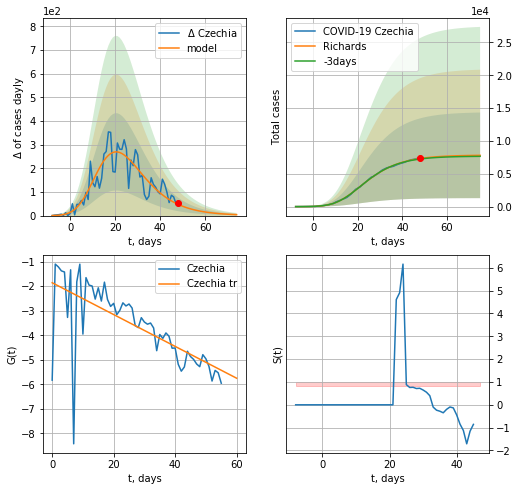

Czechia data at: 2020-04-26
+3 day model MAPE: 0.011317729718780036
model: Richards
coeffs:  [ 7.84520917e+03  8.81866208e-01 -1.27512809e+00  1.11851404e-01]
rational stdev:  0.8346848047881982
forecast at the end of period: +27 days
	 deltaDaycases:  3
	 total cases:  7807 ± 6516
	 total death:  231 ± 578
trend coefficient of determination: 0.461740
 intercept: -1.860256
 slope: -0.064840


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


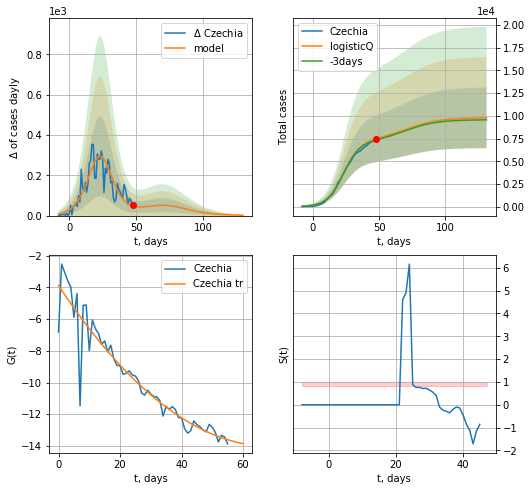

Czechia data at: 2020-04-26
+3 day model MAPE: 0.018648332035348214
model: logisticQ
coeffs:  [ 7.26006584e+03  1.74780484e-06  2.35035852e+01 -9.15863224e+04]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3413237291484855
forecast at the end of period: +83 days
	 deltaDaycases:  1
	 total cases:  9781 ± 3338
	 total death:  290 ± 296
trend coefficient of determination: 0.889390
 intercept_: -3.884076517936588
 coeffs_: [ 0.         -0.29325302  0.00211753]


In [255]:
x = forecastRR('Czechia',dfCH[:],d1,8*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

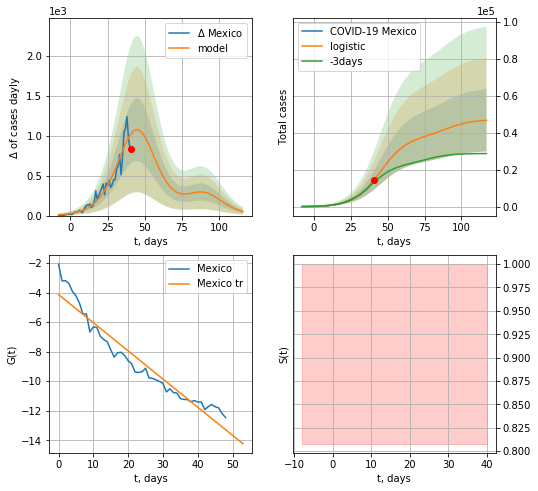

Mexico data at: 2020-04-26
+3 day model MAPE: 0.1119038160425275
model: logistic
coeffs:  [3.77701384e+04 1.13238832e-01 4.50876541e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3610476701697452
forecast at the end of period: +76 days
	 deltaDaycases:  50
	 total cases:  46769 ± 16886
	 total death:  4305 ± 4662
trend coefficient of determination: 0.930548
 intercept: -4.140774
 slope: -0.190487


In [256]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


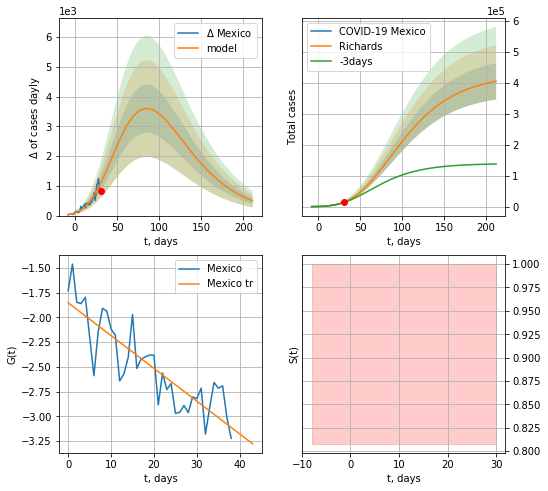

Mexico data at: 2020-04-26
+3 day model MAPE: 0.06586841045215144
model: Richards
coeffs:  [ 4.26204621e+05  6.31043647e-01 -5.52418838e+01  3.70539711e-02]
rational stdev:  0.14489098841641065
forecast at the end of period: +181 days
	 deltaDaycases:  497
	 total cases:  404564 ± 58617
	 total death:  37239 ± 16186
trend coefficient of determination: 0.745155
 intercept: -1.851255
 slope: -0.033175


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


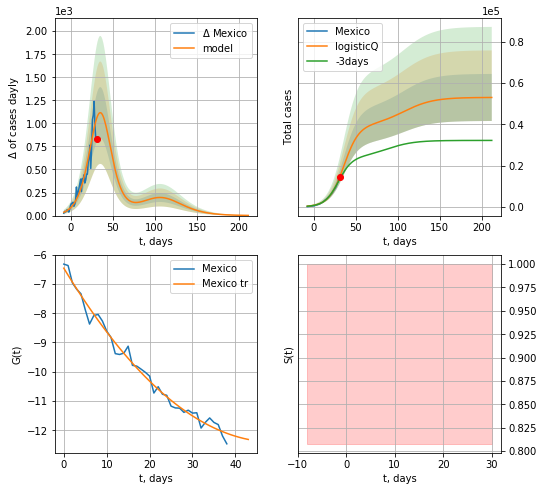

Mexico data at: 2020-04-26
+3 day model MAPE: 0.1031044674347431
model: logisticQ
coeffs:  [ 3.92653242e+04  1.74131348e-05  3.56529583e+01 -6.41809556e+03]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.21515256885574494
forecast at the end of period: +181 days
	 deltaDaycases:  1
	 total cases:  52976 ± 11397
	 total death:  4876 ± 3147
trend coefficient of determination: 0.986303
 intercept_: -6.461089432719052
 coeffs_: [ 0.         -0.24239931  0.00247302]


In [257]:
x = forecastRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,30*7-dT,addpred=True,xcoef=[0.35,.5,3,1])#

LT
          date  cases  active    death     tests
44 2020-04-22   1416     961  38.0001   83591.0
45 2020-04-23   1428     940  40.0000   90992.0
46 2020-04-24   1444     925  41.0000   98948.0
47 2020-04-25   1461     930  41.5000  104488.0
48 2020-04-26   1499     934  41.0000  106775.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


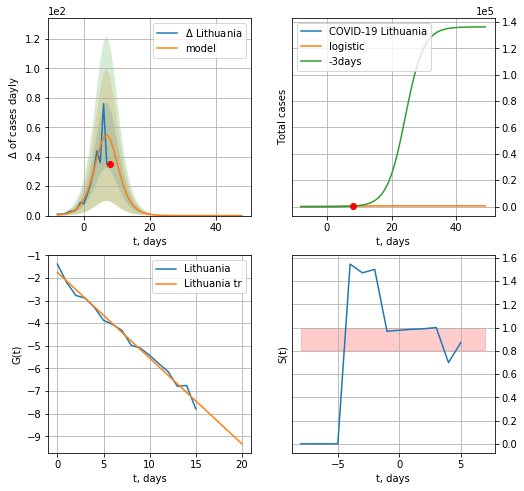

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.4095592648194834
model: logistic
coeffs:  [5.23939459e+02 4.20925972e-01 7.38226820e+00]
rational stdev:  0.21893418830777175
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  523 ± 114
	 total death:  14 ± 9
trend coefficient of determination: 0.988070
 intercept: -1.754955
 slope: -0.378904


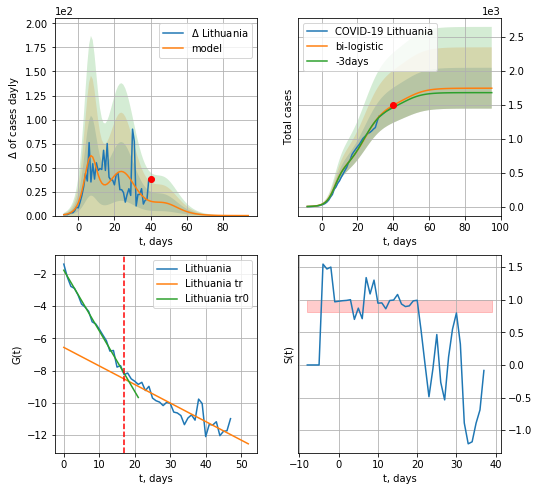

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.02194551108221315
model: bi-logistic
coeffs:  [9.78897851e+02 1.85256245e-01 2.42269748e+01] [5.23939459e+02 4.20925972e-01 7.38226820e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.17247347201330646
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  1747 ± 301
	 total death:  49 ± 25
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.989701
 intercept: -1.767222
 slope: -0.376451
trend coefficient of determination: 0.822255
 intercept: -6.560902
 slope: -0.115191


In [258]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:vL],d1,6*7-1)
xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

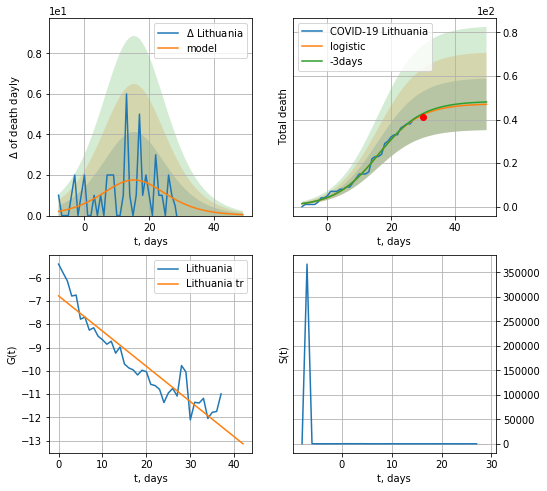

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.013648423458291844
model: logistic
coeffs:  [47.27628585  0.14869051 15.77934049]
rational stdev:  0.25226665067356385
forecast at the end of period: +20 days
	 total death:  46 ± 11
trend coefficient of determination: 0.869589
 intercept: -6.785909
 slope: -0.151020


In [259]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


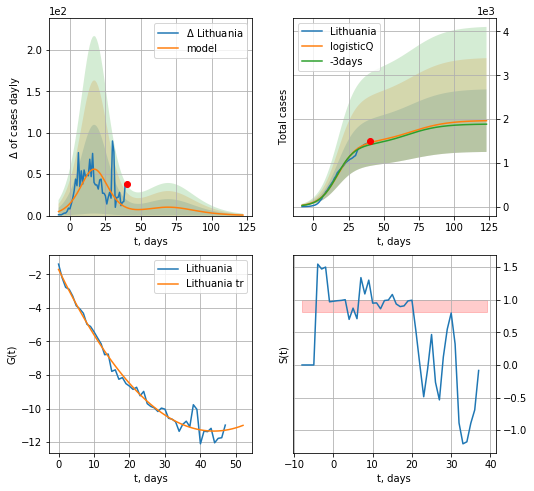

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.03210935508515117
model: logisticQ
coeffs:  [ 1.45984426e+03  1.26241898e-06  1.75224571e+01 -1.20298803e+05]
scenario coeffs:  [0.35, 0.52, 4.0, 1.0]
rational stdev:  0.3635910949966519
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  1963 ± 713
	 total death:  55 ± 59
trend coefficient of determination: 0.983502
 intercept_: -1.7023290532760367
 coeffs_: [ 0.         -0.44051389  0.00503118]


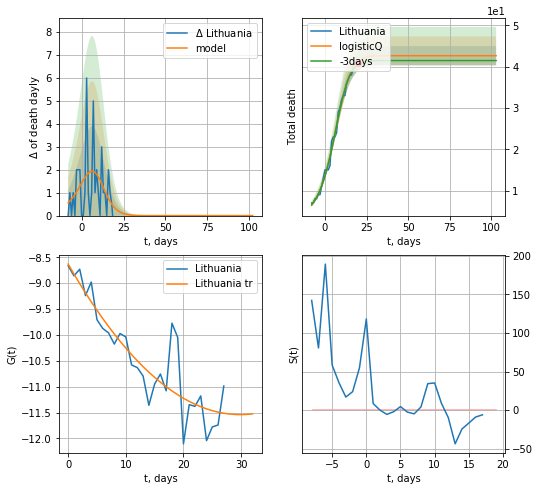

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.020391112625239047
model: logisticQ
coeffs:  [ 4.26640922e+01  3.15535548e-03  4.75841417e+00 -5.08148137e+01]
rational stdev:  0.054497473096269046
forecast at the end of period: +83 days
	 total death:  42 ± 2
trend coefficient of determination: 0.797919
 intercept_: -8.632155542656573
 coeffs_: [ 0.         -0.19486999  0.00326458]


In [411]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.52,4.,1.])
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


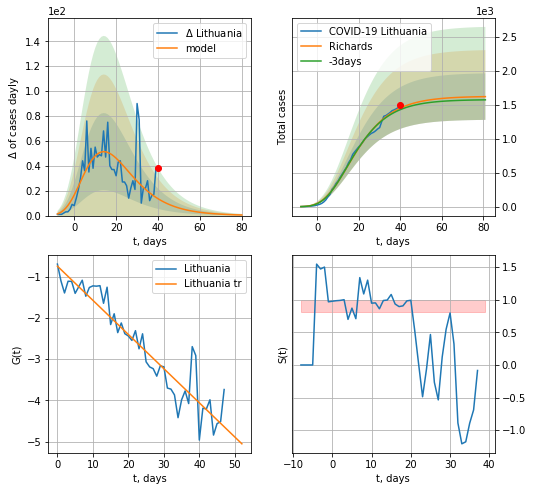

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.01729245981714674
model: Richards
coeffs:  [ 1.62863407e+03  9.90658599e+00 -4.04858664e+01  8.69195687e-03]
rational stdev:  0.2112013207540492
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1623 ± 342
	 total death:  45 ± 28
trend coefficient of determination: 0.887249
 intercept: -0.748969
 slope: -0.082796


In [261]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


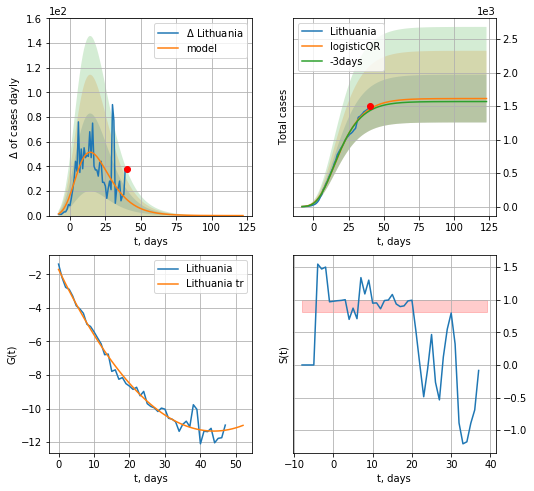

Lithuania data at: 2020-04-26
+3 day model MAPE: 0.017408263306103327
model: logisticQR
coeffs:  [ 1.61173448e+03  5.00787815e-02 -6.50641742e+01 -8.94197898e+02
  1.75310261e-03]
rational stdev:  0.2209089490616914
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  1611 ± 356
	 total death:  45 ± 29
trend coefficient of determination: 0.983502
 intercept_: -1.7023290532760367
 coeffs_: [ 0.         -0.44051389  0.00503118]


In [262]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
46 2020-04-22  3654.0    2863   80.0
47 2020-04-23  3665.0    2854   83.0
48 2020-04-24  3695.0     603   85.0
49 2020-04-25  3711.0     538   85.0
50 2020-04-26  3723.0     531   88.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


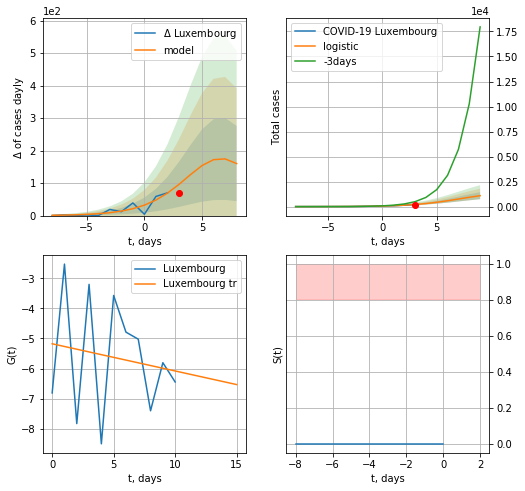

Luxembourg data at: 2020-04-26
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +6 days
	 deltaDaycases:  160
	 total cases:  1092 ± 351
	 total death:  25 ± 24
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


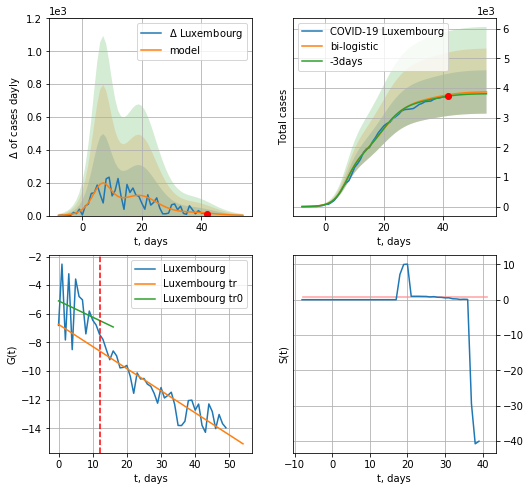

Luxembourg data at: 2020-04-26
+3 day model MAPE: 0.012777180735913666
model: bi-logistic
coeffs:  [2.05316095e+03 2.34562877e-01 1.96953372e+01] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.1889586879383118
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  3865 ± 730
	 total death:  91 ± 51
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.848981
 intercept: -6.740125
 slope: -0.154369


In [264]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,5*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


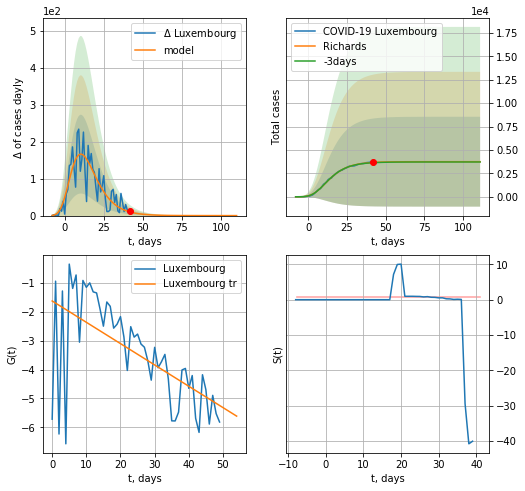

Luxembourg data at: 2020-04-26
+3 day model MAPE: 0.007110044032632994
model: Richards
coeffs:  [ 3.74720873e+03  1.26980593e+01 -2.74520038e+01  9.56600670e-03]
rational stdev:  1.27992528469219
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  3747 ± 4796
	 total death:  88 ± 337
trend coefficient of determination: 0.378776
 intercept: -1.622336
 slope: -0.073873


In [265]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


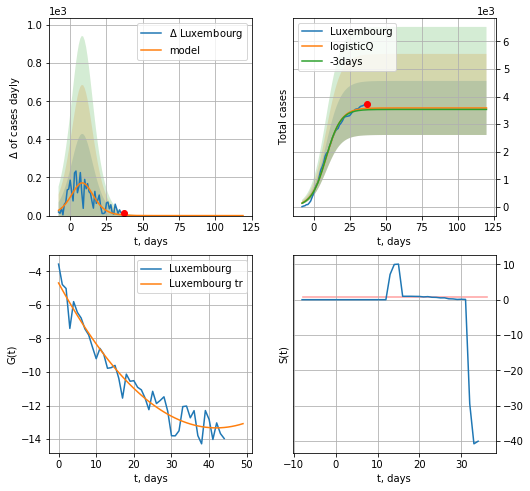

Luxembourg data at: 2020-04-26
+3 day model MAPE: 0.01442579400974052
model: logisticQ
coeffs:  [ 3.58714653e+03  1.81561529e-06 -1.05634958e+05  8.80492102e+00]
rational stdev:  0.2733057377090904
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  3587 ± 980
	 total death:  84 ± 68
trend coefficient of determination: 0.942649
 intercept_: -4.6955420565455945
 coeffs_: [ 0.         -0.41237026  0.00492631]


In [268]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

ED
          date    cases   active  death
53 2020-04-22  10850.0   9051.0  537.0
54 2020-04-23  11183.0   9295.0  560.0
55 2020-04-24  22719.0  20777.0  576.0
56 2020-04-25  22719.1  20777.1  576.1
57 2020-04-26  22719.2  20777.2  576.2


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


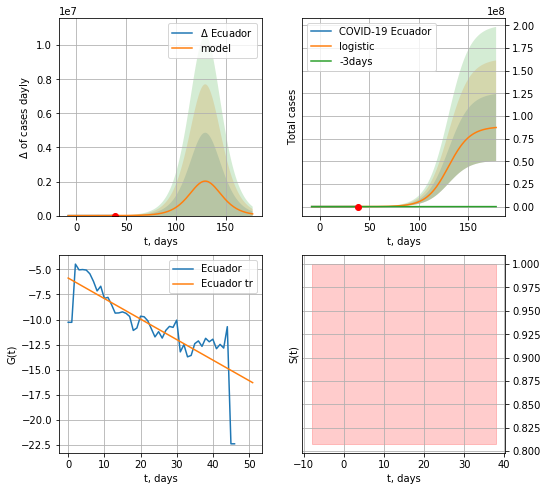

Ecuador data at: 2020-04-26
+3 day model MAPE: 0.986667721438964
model: logistic
coeffs:  [8.82897841e+07 9.16348310e-02 1.29943713e+02]
rational stdev:  0.4239939756303735
forecast at the end of period: +139 days
	 deltaDaycases:  101038
	 total cases:  87222800 ± 36981941
	 total death:  2211379 ± 2812834
trend coefficient of determination: 0.630497
 intercept: -5.868668
 slope: -0.204076


In [270]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


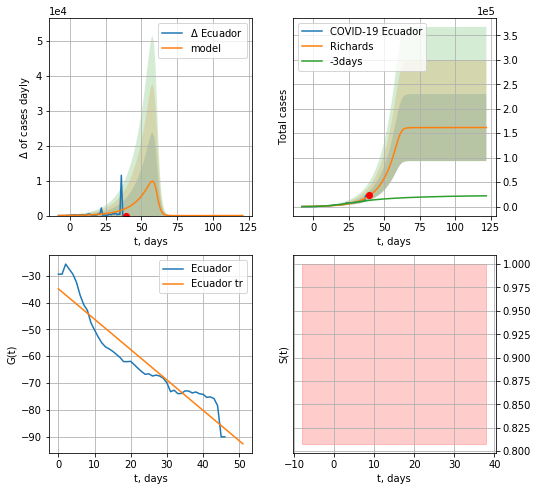

Ecuador data at: 2020-04-26
+3 day model MAPE: 0.7885942670355374
model: Richards
coeffs:  [1.61451572e+05 9.16260130e-02 6.11499350e+01 7.75147286e+00]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.4239342648711257
forecast at the end of period: +83 days
	 deltaDaycases:  9
	 total cases:  161657 ± 68531
	 total death:  4098 ± 5211
trend coefficient of determination: 0.890959
 intercept: -34.893528
 slope: -1.133318


In [271]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


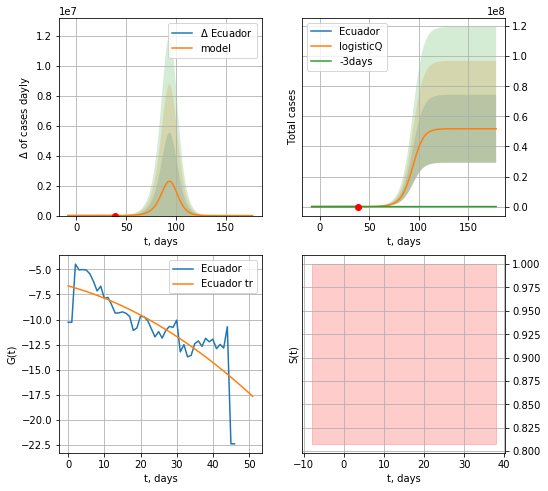

Ecuador data at: 2020-04-26
+3 day model MAPE: 1.0856889502152403
model: logisticQ
coeffs:  [ 5.17545037e+07  6.46512897e-04  9.35984686e+01 -1.80820221e+02]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.4361197591920291
forecast at the end of period: +139 days
	 deltaDaycases:  0
	 total cases:  51754503 ± 22571161
	 total death:  1312143 ± 1716754
trend coefficient of determination: 0.641980
 intercept_: -6.653822621939747
 coeffs_: [ 0.         -0.09941198 -0.00227504]


In [272]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

FI
          date   cases  active  death
57 2020-04-22  4129.0    1980  149.0
58 2020-04-23  4284.0    2112  172.0
59 2020-04-24  4395.0    1718  177.0
60 2020-04-25  4475.0    1789  186.0
61 2020-04-26  4576.0    1886  190.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


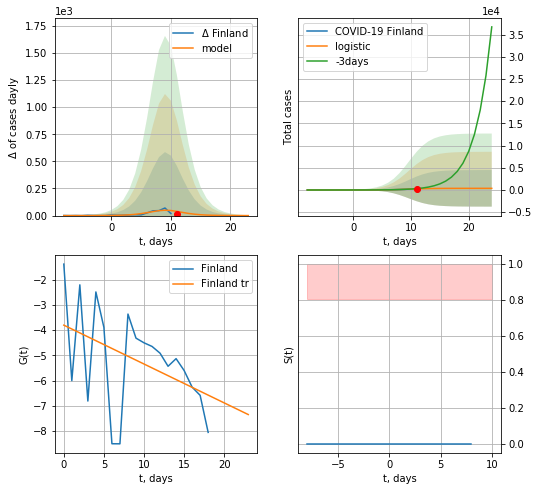

Finland data at: 2020-04-26
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  373 ± 4114
	 total death:  15 ± 496
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


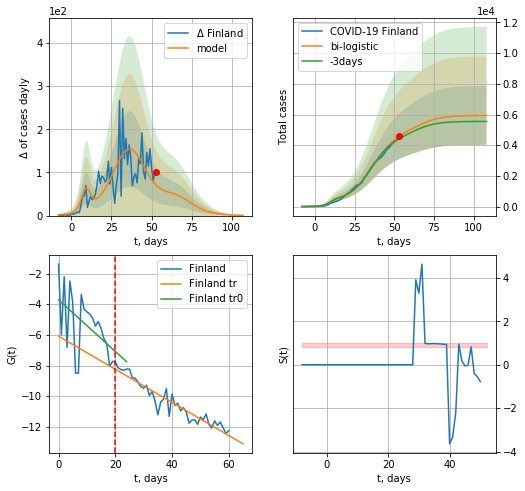

Finland data at: 2020-04-26
+3 day model MAPE: 0.037612826644798196
model: bi-logistic
coeffs:  [4.45687159e+03 1.36303905e-01 3.65203431e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3234802876232648
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  5940 ± 1921
	 total death:  246 ± 238
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.900168
 intercept: -6.086749
 slope: -0.107999


In [273]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


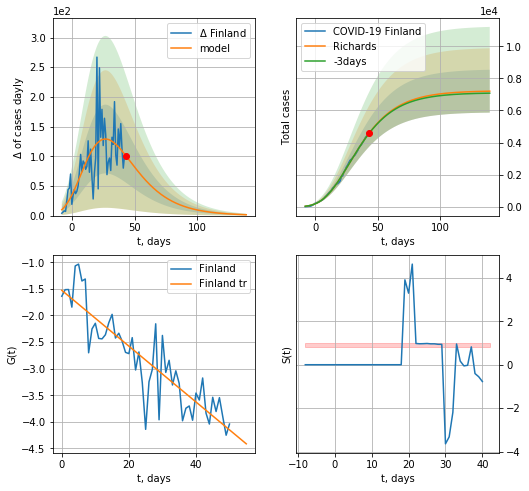

Finland data at: 2020-04-26
+3 day model MAPE: 0.004258642269942692
model: Richards
coeffs:  [ 7.23079115e+03  1.82148801e+00 -4.62273002e+01  2.69867314e-02]
rational stdev:  0.1852406425845241
forecast at the end of period: +97 days
	 deltaDaycases:  1
	 total cases:  7202 ± 1334
	 total death:  299 ± 166
trend coefficient of determination: 0.780294
 intercept: -1.526783
 slope: -0.052475


In [275]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


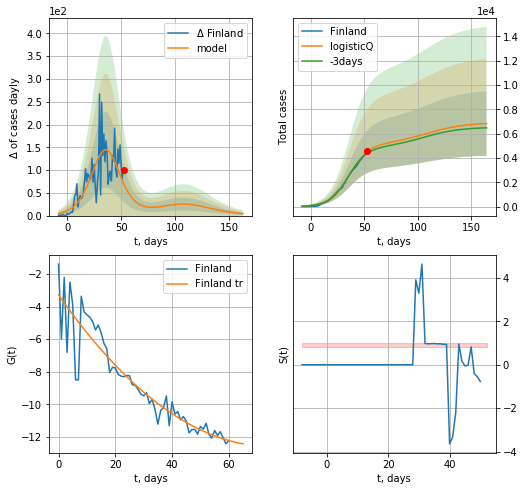

Finland data at: 2020-04-26
+3 day model MAPE: 0.03147084868459329
model: logisticQ
coeffs:  [ 5.12001646e+03  2.16196472e-06  3.61139931e+01 -5.16270489e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1.0]
rational stdev:  0.38764611278696626
forecast at the end of period: +111 days
	 deltaDaycases:  4
	 total cases:  6835 ± 2649
	 total death:  283 ± 329
trend coefficient of determination: 0.861760
 intercept_: -3.280531940995731
 coeffs_: [ 0.         -0.24922433  0.00166923]


In [277]:
x = forecastRRR("Finland",dfFI[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

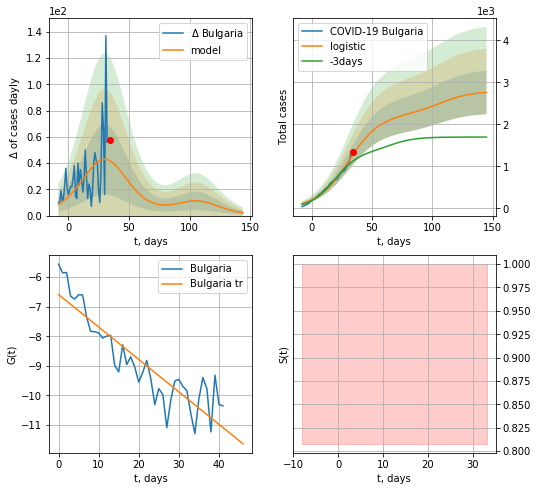

Bulgaria data at: 2020-04-26
+3 day model MAPE: 0.14991201729900927
model: logistic
coeffs:  [2.23222822e+03 7.67720252e-02 3.04357483e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.1882634901219337
forecast at the end of period: +111 days
	 deltaDaycases:  2
	 total cases:  2762 ± 520
	 total death:  114 ± 64
trend coefficient of determination: 0.801820
 intercept: -6.588362
 slope: -0.109656


In [279]:
x = forecast('Bulgaria',dfBL[5:],d1,20*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


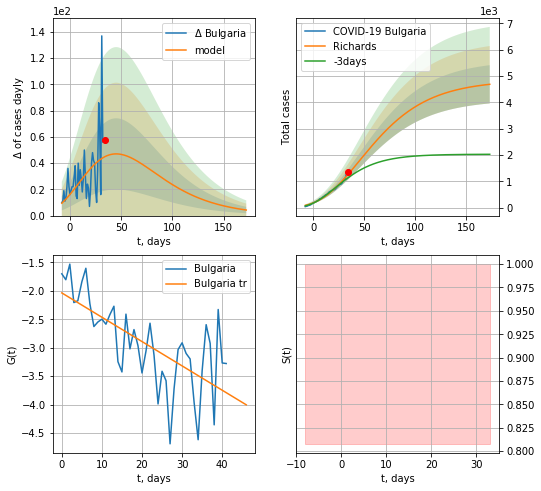

Bulgaria data at: 2020-04-26
+3 day model MAPE: 0.12554858934069904
model: Richards
coeffs:  [ 4.84777192e+03  1.44590901e+00 -1.04545120e+02  1.84119125e-02]
rational stdev:  0.1550465882207349
forecast at the end of period: +139 days
	 deltaDaycases:  4
	 total cases:  4687 ± 726
	 total death:  194 ± 90
trend coefficient of determination: 0.467671
 intercept: -2.037149
 slope: -0.042769


In [281]:
x = forecastRR('Bulgaria',dfBL[5:],d1,24*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


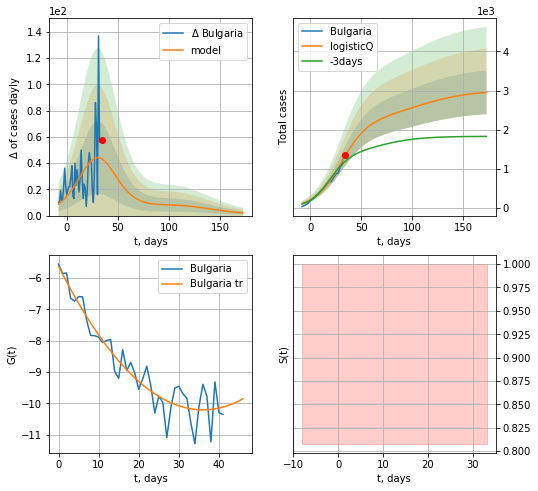

Bulgaria data at: 2020-04-26
+3 day model MAPE: 0.12137626288458458
model: logisticQ
coeffs:  [ 2.22804226e+03  2.44335333e-06  3.03866827e+01 -3.14335627e+04]
scenario coeffs:  [0.35, 0.5, 3.5, 1]
rational stdev:  0.18835973529471986
forecast at the end of period: +139 days
	 deltaDaycases:  2
	 total cases:  2952 ± 556
	 total death:  122 ± 68
trend coefficient of determination: 0.900192
 intercept_: -5.623944029853234
 coeffs_: [ 0.         -0.25440394  0.00353145]


In [283]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,24*7-dT,shift=1.0,addpred=True,xcoef=[0.35,.5,3.5,1])

TH
          date  cases  active  death
55 2020-04-22   2826   425.0   49.0
56 2020-04-23   2839   359.0   50.0
57 2020-04-24   2854   314.0   50.0
58 2020-04-25   2907   309.0   51.0
59 2020-04-26   2931   270.0   52.0


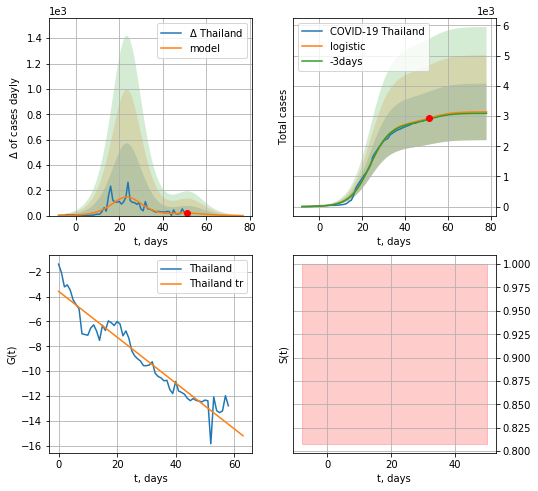

Thailand data at: 2020-04-26
+3 day model MAPE: 0.011971495496178926
model: logistic
coeffs:  [2.79120547e+03 2.09889664e-01 2.39414720e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.2988859924456939
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  3138 ± 938
	 total death:  55 ± 49
trend coefficient of determination: 0.917149
 intercept: -3.574734
 slope: -0.184522


In [284]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [285]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


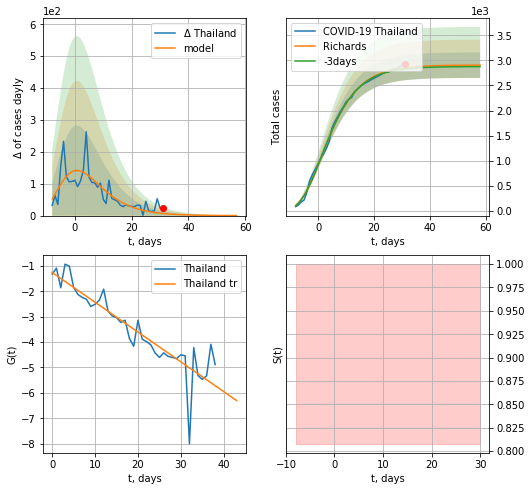

Thailand data at: 2020-04-26
+3 day model MAPE: 0.008686584691845042
model: Richards
coeffs:  [ 2.90717083e+03  1.28406565e+01 -3.31152381e+01  1.03722471e-02]
rational stdev:  0.08752434534930381
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2905 ± 254
	 total death:  51 ± 13
trend coefficient of determination: 0.806701
 intercept: -1.256643
 slope: -0.117383


In [286]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


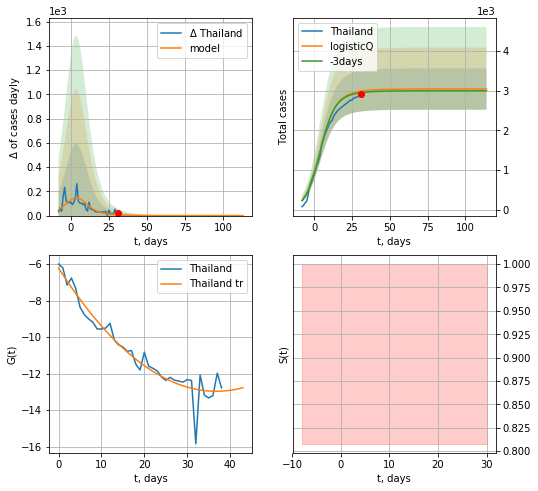

Thailand data at: 2020-04-26
+3 day model MAPE: 0.01338648684736199
model: logisticQ
coeffs:  [ 2.80041714e+03  2.40754242e-06  3.95871342e+00 -8.49370677e+04]
scenario coeffs:  [0.0875, 0.5, 4, 1]
rational stdev:  0.17121767864783402
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  3045 ± 521
	 total death:  54 ± 27
trend coefficient of determination: 0.921253
 intercept_: -6.221287112622303
 coeffs_: [ 0.         -0.36737642  0.00499846]


In [287]:
x = forecastRRR("Thailand",dfTH[20:],d1,16*7-dT,addpred=True,xcoef=[0.35/4,.5,4,1])

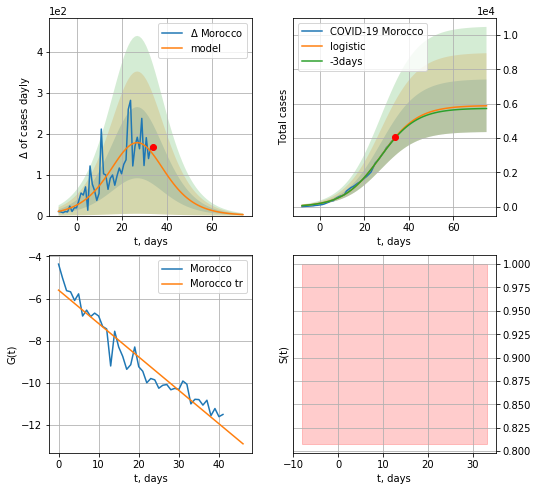

Morocco data at: 2020-04-26
+3 day model MAPE: 0.010136926596622927
model: logistic
coeffs:  [5.89569938e+03 1.20721686e-01 2.74650811e+01]
rational stdev:  0.2599494184978779
forecast at the end of period: +41 days
	 deltaDaycases:  2
	 total cases:  5876 ± 1527
	 total death:  232 ± 180
trend coefficient of determination: 0.925783
 intercept: -5.595279
 slope: -0.158584


In [288]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


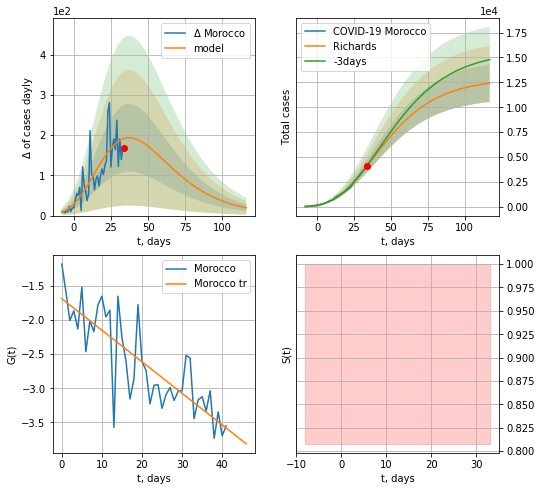

Morocco data at: 2020-04-26
+3 day model MAPE: 0.01858375909740256
model: Richards
coeffs:  [ 1.28736236e+04  9.46597699e-01 -3.70290888e+01  4.40890637e-02]
rational stdev:  0.15195545855585624
forecast at the end of period: +83 days
	 deltaDaycases:  19
	 total cases:  12410 ± 1885
	 total death:  491 ± 223
trend coefficient of determination: 0.670447
 intercept: -1.684249
 slope: -0.046346


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


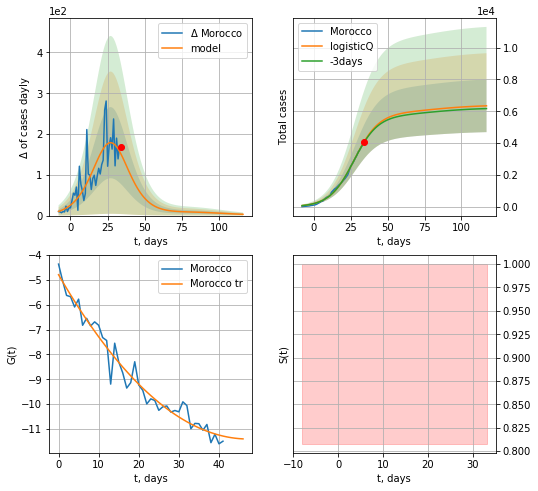

Morocco data at: 2020-04-26
+3 day model MAPE: 0.010241095413929945
model: logisticQ
coeffs:  [ 5.88410877e+03  7.38768230e-06  2.74312660e+01 -1.63414473e+04]
scenario coeffs:  [0.0875, 0.5, 3, 1]
rational stdev:  0.26030220740373466
forecast at the end of period: +83 days
	 deltaDaycases:  3
	 total cases:  6343 ± 1651
	 total death:  251 ± 196
trend coefficient of determination: 0.963852
 intercept_: -4.789056933912691
 coeffs_: [ 0.         -0.27961155  0.00295299]


In [289]:
x = forecastRR("Morocco",dfMR[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,16*7-dT,addpred=True,xcoef=[0.35/4,.5,3,1])

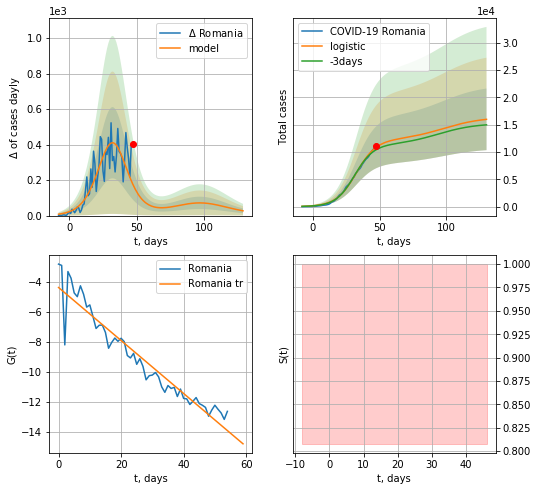

Romania data at: 2020-04-26
+3 day model MAPE: 0.04393053615327094
model: logistic
coeffs:  [1.21575415e+04 1.34029520e-01 3.25144196e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3529780178628891
forecast at the end of period: +83 days
	 deltaDaycases:  26
	 total cases:  15978 ± 5640
	 total death:  896 ± 948
trend coefficient of determination: 0.916514
 intercept: -4.362860
 slope: -0.176708


In [290]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


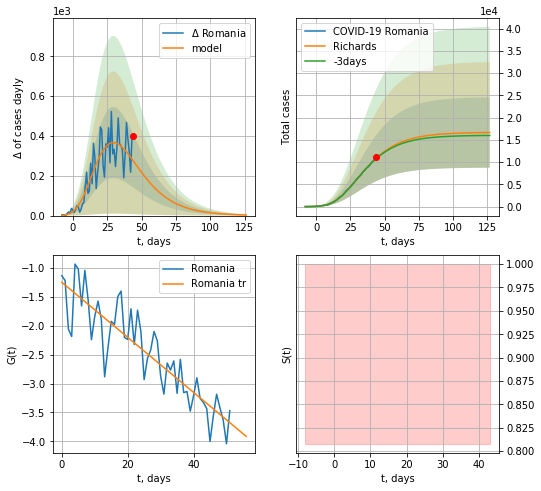

Romania data at: 2020-04-26
+3 day model MAPE: 0.011580290298381304
model: Richards
coeffs:  [ 1.66999863e+04  3.63860150e+00 -3.82465774e+01  1.65502443e-02]
rational stdev:  0.47501174718706196
forecast at the end of period: +83 days
	 deltaDaycases:  2
	 total cases:  16651 ± 7909
	 total death:  933 ± 1329
trend coefficient of determination: 0.784156
 intercept: -1.251675
 slope: -0.047518


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


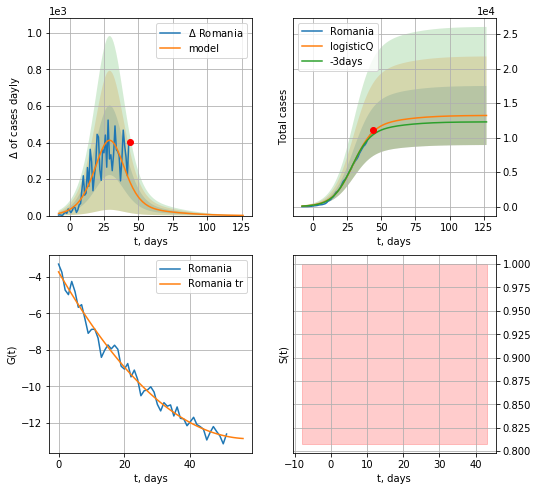

Romania data at: 2020-04-26
+3 day model MAPE: 0.043113374736541664
model: logisticQ
coeffs:  [ 1.21600470e+04  2.43906059e-06  2.95192560e+01 -5.48853544e+04]
scenario coeffs:  [0.0875, 0.5, 2.2, 1]
rational stdev:  0.32391273138080195
forecast at the end of period: +83 days
	 deltaDaycases:  1
	 total cases:  13207 ± 4278
	 total death:  740 ± 719
trend coefficient of determination: 0.983413
 intercept_: -3.7255555135726013
 coeffs_: [ 0.         -0.31583538  0.00272466]


In [291]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,16*7-dT,addpred=True,xcoef=[0.35/4,.5,2.2,1])

In [292]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date   cases  active    death
74 2020-04-22  910416  486768  90191.0
75 2020-04-23  923904  484893  92491.0
76 2020-04-24  942909  485986  94668.0
77 2020-04-25  957003  489973  96532.0
78 2020-04-26  968497  470100  97780.0


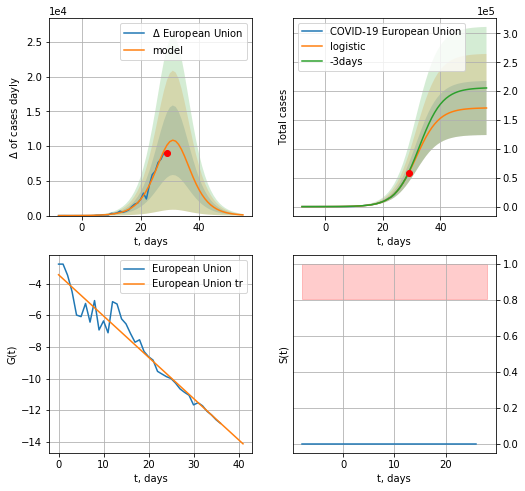

European Union data at: 2020-04-26
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +27 days
	 deltaDaycases:  100
	 total cases:  170859 ± 46835
	 total death:  17250 ± 14185
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


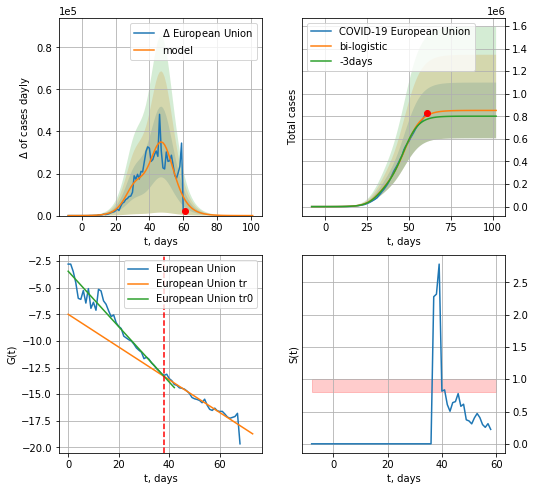

European Union data at: 2020-04-26
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +41 days
	 deltaDaycases:  2
	 total cases:  851742 ± 246597
	 total death:  85992 ± 74689
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


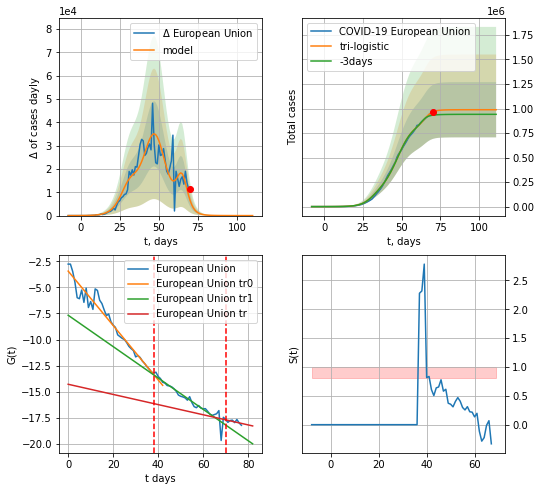

European Union data at: 2020-04-26
+3 day model MAPE: 0.03944887904235329
model: tri-logistic
coeffs:  [1.36084952e+05 4.24100269e-01 6.52700098e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.28493222885800557
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  987837 ± 281466
	 total death:  99732 ± 85250
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.370487
 intercept: -14.285609
 slope: -0.048683


In [294]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


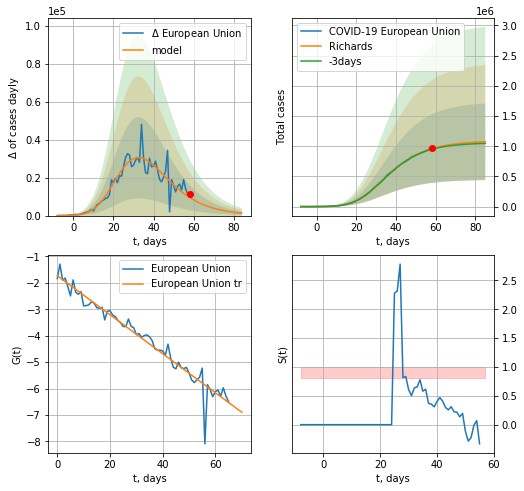

European Union data at: 2020-04-26
+3 day model MAPE: 0.011633454611395515
model: Richards
coeffs:  [1.08876689e+06 5.46382865e-01 9.86998567e+00 1.50157386e-01]
rational stdev:  0.5907670137001125
forecast at the end of period: +27 days
	 deltaDaycases:  1282
	 total cases:  1073633 ± 634267
	 total death:  108394 ± 192106
trend coefficient of determination: 0.945388
 intercept: -1.727823
 slope: -0.073831


In [295]:
x = forecastRR("European Union",dfEU[12:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


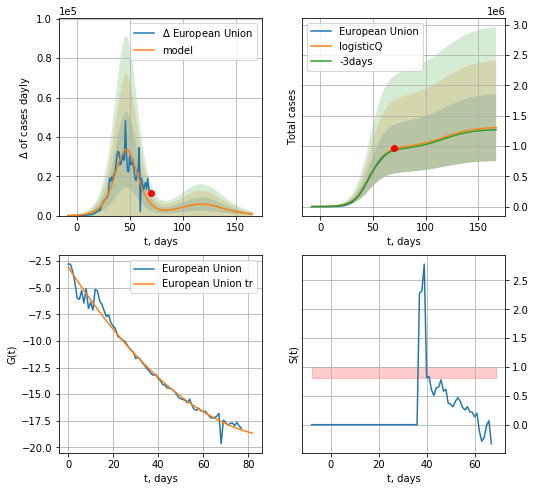

European Union data at: 2020-04-26
+3 day model MAPE: 0.023455173041203998
model: logisticQ
coeffs:  [ 9.74206963e+05  1.85443728e-06  4.71643687e+01 -7.38424229e+04]
scenario coeffs:  [0.35, 0.5, 2.5, 1.0]
rational stdev:  0.42441325750803555
forecast at the end of period: +97 days
	 deltaDaycases:  778
	 total cases:  1303828 ± 553362
	 total death:  131635 ± 167602
trend coefficient of determination: 0.984801
 intercept_: -3.039062988002504
 coeffs_: [ 0.         -0.32568476  0.00164635]


In [296]:
x = forecastRRR("European Union",dfEU[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,2.5,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app


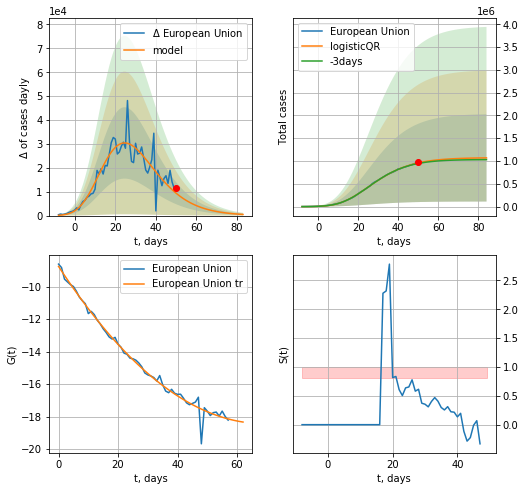

European Union data at: 2020-04-26
+3 day model MAPE: 0.014162652519271806
model: logisticQR
coeffs:  [ 1.07312777e+06  1.17862839e-02 -3.80973476e+01 -2.39485351e+02
  2.02292599e-02]
rational stdev:  0.8958630841906097
forecast at the end of period: +34 days
	 deltaDaycases:  480
	 total cases:  1068822 ± 957518
	 total death:  107908 ± 290012
trend coefficient of determination: 0.986578
 intercept_: -8.76328261460862
 coeffs_: [ 0.         -0.28033053  0.00203139]


In [297]:
x = forecastQR("European Union",dfEU[20:],d1,9*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [390]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [463]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [391]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [253]:
#dfIC[:]

IC
          date   cases  active  death
52 2020-04-22  1785.0     313   10.0
53 2020-04-23  1789.0     270   10.0
54 2020-04-24  1789.5     237   10.0
55 2020-04-25  1790.0     210   10.0
56 2020-04-26  1792.0     174   10.0


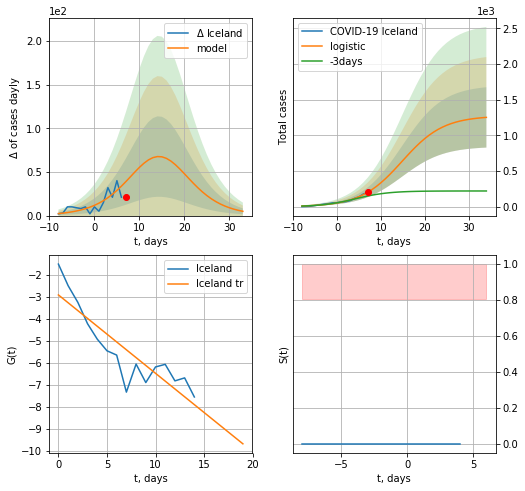

Iceland data at: 2020-04-26
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +27 days
	 deltaDaycases:  4
	 total cases:  1250 ± 422
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


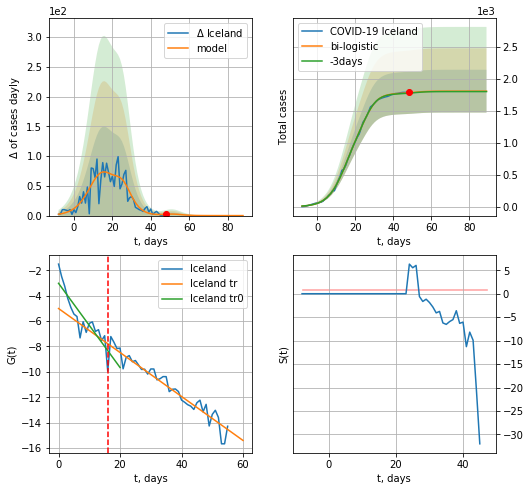

Iceland data at: 2020-04-26
+3 day model MAPE: 0.0032592767447170356
model: bi-logistic
coeffs:  [5.04877201e+02 3.05463013e-01 2.58755832e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.18546910396589208
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1808 ± 335
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.910419
 intercept: -5.005341
 slope: -0.173375


In [298]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


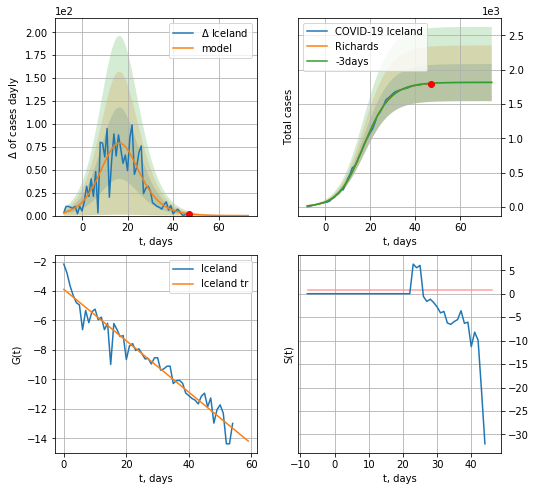

Iceland data at: 2020-04-26
+3 day model MAPE: 0.0017738006282452925
model: Richards
coeffs:  [1.81176610e+03 2.00167823e-01 1.57340255e+01 8.26112602e-01]
rational stdev:  0.14936049598096945
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1811 ± 270
	 total death:  10 ± 4
trend coefficient of determination: 0.941672
 intercept: -3.889270
 slope: -0.174509


In [299]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


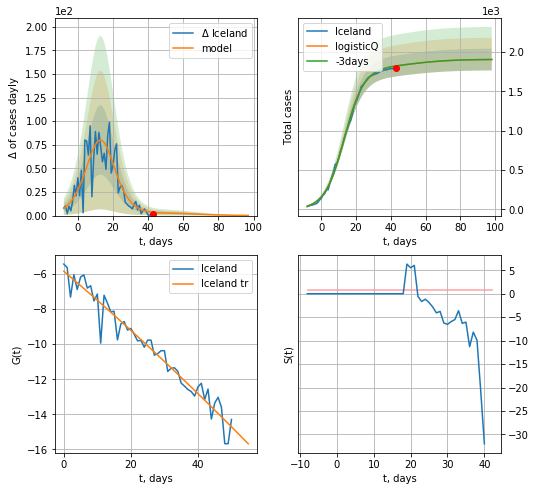

Iceland data at: 2020-04-26
+3 day model MAPE: 0.00011253570902854836
model: logisticQ
coeffs:  [ 1.80229546e+03  9.64743200e-06  1.33224856e+01 -1.83587795e+04]
scenario coeffs:  [0.05833333333333333, 0.5, 4.0, 1.0]
rational stdev:  0.07257367815455941
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  1905 ± 138
	 total death:  10 ± 2
trend coefficient of determination: 0.948697
 intercept_: -5.847331811744781
 coeffs_: [ 0.         -0.16261523 -0.00029362]


In [418]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=True,xcoef=[0.35/6,.5,4.,1.])

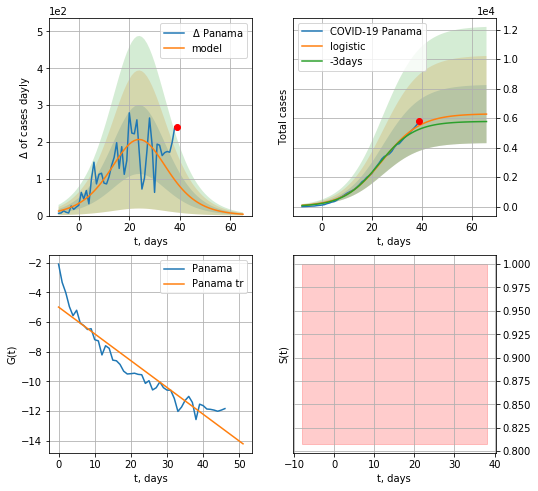

Panama data at: 2020-04-26
+3 day model MAPE: 0.051716050720506807
model: logistic
coeffs:  [6.29908550e+03 1.31290683e-01 2.43464143e+01]
rational stdev:  0.3141981769449225
forecast at the end of period: +27 days
	 deltaDaycases:  3
	 total cases:  6272 ± 1970
	 total death:  179 ± 168
trend coefficient of determination: 0.896181
 intercept: -4.994529
 slope: -0.180750


In [301]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


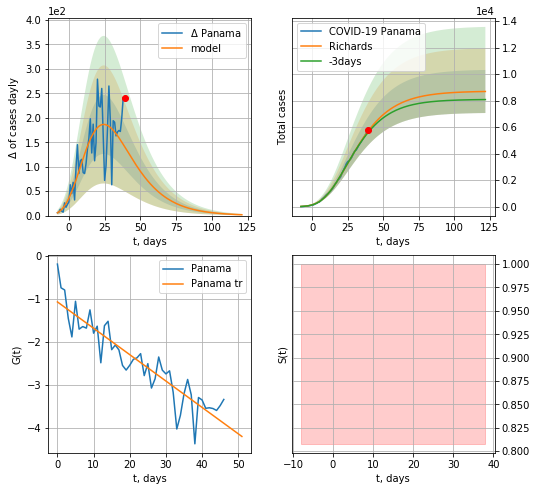

Panama data at: 2020-04-26
+3 day model MAPE: 0.019389136049932077
model: Richards
coeffs:  [ 8.71569004e+03  3.02267339e+00 -4.22455673e+01  1.94277029e-02]
rational stdev:  0.18695192497807048
forecast at the end of period: +83 days
	 deltaDaycases:  1
	 total cases:  8686 ± 1623
	 total death:  248 ± 139
trend coefficient of determination: 0.835073
 intercept: -1.072533
 slope: -0.061477


In [302]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


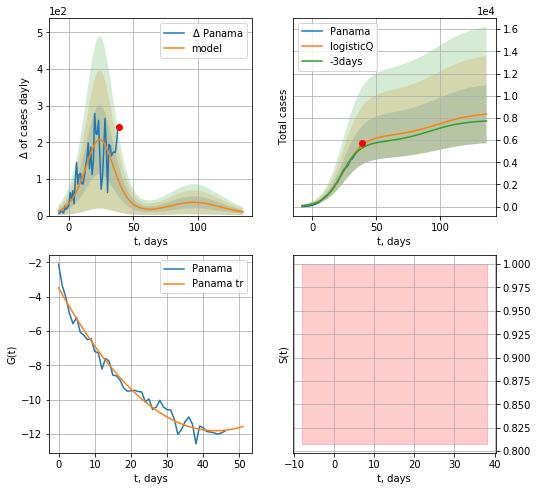

Panama data at: 2020-04-26
+3 day model MAPE: 0.05077272048102171
model: logisticQ
coeffs:  [ 6.29719690e+03  2.54398687e-06  2.43417547e+01 -5.15944672e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.3142881836094637
forecast at the end of period: +97 days
	 deltaDaycases:  10
	 total cases:  8340 ± 2621
	 total death:  238 ± 224
trend coefficient of determination: 0.975102
 intercept_: -3.4740444011535345
 coeffs_: [ 0.         -0.38357251  0.00441016]


In [303]:
x = forecastRRR("Panama",dfPM[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

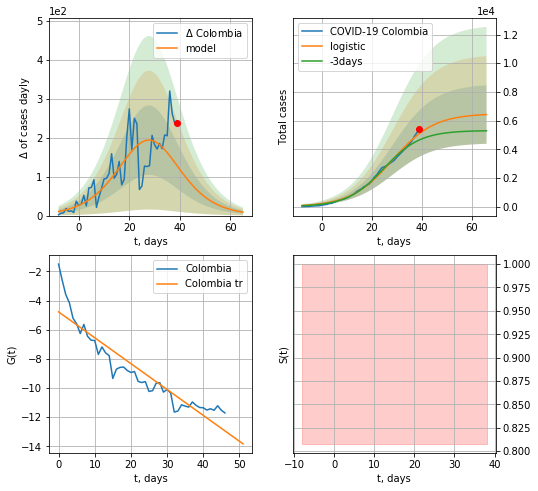

Colombia data at: 2020-04-26
+3 day model MAPE: 0.10404121250357631
model: logistic
coeffs:  [6.48998250e+03 1.19543231e-01 2.82641548e+01]
rational stdev:  0.31731594778523053
forecast at the end of period: +27 days
	 deltaDaycases:  8
	 total cases:  6419 ± 2036
	 total death:  291 ± 277
trend coefficient of determination: 0.866067
 intercept: -4.780576
 slope: -0.177431


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


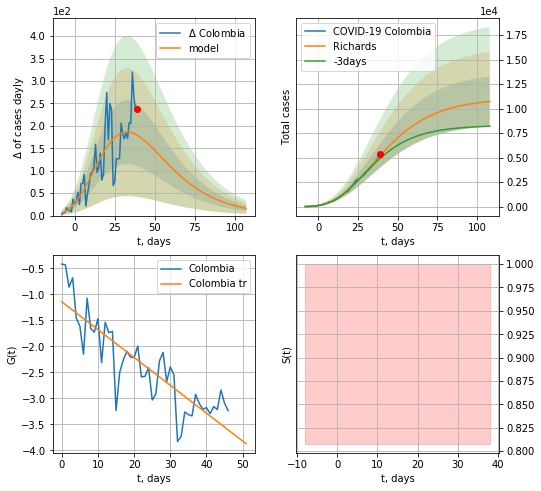

Colombia data at: 2020-04-26
+3 day model MAPE: 0.0604555628324781
model: Richards
coeffs:  [ 1.10728679e+04  3.48931442e+00 -6.09082722e+01  1.31955326e-02]
rational stdev:  0.23634449270254962
forecast at the end of period: +69 days
	 deltaDaycases:  16
	 total cases:  10726 ± 2535
	 total death:  486 ± 344
trend coefficient of determination: 0.736941
 intercept: -1.143839
 slope: -0.053496


In [304]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


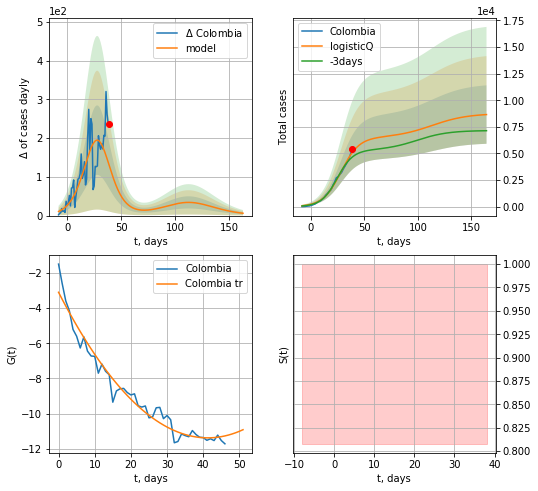

Colombia data at: 2020-04-26
+3 day model MAPE: 0.10272255033669347
model: logisticQ
coeffs:  [ 6.48533319e+03  3.62569381e-06  2.82516534e+01 -3.29573269e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.3174322668908467
forecast at the end of period: +125 days
	 deltaDaycases:  5
	 total cases:  8653 ± 2746
	 total death:  392 ± 373
trend coefficient of determination: 0.962215
 intercept_: -3.1044097148498135
 coeffs_: [ 0.         -0.4010161   0.00486154]


In [306]:
x = forecastRRR("Colombia",dfCB[:],d1,22*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

AR
          date   cases  active  death
49 2020-04-22  2910.0  1304.0  402.0
50 2020-04-23  3007.0  1245.0  407.0
51 2020-04-24  3127.0  1304.0  415.0
52 2020-04-25  3256.0  1358.0  419.0
53 2020-04-26  3382.0  1449.0  425.0


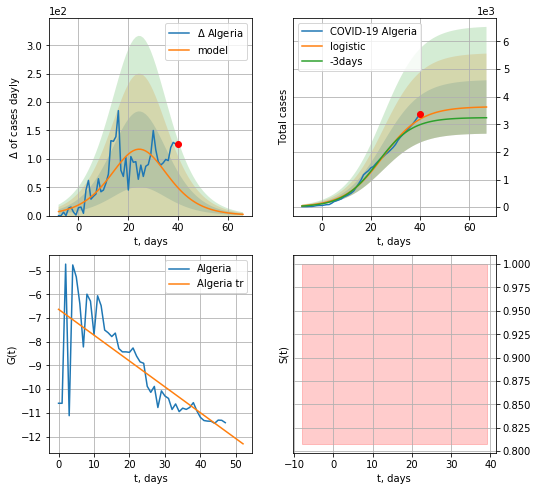

Algeria data at: 2020-04-26
+3 day model MAPE: 0.0719155399522265
model: logistic
coeffs:  [3.63852655e+03 1.28732550e-01 2.48553026e+01]
rational stdev:  0.2666851610950643
forecast at the end of period: +27 days
	 deltaDaycases:  2
	 total cases:  3622 ± 966
	 total death:  455 ± 364
trend coefficient of determination: 0.582139
 intercept: -6.634557
 slope: -0.109107


In [307]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


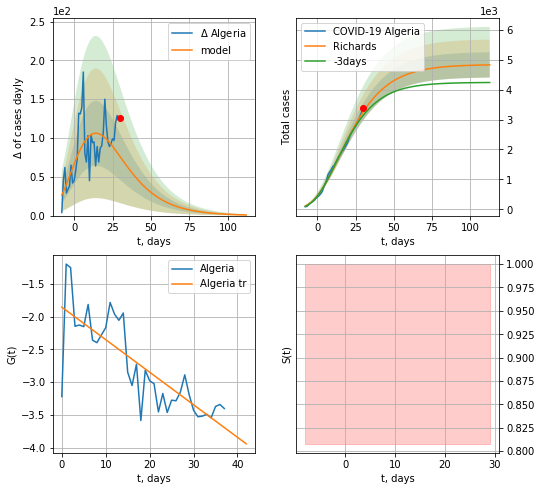

Algeria data at: 2020-04-26
+3 day model MAPE: 0.04197163238014146
model: Richards
coeffs:  [ 4.84313600e+03  4.30422671e+00 -5.66190346e+01  1.39421231e-02]
rational stdev:  0.08764872713775555
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  4829 ± 423
	 total death:  606 ± 159
trend coefficient of determination: 0.647945
 intercept: -1.853821
 slope: -0.049737


In [309]:
x = forecastRR("Algeria",dfAR[15:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


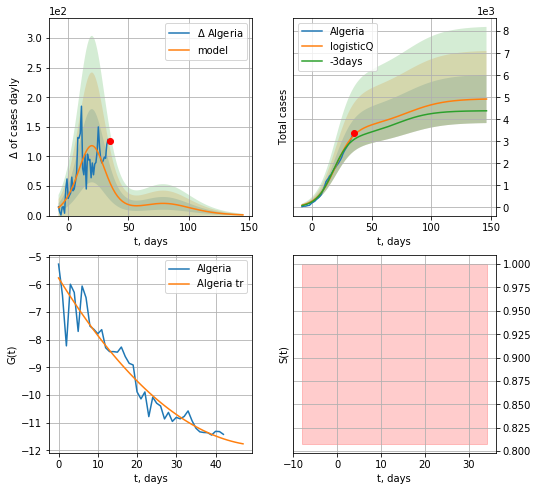

Algeria data at: 2020-04-26
+3 day model MAPE: 0.06581805433461191
model: logisticQ
coeffs:  [ 3.65922949e+03  2.18721315e-06  1.99659665e+01 -5.82615333e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.2217298715216273
forecast at the end of period: +111 days
	 deltaDaycases:  1
	 total cases:  4921 ± 1091
	 total death:  618 ± 411
trend coefficient of determination: 0.927796
 intercept_: -5.769876960233649
 coeffs_: [ 0.         -0.22934798  0.00216862]


In [314]:
x = forecastRRR("Algeria",dfAR[10:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

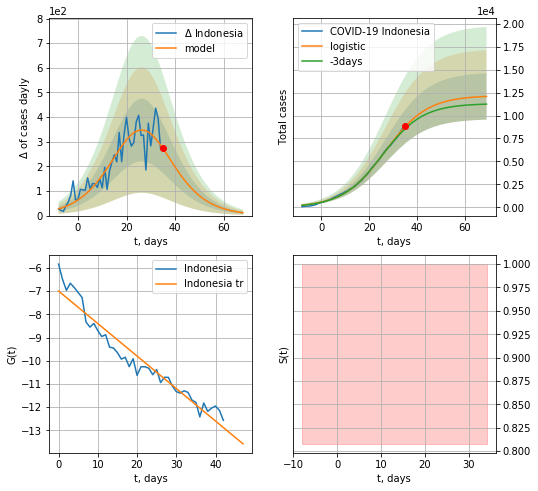

Indonesia data at: 2020-04-26
+3 day model MAPE: 0.029298527525670925
model: logistic
coeffs:  [1.21854586e+04 1.14080106e-01 2.67060759e+01]
rational stdev:  0.20914210247064074
forecast at the end of period: +34 days
	 deltaDaycases:  11
	 total cases:  12088 ± 2528
	 total death:  1011 ± 634
trend coefficient of determination: 0.934878
 intercept: -6.993068
 slope: -0.140101


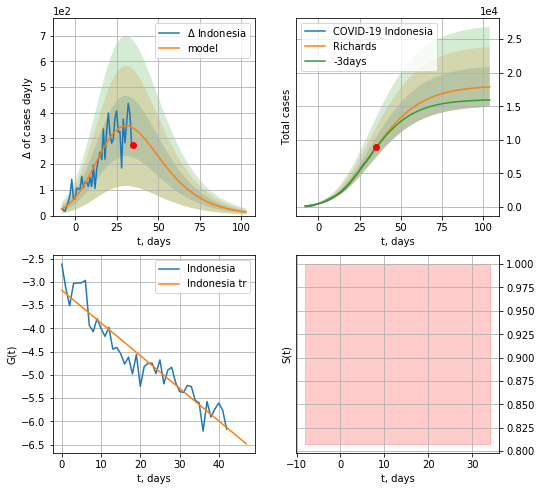

Indonesia data at: 2020-04-26
+3 day model MAPE: 0.01075662637223441
model: Richards
coeffs:  [1.81163127e+04 2.02323101e-01 1.07652230e+01 2.96002336e-01]
rational stdev:  0.1663781268189799
forecast at the end of period: +69 days
	 deltaDaycases:  13
	 total cases:  17888 ± 2976
	 total death:  1496 ± 746
trend coefficient of determination: 0.895250
 intercept: -3.181563
 slope: -0.070187


In [315]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


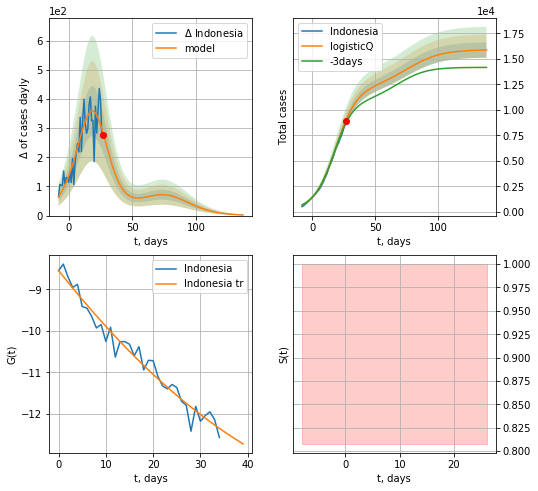

Indonesia data at: 2020-04-26
+3 day model MAPE: 0.03346257556367822
model: logisticQ
coeffs:  [ 1.17729747e+04  3.34519239e-04  1.81541868e+01 -3.37429764e+02]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.047647927340781035
forecast at the end of period: +111 days
	 deltaDaycases:  2
	 total cases:  15870 ± 756
	 total death:  1327 ± 189
trend coefficient of determination: 0.965649
 intercept_: -8.541275384485337
 coeffs_: [ 0.         -0.14435923  0.00095398]


In [317]:
x = forecastRRR("Indonesia",dfIE[13:],d1,20*7-dT,addpred=True,xcoef=[.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


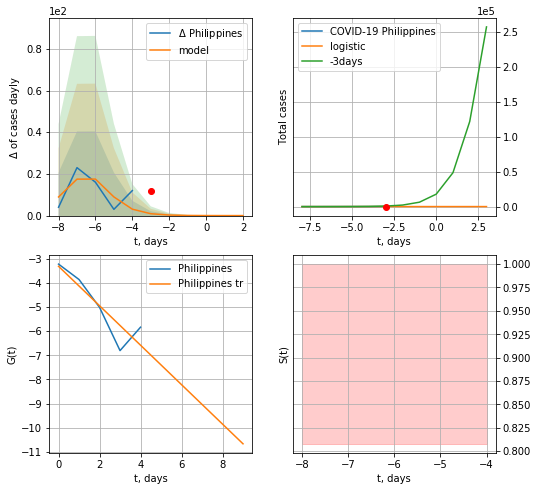

Philippines data at: 2020-04-26
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


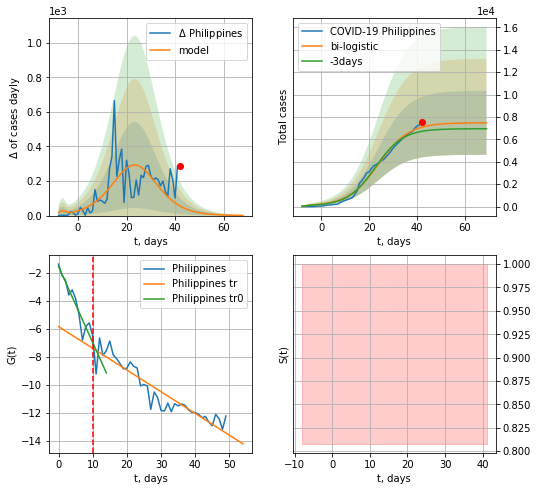

Philippines data at: 2020-04-26
+3 day model MAPE: 0.05750050834869846
model: bi-logistic
coeffs:  [7.42605385e+03 1.57890982e-01 2.38336984e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.38147120929051215
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  7481 ± 2854
	 total death:  494 ± 565
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.868537
 intercept: -5.840231
 slope: -0.154798


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:303: RuntimeWarning: overflow encountered in exp


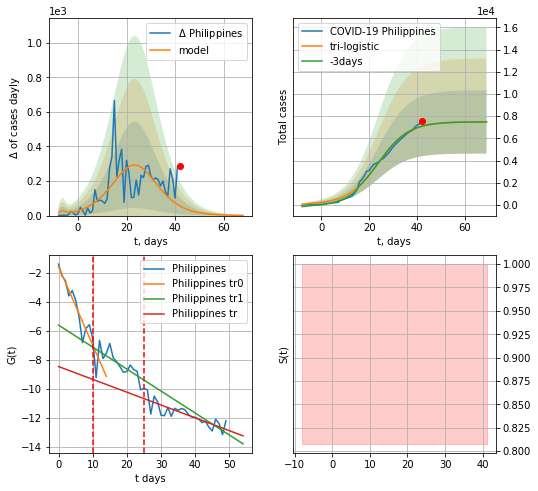

Philippines data at: 2020-04-26
+3 day model MAPE: 1.4513080582150725e-14
model: tri-logistic
coeffs:  [ 1.20307971  1.38559113 59.72549804] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  7.42605385e+03
  1.57890982e-01  2.38336984e+01]
forecast rational stdev:  0.38147120929051204
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  7482 ± 2854
	 total death:  494 ± 565
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.695686
 intercept: -8.462311
 slope: -0.088625


In [318]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,5*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


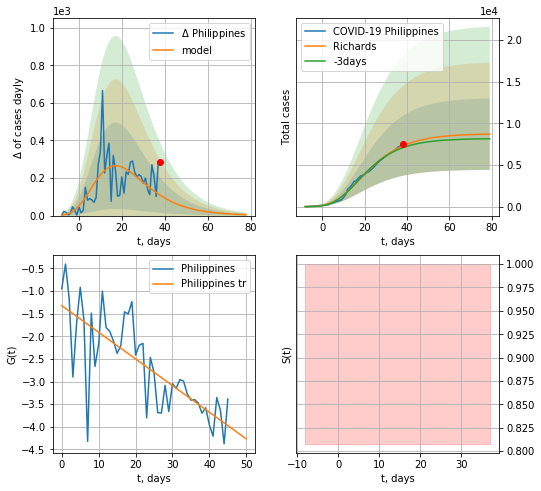

Philippines data at: 2020-04-26
+3 day model MAPE: 0.03321474315285613
model: Richards
coeffs:  [ 8.76163903e+03  6.83321120e+00 -3.56404362e+01  1.21374682e-02]
rational stdev:  0.4929924563253424
forecast at the end of period: +41 days
	 deltaDaycases:  4
	 total cases:  8708 ± 4293
	 total death:  575 ± 850
trend coefficient of determination: 0.585772
 intercept: -1.322414
 slope: -0.058919


In [319]:
x = forecastRR("Philippines",dfPH[4:],d1,10*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


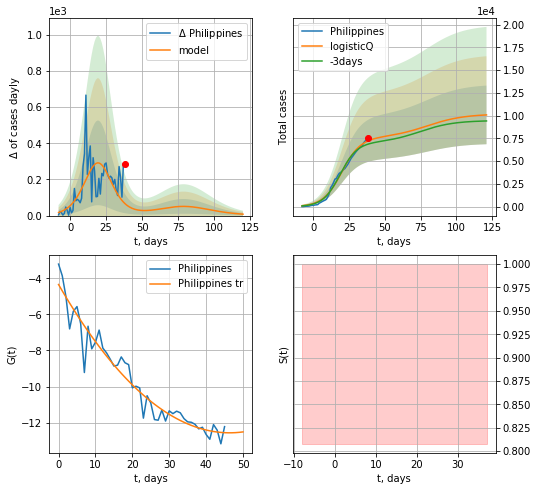

Philippines data at: 2020-04-26
+3 day model MAPE: 0.053857889482597565
model: logisticQ
coeffs:  [ 7.54152075e+03  2.04519861e-06  1.98165018e+01 -7.51215620e+04]
scenario coeffs:  [0.35, 0.5, 4, 1.0]
rational stdev:  0.31970295859753145
forecast at the end of period: +83 days
	 deltaDaycases:  7
	 total cases:  10078 ± 3222
	 total death:  666 ± 638
trend coefficient of determination: 0.936295
 intercept_: -4.3484723787983945
 coeffs_: [ 0.         -0.35395386  0.00381616]


In [320]:
x = forecastRRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=True,xcoef=[0.35,0.5,4,1.])

GC
          date  cases  active  death
53 2020-04-22   2408    1710  121.0
54 2020-04-23   2463    1761  125.0
55 2020-04-24   2490    1783  130.0
56 2020-04-25   2506    1799  130.0
57 2020-04-26   2517    1806  134.0


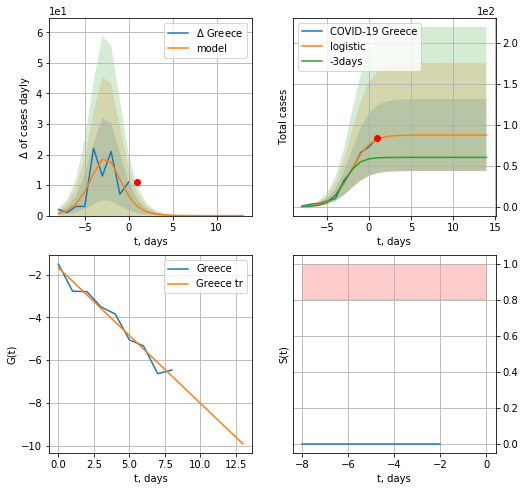

Greece data at: 2020-04-26
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


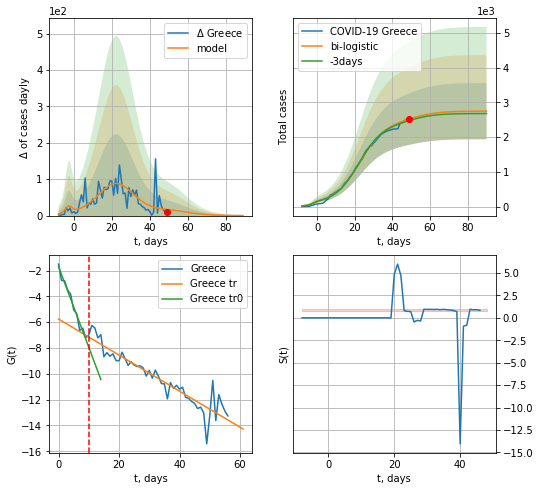

Greece data at: 2020-04-26
+3 day model MAPE: 0.01747923584653562
model: bi-logistic
coeffs:  [2.36634187e+03 1.48765552e-01 2.26621028e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.294126209431957
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  2748 ± 808
	 total death:  146 ± 128
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.867440
 intercept: -5.757056
 slope: -0.139646


In [321]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

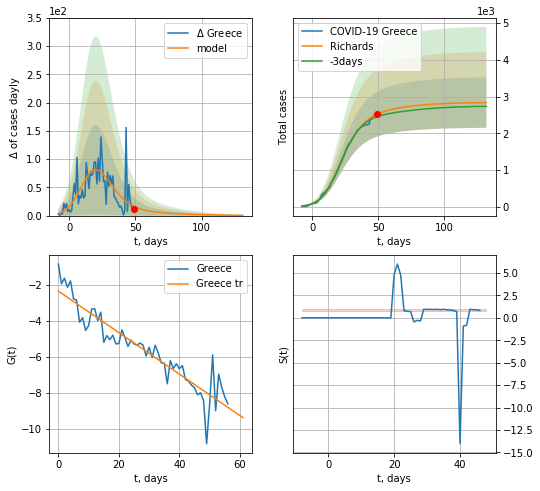

Greece data at: 2020-04-26
+3 day model MAPE: 0.029161720149514986
model: Richards
coeffs:  [2.61543159e+03 2.46271247e-01 1.15622673e+01 4.06122691e-01]
scenario coeffs:  [0.0875, 0.5, 4, 1]
rational stdev:  0.24235044917617882
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  2836 ± 687
	 total death:  151 ± 109
trend coefficient of determination: 0.862336
 intercept: -2.355251
 slope: -0.115288


In [323]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=True,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


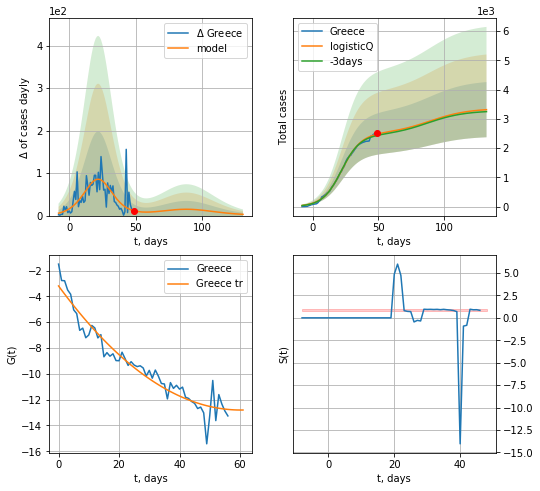

Greece data at: 2020-04-26
+3 day model MAPE: 0.018660227924734766
model: logisticQ
coeffs:  [ 2.48543825e+03  2.51563845e-06  2.22309155e+01 -5.44029326e+04]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.28453114162972604
forecast at the end of period: +83 days
	 deltaDaycases:  2
	 total cases:  3312 ± 942
	 total death:  176 ± 150
trend coefficient of determination: 0.928406
 intercept_: -3.1966429770636644
 coeffs_: [ 0.         -0.31912443  0.00264907]


In [324]:
x = forecastRRR("Greece",dfGC[:],d1,16*7-dT,addpred=True,xcoef=[.35,.5,4,1])

HG
          date  cases  active  death
47 2020-04-22   2168    1648  225.0
48 2020-04-23   2284    1655  239.0
49 2020-04-24   2383    1732  250.0
50 2020-04-25   2443    1723  262.0
51 2020-04-26   2583    1805  280.0


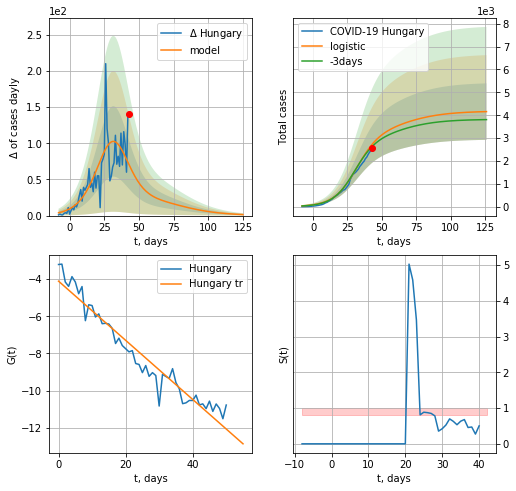

Hungary data at: 2020-04-26
+3 day model MAPE: 0.03947303479413793
model: logistic
coeffs:  [3.09633865e+03 1.23006354e-01 3.15351748e+01]
scenario coeffs:  [0.35, 0.5, 2, 1]
rational stdev:  0.2969800857283178
forecast at the end of period: +83 days
	 deltaDaycases:  1
	 total cases:  4157 ± 1234
	 total death:  450 ± 400
trend coefficient of determination: 0.937731
 intercept: -4.115101
 slope: -0.158927


In [326]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,16*7-dT,addpred=True,xcoef=[.35,.5,2,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


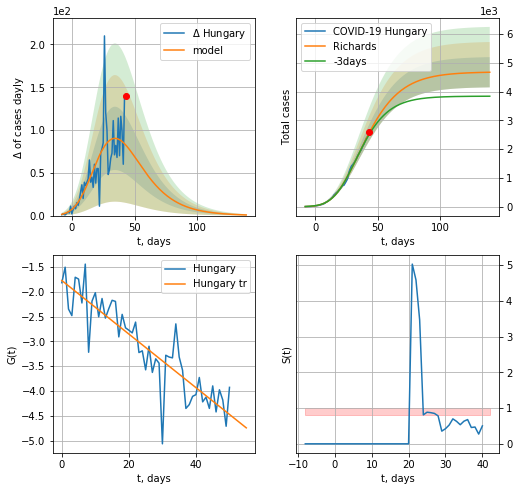

Hungary data at: 2020-04-26
+3 day model MAPE: 0.024730799227533167
model: Richards
coeffs:  [ 4.68224150e+03  4.32665656e-01 -1.90994640e+00  1.28850374e-01]
rational stdev:  0.11238902566853866
forecast at the end of period: +97 days
	 deltaDaycases:  0
	 total cases:  4668 ± 524
	 total death:  506 ± 170
trend coefficient of determination: 0.781394
 intercept: -1.772151
 slope: -0.054033


In [328]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


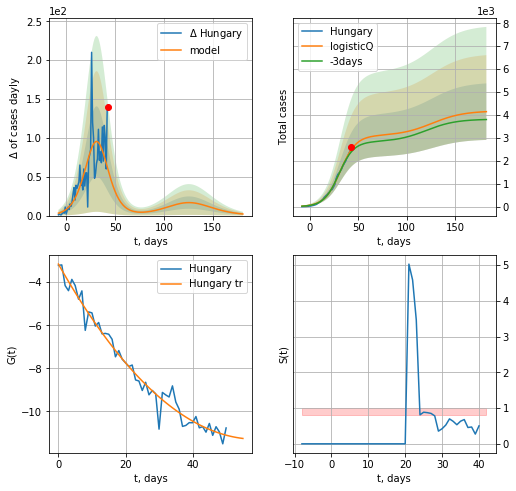

Hungary data at: 2020-04-26
+3 day model MAPE: 0.04470666619365726
model: logisticQ
coeffs:  [ 3.09403160e+03  4.28762828e-06  3.15225425e+01 -2.86749493e+04]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.29727547199466664
forecast at the end of period: +139 days
	 deltaDaycases:  2
	 total cases:  4143 ± 1231
	 total death:  449 ± 400
trend coefficient of determination: 0.973057
 intercept_: -3.1614030909696247
 coeffs_: [ 0.         -0.27575736  0.00233712]


In [330]:
x = forecastRRR("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1],cases='cases')

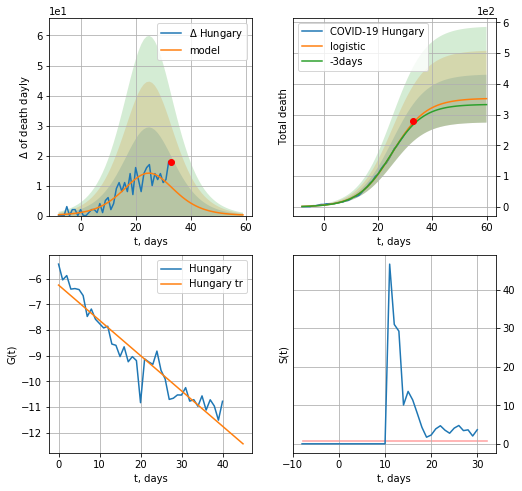

Hungary data at: 2020-04-26
+3 day model MAPE: 0.02619637762652382
model: logistic
coeffs:  [3.53247092e+02 1.60366649e-01 2.52924600e+01]
rational stdev:  0.22096169741217087
forecast at the end of period: +27 days
	 total death:  351 ± 77
trend coefficient of determination: 0.911878
 intercept: -6.242524
 slope: -0.137491


In [331]:
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
45 2020-04-22  444.0     276    3.0
46 2020-04-23  445.0     238    3.0
47 2020-04-24  447.0     220    4.0
48 2020-04-25  448.0     195    4.0
49 2020-04-26  448.1     162    4.0


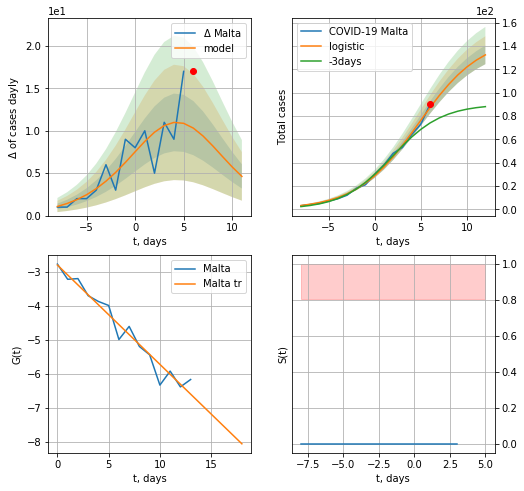

Malta data at: 2020-04-26
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  132 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


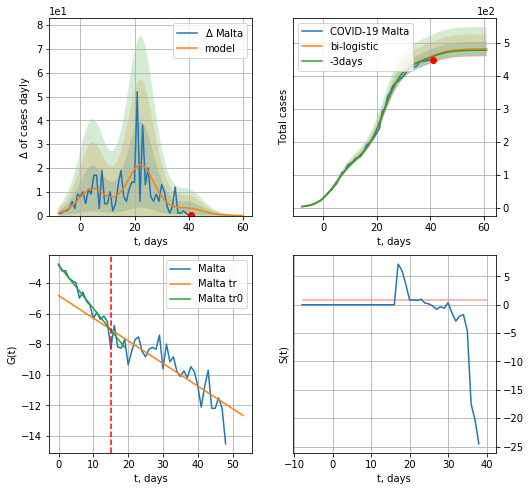

Malta data at: 2020-04-26
+3 day model MAPE: 0.006334793002302591
model: bi-logistic
coeffs:  [2.97036897e+02 2.85465478e-01 2.27859155e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04622865060739282
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  481 ± 22
	 total death:  4 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.725380
 intercept: -4.825969
 slope: -0.147879


In [334]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,5*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


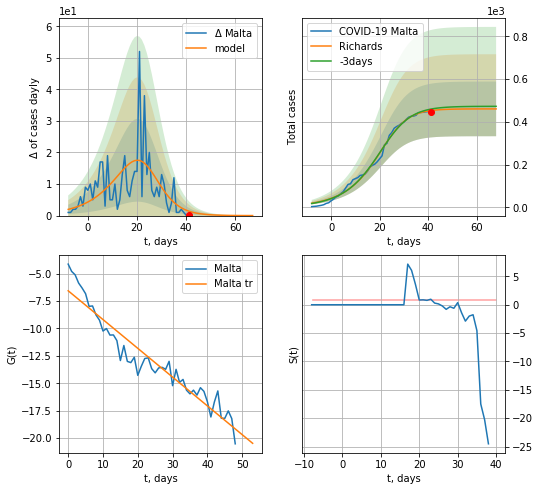

Malta data at: 2020-04-26
+3 day model MAPE: 0.016228736709380465
model: Richards
coeffs:  [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev:  0.2778650791671781
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  460 ± 128
	 total death:  4 ± 3
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


In [335]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


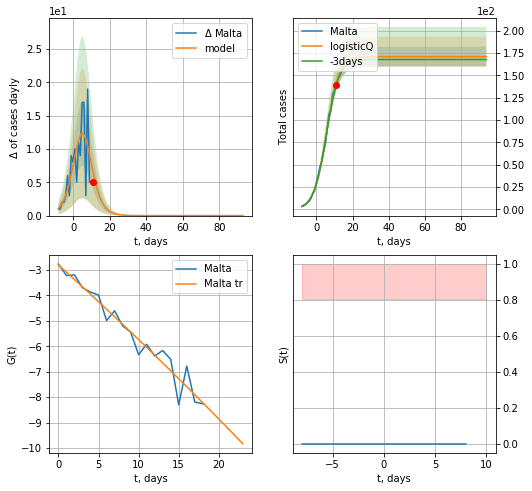

Malta data at: 2020-04-26
+3 day model MAPE: 0.01737170468117802
model: logisticQ
coeffs:  [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev:  0.06489210631410353
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  170 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


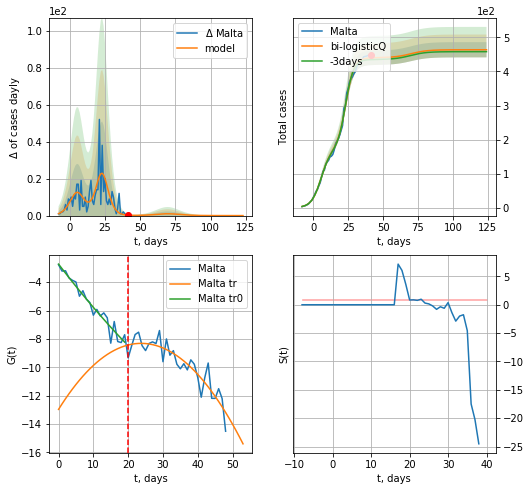

Malta data at: 2020-04-26
+3 day model MAPE: 0.011596399510282364
model: bi-logisticQ
coeffs:  [ 2.69403933e+02  4.21850712e-06  2.33027404e+01 -7.98651623e+04] [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
scenario coeffs:  [0.0875, 0.5, 3, 1.0]
rational stdev:  0.04824637930021915
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  463 ± 22
	 total death:  4 ± 0
bi-logistic approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.819673
 intercept_: -12.971071749783743
 coeffs_: [ 0.          0.39237638 -0.00826784]


In [415]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,4,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.35/4,.5,3,1.],vL=20)

SL
          date  cases  active  death
43 2020-04-22   1244   946.0   14.0
44 2020-04-23   1325  1022.0   15.0
45 2020-04-24   1360   988.0   17.0
46 2020-04-25   1373   970.0   17.0
47 2020-04-26   1379   967.0   18.0


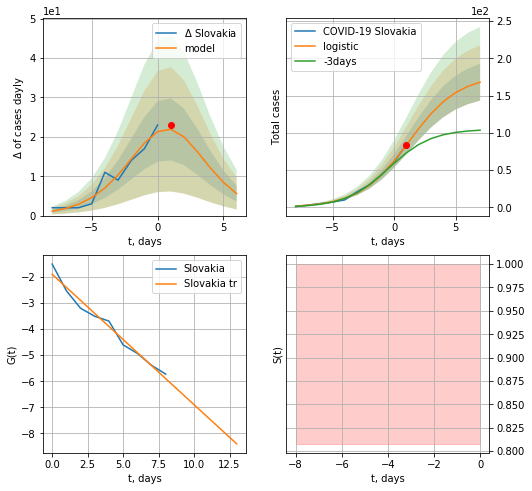

Slovakia data at: 2020-04-26
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +6 days
	 deltaDaycases:  5
	 total cases:  167 ± 24
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


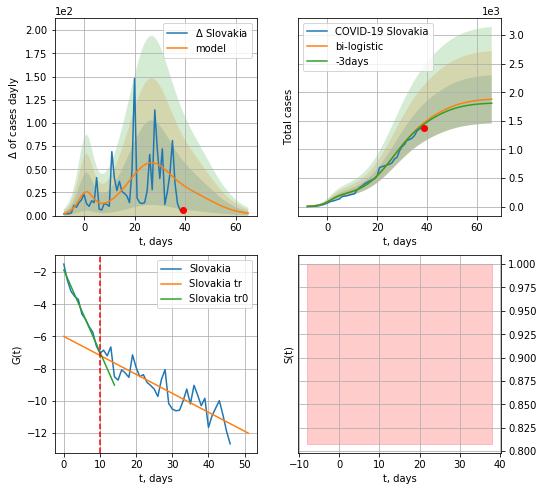

Slovakia data at: 2020-04-26
+3 day model MAPE: 0.017922292333032018
model: bi-logistic
coeffs:  [1.37353609e+03 1.58792949e-01 2.66593818e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.22446660810398095
forecast at the end of period: +27 days
	 deltaDaycases:  2
	 total cases:  1879 ± 421
	 total death:  24 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.771594
 intercept: -5.995711
 slope: -0.117816


In [340]:
dfSL = read_df(pd.DataFrame(),"SL")
x = forecast("Slovakia",dfSL[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


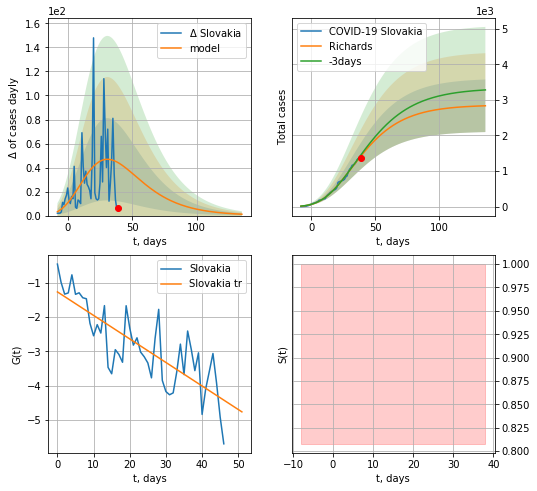

Slovakia data at: 2020-04-26
+3 day model MAPE: 0.02414526039355363
model: Richards
coeffs:  [ 2.85795852e+03  1.22103333e+00 -4.12428591e+01  3.72058530e-02]
rational stdev:  0.2606590725837574
forecast at the end of period: +97 days
	 deltaDaycases:  1
	 total cases:  2833 ± 738
	 total death:  36 ± 28
trend coefficient of determination: 0.645251
 intercept: -1.259591
 slope: -0.068853


In [341]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


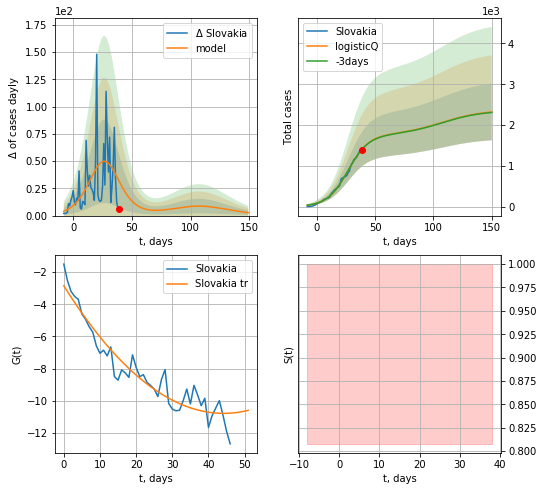

Slovakia data at: 2020-04-26
+3 day model MAPE: 0.003406391805972532
model: logisticQ
coeffs:  [ 1.75655712e+03  4.13671710e-06  2.68740013e+01 -2.72183550e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1.0]
rational stdev:  0.299357818527753
forecast at the end of period: +111 days
	 deltaDaycases:  2
	 total cases:  2320 ± 694
	 total death:  30 ± 26
trend coefficient of determination: 0.908466
 intercept_: -2.850240473931634
 coeffs_: [ 0.         -0.35827257  0.00404928]


In [342]:
x = forecastRRR("Slovakia",dfSL[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1.])

SV
          date  cases  active  death
48 2020-04-22   1353  1069.0   79.0
49 2020-04-23   1366  1076.0   79.0
50 2020-04-24   1373  1082.0   80.0
51 2020-04-25   1388  1088.0   81.0
52 2020-04-26   1396  1093.0   82.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


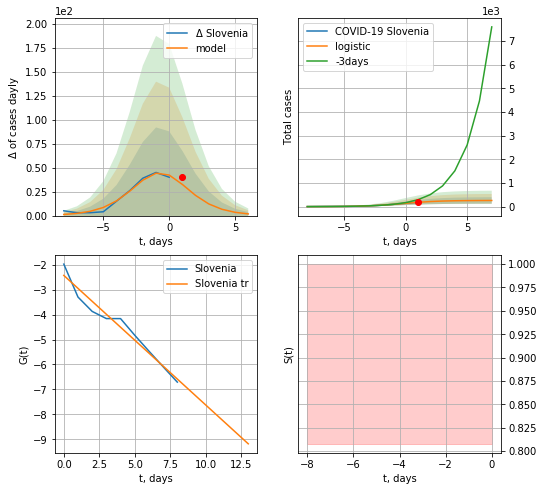

Slovenia data at: 2020-04-26
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  259 ± 137
	 total death:  15 ± 23
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


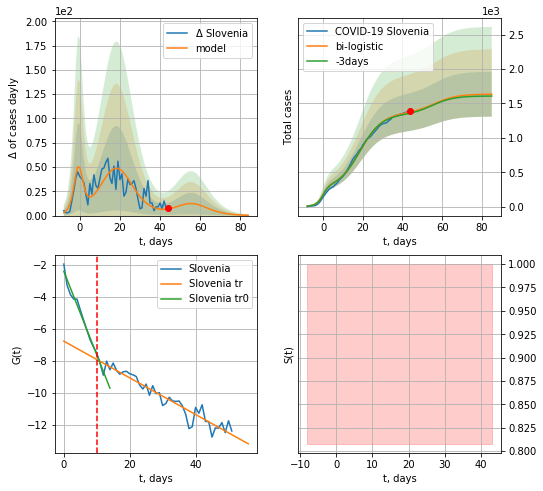

Slovenia data at: 2020-04-26
+3 day model MAPE: 0.012326342429837477
model: bi-logistic
coeffs:  [1.09954082e+03 1.77359353e-01 1.87149299e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.1995554685645973
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1633 ± 326
	 total death:  95 ± 56
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.921808
 intercept: -6.788166
 slope: -0.114552


In [344]:
dfSV = read_df(pd.DataFrame(),"SV")
x = forecast("Slovenia",dfSV[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


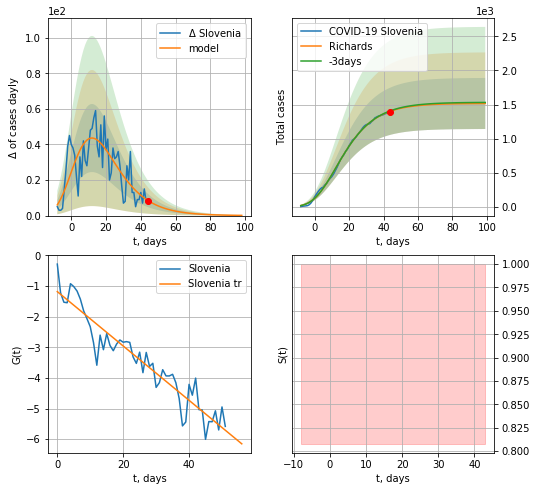

Slovenia data at: 2020-04-26
+3 day model MAPE: 0.004602771260973508
model: Richards
coeffs:  [ 1.51686121e+03  1.38272553e+00 -2.29662534e+01  5.81560608e-02]
rational stdev:  0.24733322951141173
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  1515 ± 374
	 total death:  89 ± 66
trend coefficient of determination: 0.896184
 intercept: -1.184043
 slope: -0.088711


In [345]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


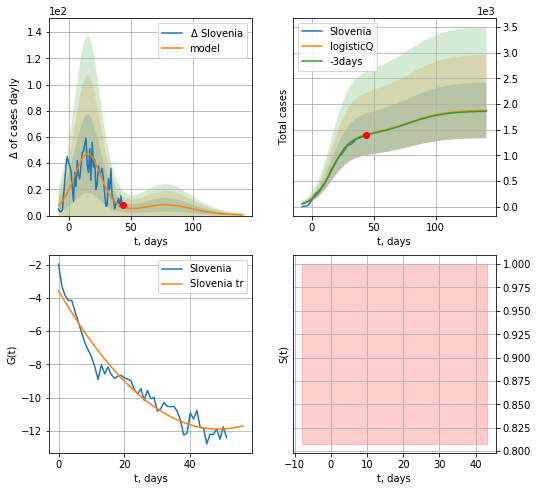

Slovenia data at: 2020-04-26
+3 day model MAPE: 0.008151945501175904
model: logisticQ
coeffs:  [ 1.39487197e+03  1.79164918e-06  1.57563724e+01 -7.50342510e+04]
scenario coeffs:  [0.35, 0.5, 5, 1.0]
rational stdev:  0.2886088960583322
forecast at the end of period: +97 days
	 deltaDaycases:  0
	 total cases:  1875 ± 541
	 total death:  110 ± 95
trend coefficient of determination: 0.945351
 intercept_: -3.571906110683596
 coeffs_: [ 0.         -0.34256727  0.00352429]


In [349]:
x = forecastRRR("Slovenia",dfSV[:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,5,1.])

SB
          date  cases  active  death
43 2020-04-22   7114  5955.0  134.0
44 2020-04-23   7276  6074.0  139.0
45 2020-04-24   7483  6245.0  144.0
46 2020-04-25   7779  6476.0  151.0
47 2020-04-26   8042  6704.0  156.0


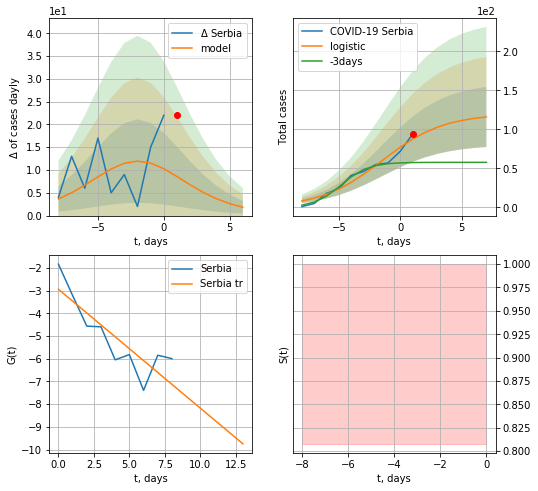

Serbia data at: 2020-04-26
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  115 ± 38
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


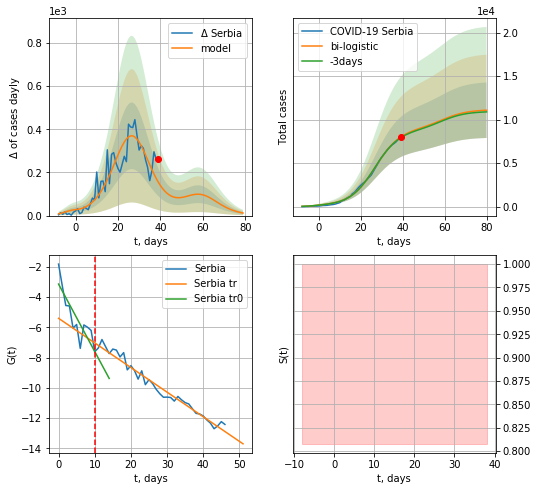

Serbia data at: 2020-04-26
+3 day model MAPE: 0.010596299616188179
model: bi-logistic
coeffs:  [8.82364574e+03 1.67245436e-01 2.69229027e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.28799184498279384
forecast at the end of period: +41 days
	 deltaDaycases:  11
	 total cases:  11081 ± 3191
	 total death:  214 ± 184
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.967982
 intercept: -5.408515
 slope: -0.162410


In [351]:
dfSB = read_df(pd.DataFrame(),"SB")
x = forecast("Serbia",dfSB[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


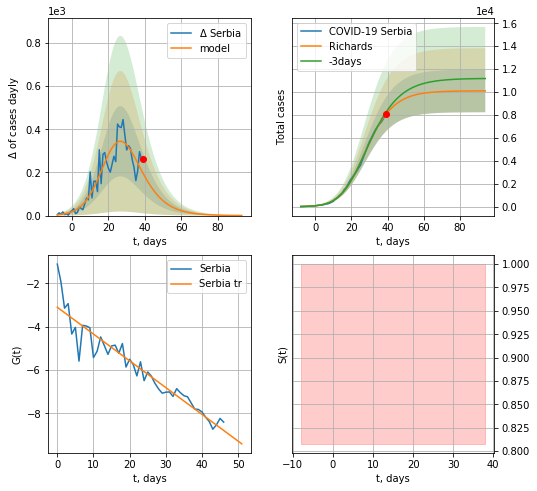

Serbia data at: 2020-04-26
+3 day model MAPE: 0.025425378566089174
model: Richards
coeffs:  [1.01020343e+04 2.12179839e-01 2.19879642e+01 5.53947686e-01]
rational stdev:  0.1843203391945816
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  10098 ± 1861
	 total death:  195 ± 107
trend coefficient of determination: 0.905369
 intercept: -3.105922
 slope: -0.123478


In [352]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


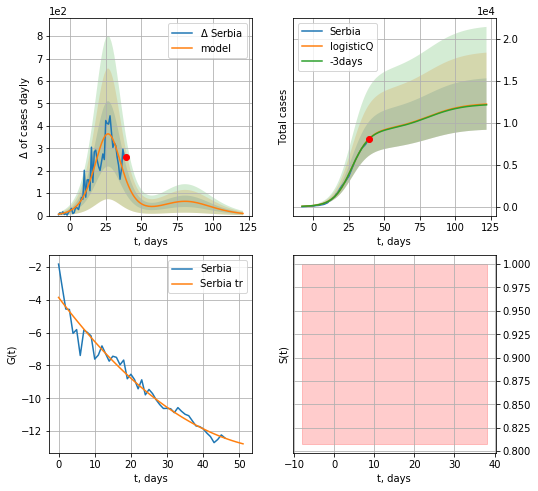

Serbia data at: 2020-04-26
+3 day model MAPE: 0.004304410807485972
model: logisticQ
coeffs:  [ 9.13816512e+03  8.35143652e-06  2.70387651e+01 -1.89230190e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.25084491368827005
forecast at the end of period: +83 days
	 deltaDaycases:  9
	 total cases:  12217 ± 3064
	 total death:  236 ± 177
trend coefficient of determination: 0.956546
 intercept_: -3.858293480783276
 coeffs_: [ 0.         -0.29189154  0.00229747]


In [353]:
x = forecastRRR("Serbia",dfSB[:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

CT
          date  cases  active  death
53 2020-04-22   1950  1033.0   48.0
54 2020-04-23   1981  1048.0   50.0
55 2020-04-24   2009   976.0   51.0
56 2020-04-25   2016   928.0   54.0
57 2020-04-26   2030   872.0   55.0


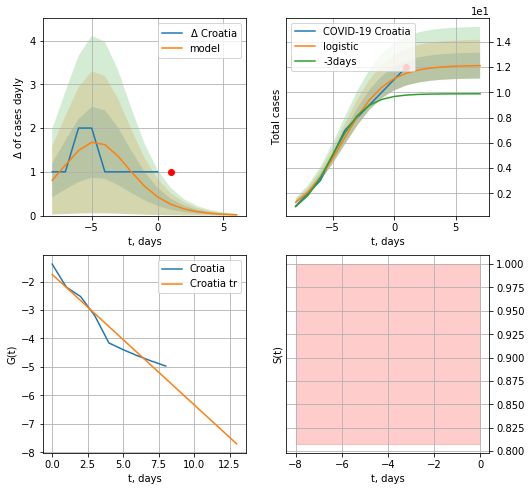

Croatia data at: 2020-04-26
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


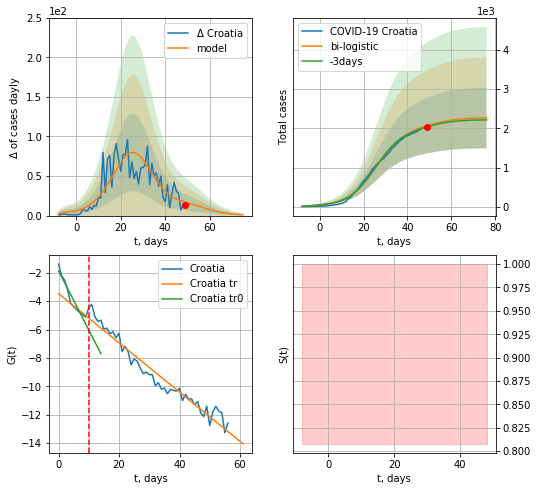

Croatia data at: 2020-04-26
+3 day model MAPE: 0.015658797099247314
model: bi-logistic
coeffs:  [2.00862528e+03 1.57746235e-01 2.58178092e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3421433271116745
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  2265 ± 775
	 total death:  61 ± 62
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.949198
 intercept: -3.464832
 slope: -0.173678


In [354]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,5*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


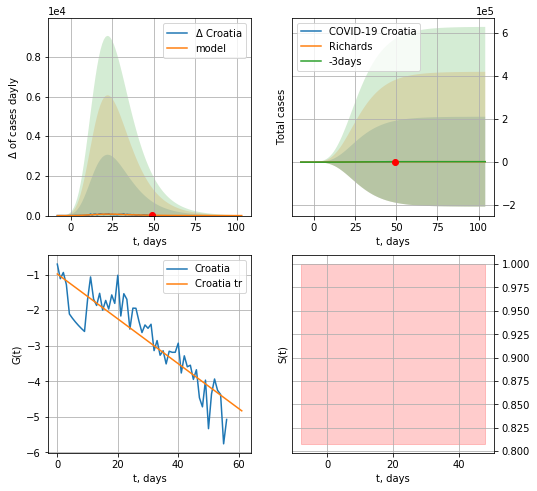

Croatia data at: 2020-04-26
+3 day model MAPE: 0.0024414663285731246
model: Richards
coeffs:  [ 2.23747228e+03  6.80759340e+00 -2.60040348e+01  1.30620367e-02]
rational stdev:  93.38308622048257
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  2235 ± 208789
	 total death:  60 ± 16808
trend coefficient of determination: 0.788370
 intercept: -0.980069
 slope: -0.063173


In [355]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


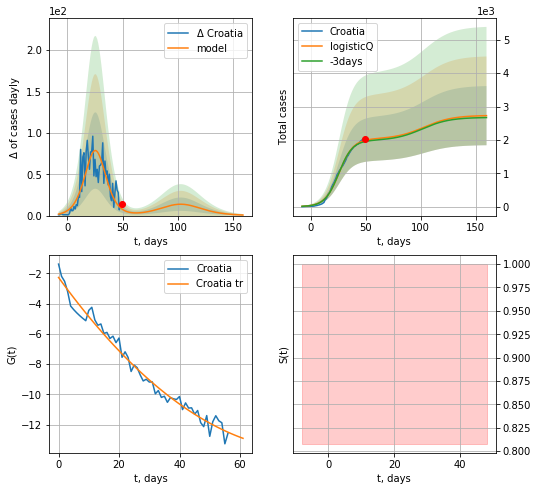

Croatia data at: 2020-04-26
+3 day model MAPE: 0.018509286648544156
model: logisticQ
coeffs:  [ 2.02638756e+03  1.71206773e-06  2.57622718e+01 -9.06474993e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.32511700223868994
forecast at the end of period: +111 days
	 deltaDaycases:  0
	 total cases:  2727 ± 886
	 total death:  73 ± 71
trend coefficient of determination: 0.978215
 intercept_: -2.268367672815595
 coeffs_: [ 0.         -0.27582709  0.00166235]


In [357]:
x = forecastRRR("Croatia",dfCT[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,4.,1])

EG
          date  cases  active  death
47 2020-04-22   3659  2448.0  276.0
48 2020-04-23   3891  2600.0  287.0
49 2020-04-24   4092  2723.0  294.0
50 2020-04-25   4319  2898.0  307.0
51 2020-04-26   4534  3041.0  317.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


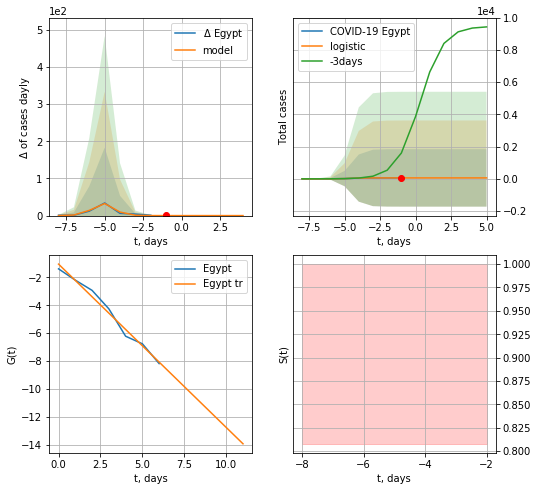

Egypt data at: 2020-04-26
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  4 ± 365
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


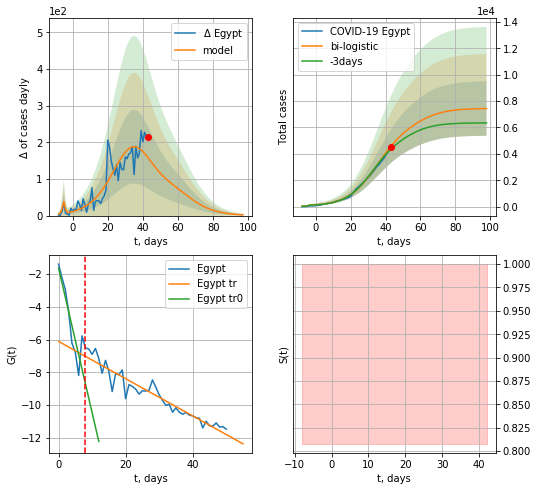

Egypt data at: 2020-04-26
+3 day model MAPE: 0.05578444956259254
model: bi-logistic
coeffs:  [5.91409231e+03 1.21169776e-01 3.47616304e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2775234885279598
forecast at the end of period: +55 days
	 deltaDaycases:  2
	 total cases:  7435 ± 2063
	 total death:  519 ± 432
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.918297
 intercept: -6.107428
 slope: -0.113701


In [358]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,5*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

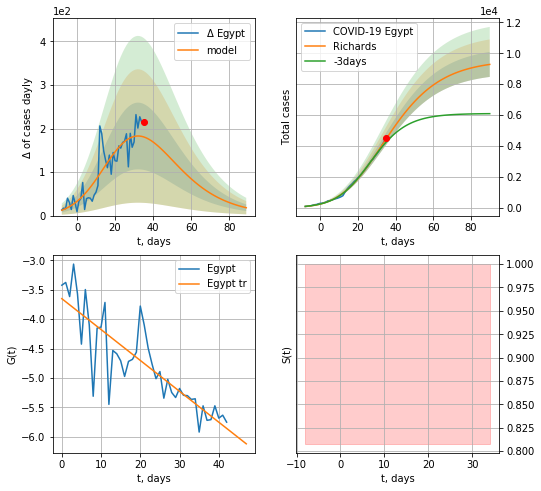

Egypt data at: 2020-04-26
+3 day model MAPE: 0.059758068084035554
model: Richards
coeffs:  [9.57466670e+03 1.87140998e-01 1.36728128e+01 3.20992115e-01]
rational stdev:  0.08723501603941795
forecast at the end of period: +55 days
	 deltaDaycases:  18
	 total cases:  9276 ± 809
	 total death:  648 ± 169
trend coefficient of determination: 0.729377
 intercept: -3.651426
 slope: -0.052510


In [359]:
x = forecastRR("Egypt",dfEG[8:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


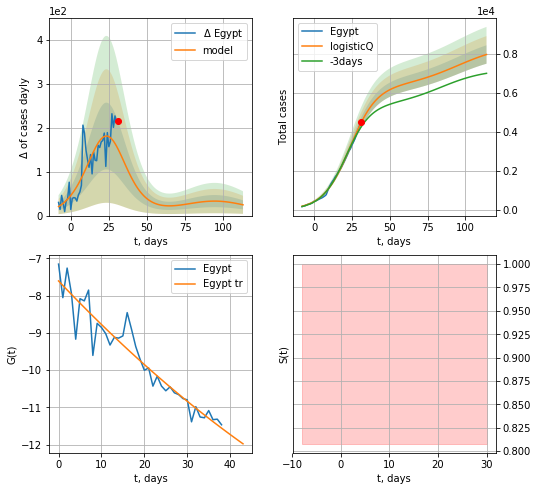

Egypt data at: 2020-04-26
+3 day model MAPE: 0.05720794220791437
model: logisticQ
coeffs:  [ 6.29786871e+03  7.43807160e-05  2.36015593e+01 -1.50701795e+03]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.05921727516615358
forecast at the end of period: +83 days
	 deltaDaycases:  24
	 total cases:  7984 ± 472
	 total death:  558 ± 99
trend coefficient of determination: 0.906341
 intercept_: -7.606758278862999
 coeffs_: [ 0.         -0.12142535  0.00045944]


In [360]:
x = forecastRRR("Egypt",dfEG[12:],d1,16*7-dT,addpred=True,xcoef=[0.35,.5,4.,1])

IQ
          date  cases  active  death
50 2020-04-22   1631   402.0   83.0
51 2020-04-23   1677   423.0   83.0
52 2020-04-24   1708   418.0   86.0
53 2020-04-25   1763   453.0   86.0
54 2020-04-26   1820   470.0   87.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


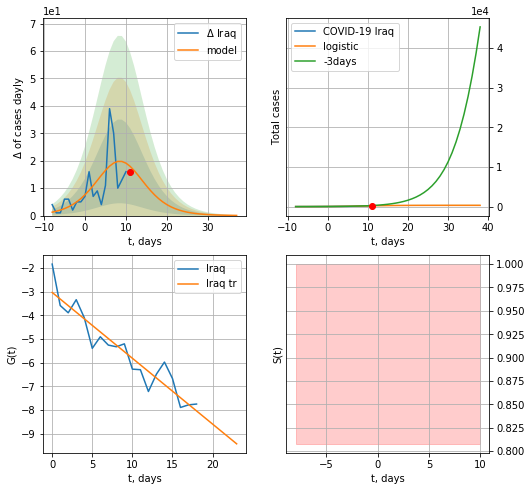

Iraq data at: 2020-04-26
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  316 ± 65
	 total death:  15 ± 9
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


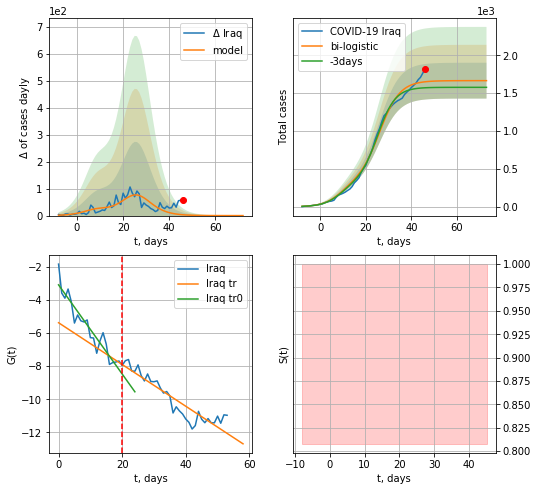

Iraq data at: 2020-04-26
+3 day model MAPE: 0.05139170451719528
model: bi-logistic
coeffs:  [1.34777325e+03 2.24681257e-01 2.60781046e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.1421271051305356
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1664 ± 236
	 total death:  79 ± 33
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.852146
 intercept: -5.375544
 slope: -0.126199


In [374]:
vL=20
vL1=32
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Iraq",dfAG[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

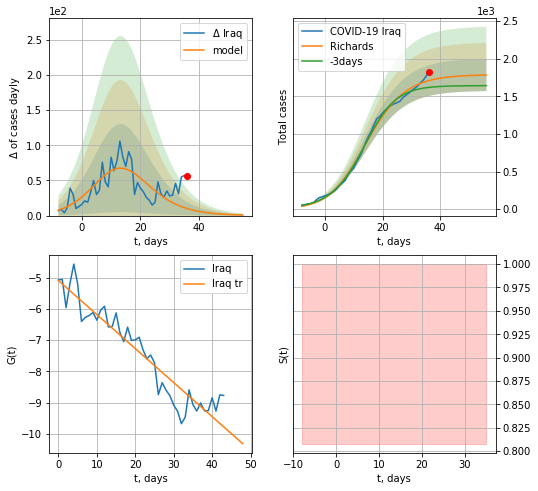

Iraq data at: 2020-04-26
+3 day model MAPE: 0.05887150193708118
model: Richards
coeffs:  [1.78789041e+03 1.94406501e-01 1.11753412e+01 7.07198344e-01]
rational stdev:  0.11958798955718092
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  1782 ± 213
	 total death:  85 ± 30
trend coefficient of determination: 0.890594
 intercept: -5.093212
 slope: -0.108929


In [375]:
x = forecastRR("Iraq",dfIQ[10:],d1,7*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


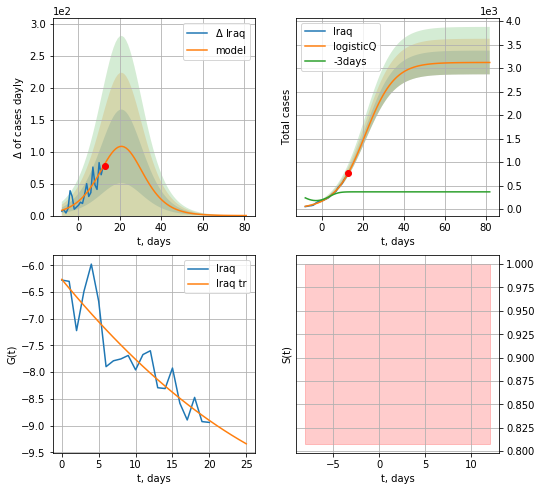

Iraq data at: 2020-04-26
+3 day model MAPE: 1.325309756792028
model: logisticQ
coeffs:  [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev:  0.08084977262432641
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  3119 ± 252
	 total death:  149 ± 36
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


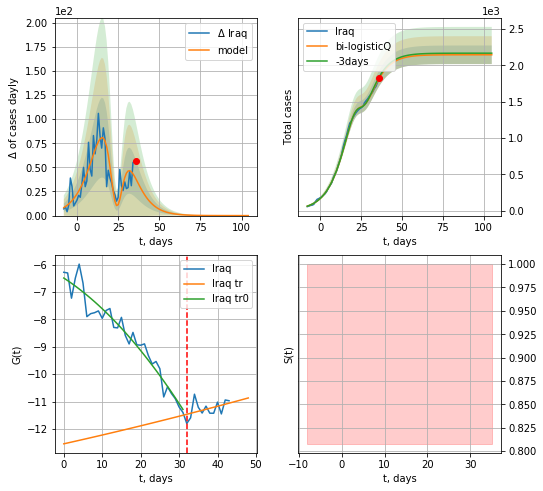

Iraq data at: 2020-04-26
+3 day model MAPE: 0.010779705486978182
model: bi-logisticQ
coeffs:  [-9.74822027e+02  8.21901939e-06  2.43132948e+01 -4.64587268e+04] [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev:  0.059635963481481875
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  2145 ± 127
	 total death:  102 ± 18
bi-logistic approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.186454
 intercept_: -12.54418436442331
 coeffs_: [0.00000000e+00 3.13787015e-02 7.34735340e-05]


In [376]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,14*7-dT,x,addpred=False,xcoef=[0.35,.5,4.,1],vL=32)

In [377]:
#len(dfAR)

AR
          date   cases  active  death
49 2020-04-22  2910.0  1304.0  402.0
50 2020-04-23  3007.0  1245.0  407.0
51 2020-04-24  3127.0  1304.0  415.0
52 2020-04-25  3256.0  1358.0  419.0
53 2020-04-26  3382.0  1449.0  425.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


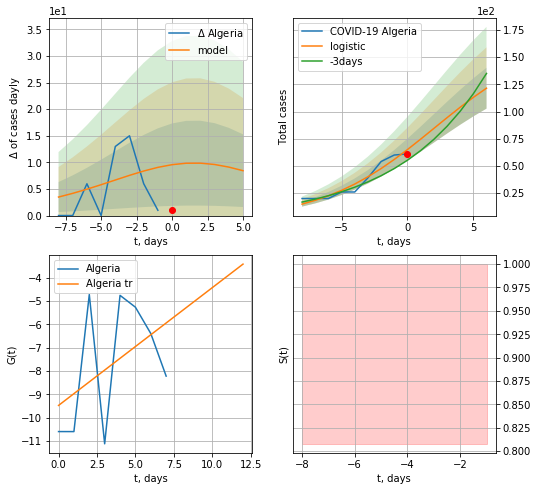

Algeria data at: 2020-04-26
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  121 ± 18
	 total death:  15 ± 6
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


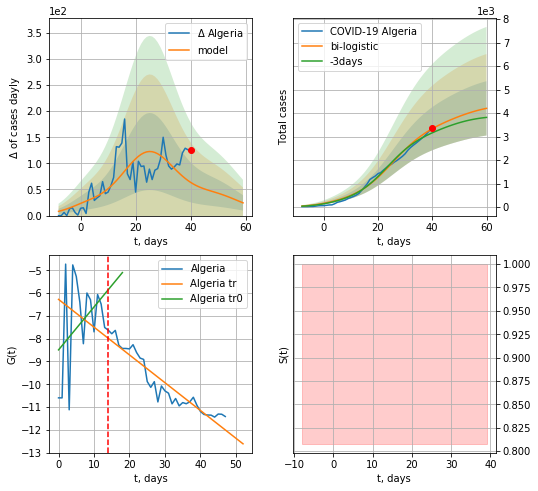

Algeria data at: 2020-04-26
+3 day model MAPE: 0.05800629500754154
model: bi-logistic
coeffs:  [3.38623018e+03 1.41008671e-01 2.53055635e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.27502469040269745
forecast at the end of period: +20 days
	 deltaDaycases:  24
	 total cases:  4199 ± 1154
	 total death:  527 ± 434
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.895360
 intercept: -6.275991
 slope: -0.121901


In [378]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,5*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


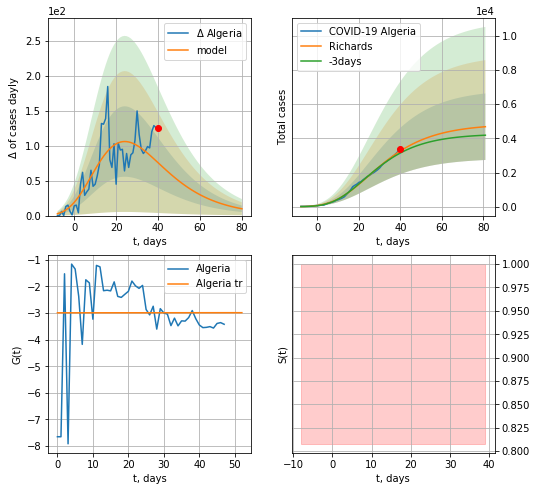

Algeria data at: 2020-04-26
+3 day model MAPE: 0.04059116042279643
model: Richards
coeffs:  [ 4.84291628e+03  3.73114828e+00 -4.41174293e+01  1.61024761e-02]
rational stdev:  0.41615176360199213
forecast at the end of period: +41 days
	 deltaDaycases:  9
	 total cases:  4682 ± 1948
	 total death:  588 ± 734
trend coefficient of determination: 0.000001
 intercept: -2.989316
 slope: 0.000091


In [379]:
x = forecastRR("Algeria",dfAR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


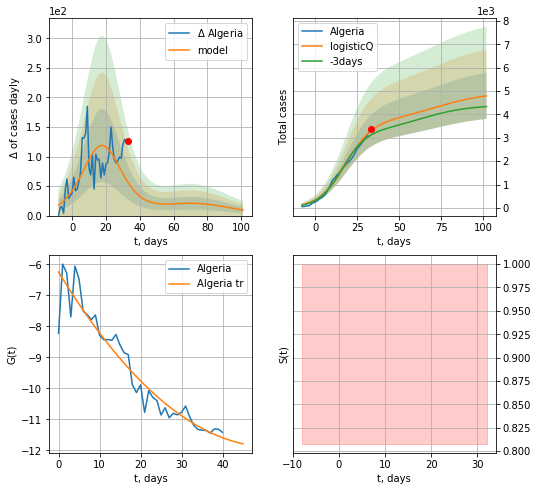

Algeria data at: 2020-04-26
+3 day model MAPE: 0.0619324267562669
model: logisticQ
coeffs:  [ 3.67445725e+03  2.74784195e-06  1.80462051e+01 -4.60467034e+04]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2051611779019011
forecast at the end of period: +69 days
	 deltaDaycases:  9
	 total cases:  4791 ± 983
	 total death:  602 ± 370
trend coefficient of determination: 0.915196
 intercept_: -6.25170755787686
 coeffs_: [ 0.         -0.21709233  0.00209037]


In [380]:
x = forecastRRR("Algeria",dfAR[12:],d1,14*7-dT,addpred=True,xcoef=[0.35,.5,4,1])

CP
          date  cases  active  death
41 2020-04-22  790.0   679.0   13.0
42 2020-04-23  795.0   684.0   13.0
43 2020-04-24  804.0   692.0   14.0
44 2020-04-25  810.0   648.0   14.0
45 2020-04-26  817.0   655.0   14.0


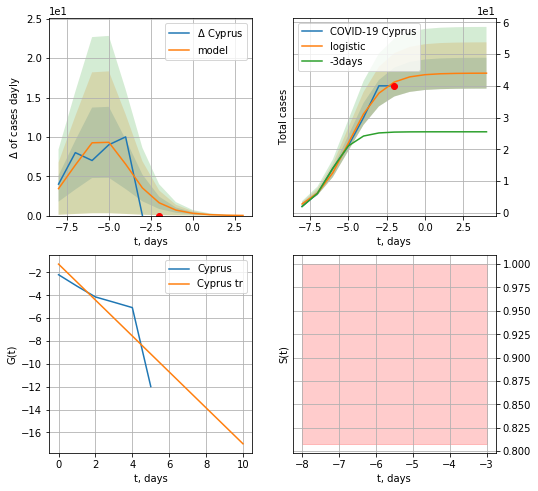

Cyprus data at: 2020-04-26
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


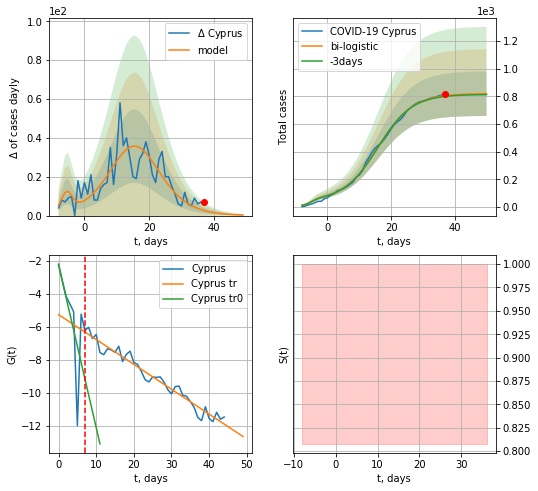

Cyprus data at: 2020-04-26
+3 day model MAPE: 0.007311953455878571
model: bi-logistic
coeffs:  [7.76979480e+02 1.84255310e-01 1.59351539e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19662172552759766
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  819 ± 161
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.957422
 intercept: -5.257132
 slope: -0.150852


In [381]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,5*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

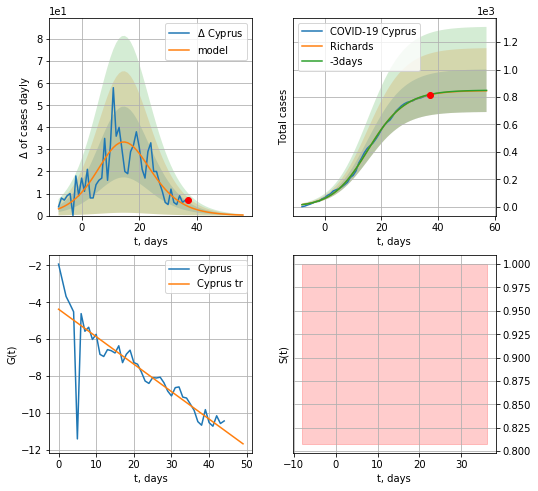

Cyprus data at: 2020-04-26
+3 day model MAPE: 0.0020624922828772693
model: Richards
coeffs:  [8.47158743e+02 1.77286158e-01 1.40074966e+01 8.48066991e-01]
rational stdev:  0.18326059913504517
forecast at the end of period: +20 days
	 deltaDaycases:  0
	 total cases:  845 ± 154
	 total death:  14 ± 7
trend coefficient of determination: 0.751662
 intercept: -4.374667
 slope: -0.149266


In [382]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


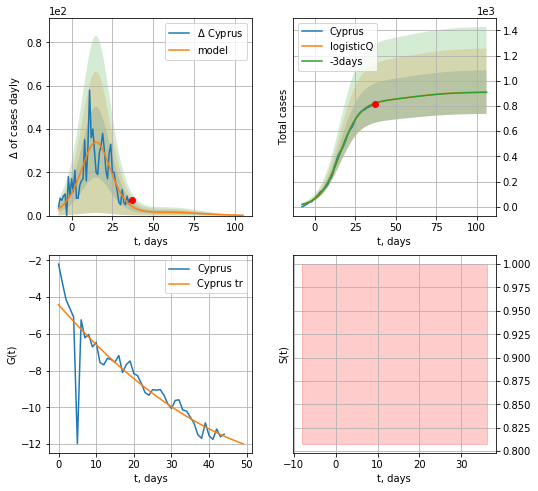

Cyprus data at: 2020-04-26
+3 day model MAPE: 0.001230183611090835
model: logisticQ
coeffs:  [ 8.38208468e+02  9.43940140e-06  1.54120405e+01 -1.70949837e+04]
scenario coeffs:  [0.0875, 0.5, 4, 1]
rational stdev:  0.18952005405165634
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  909 ± 172
	 total death:  15 ± 8
trend coefficient of determination: 0.786872
 intercept_: -4.409068027196839
 coeffs_: [ 0.         -0.23360634  0.00161043]


In [417]:
x = forecastRRR("Cyprus",dfCP[:],d1,14*7-dT,addpred=True,xcoef=[0.35/4,.5,4,1])

PU
          date  cases   active  death
46 2020-04-22  19250  11693.0  530.0
47 2020-04-23  20914  12920.0  572.0
48 2020-04-24  21648  13518.0  634.0
49 2020-04-25  25331  16834.0  700.0
50 2020-04-26  27517  18701.0  728.0


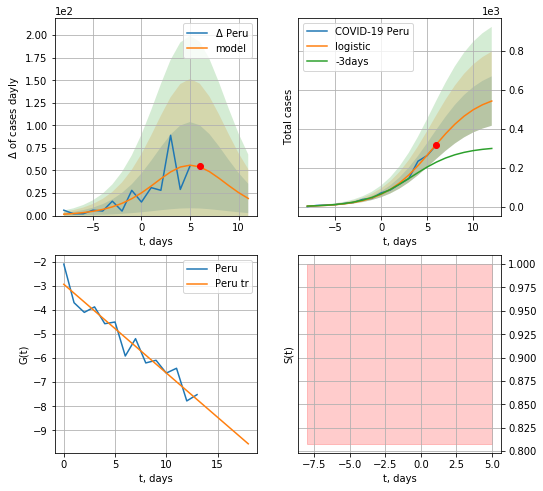

Peru data at: 2020-04-26
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  542 ± 126
	 total death:  14 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


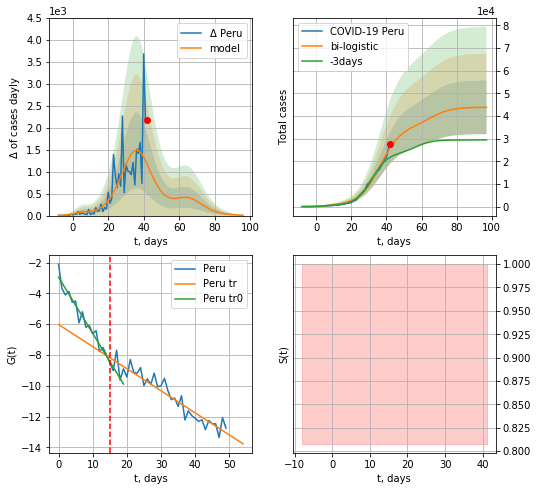

Peru data at: 2020-04-26
+3 day model MAPE: 0.21745949624889793
model: bi-logistic
coeffs:  [3.46078359e+04 1.70871390e-01 3.63727044e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.26987914538302193
forecast at the end of period: +55 days
	 deltaDaycases:  7
	 total cases:  43808 ± 11822
	 total death:  1159 ± 938
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.892474
 intercept: -6.023291
 slope: -0.143527


In [384]:
dfPU = read_df(pd.DataFrame(),"PU")
x = forecast("Peru",dfPU[:15],d1,5*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


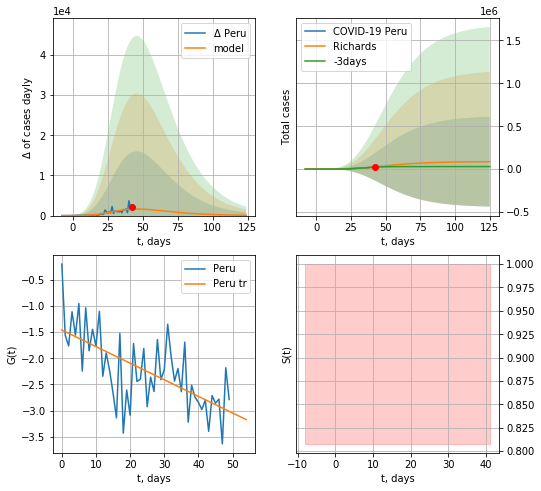

Peru data at: 2020-04-26
+3 day model MAPE: 0.17777279544698588
model: Richards
coeffs:  [ 8.82713825e+04  2.04331871e+00 -2.58700653e+01  2.50650372e-02]
rational stdev:  6.038019120937542
forecast at the end of period: +83 days
	 deltaDaycases:  80
	 total cases:  86732 ± 523695
	 total death:  2294 ± 41553
trend coefficient of determination: 0.406068
 intercept: -1.460596
 slope: -0.031699


In [385]:
x = forecastRR("Peru",dfPU[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


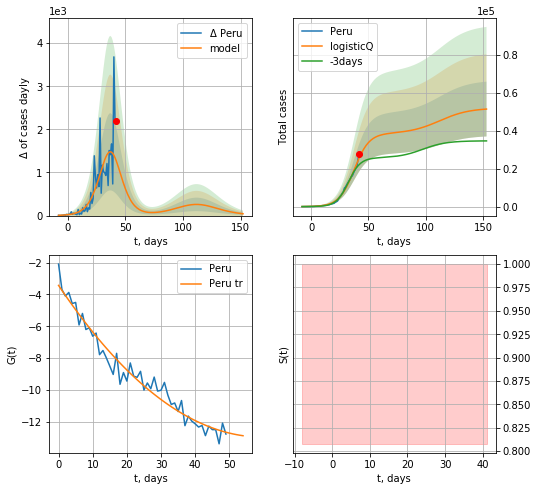

Peru data at: 2020-04-26
+3 day model MAPE: 0.19249890000783434
model: logisticQ
coeffs:  [ 3.84839472e+04  5.50611484e-06  3.73621943e+01 -2.78721001e+04]
scenario coeffs:  [0.35, 0.5, 3.0, 1]
rational stdev:  0.2807833878178011
forecast at the end of period: +111 days
	 deltaDaycases:  42
	 total cases:  51403 ± 14433
	 total death:  1359 ± 1144
trend coefficient of determination: 0.958093
 intercept_: -3.4349691254950088
 coeffs_: [ 0.         -0.31851059  0.00266638]


In [387]:
x = forecastRRR("Peru",dfPU[:],d1,20*7-dT,addpred=True,xcoef=[0.35,.5,3.,1])

ID
          date  cases   active  death
53 2020-04-22  21797  16740.0  681.0
54 2020-04-23  23502  17768.0  722.0
55 2020-04-24  24530  18252.0  780.0
56 2020-04-25  26496  19732.0  825.0
57 2020-04-26  27977  20570.0  884.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


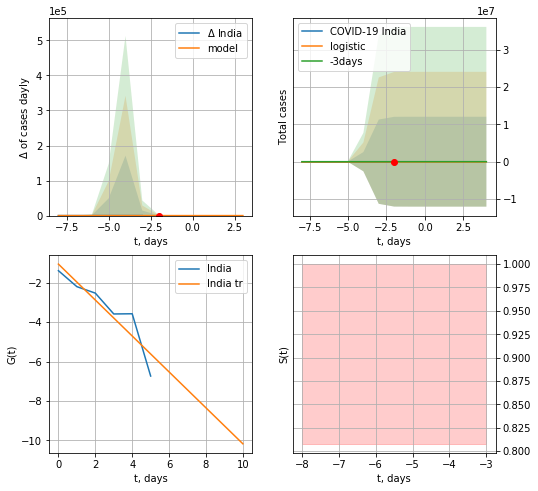

India data at: 2020-04-26
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


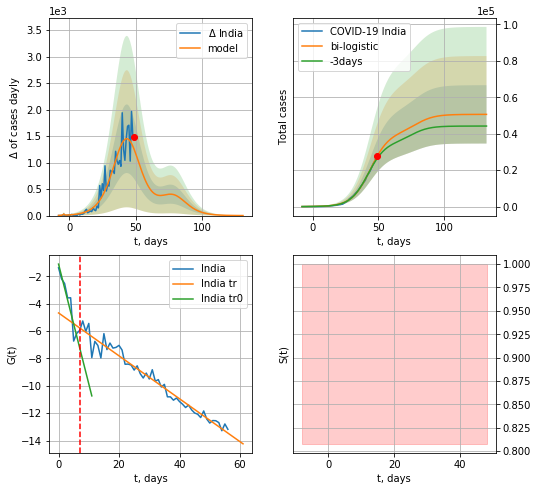

India data at: 2020-04-26
+3 day model MAPE: 0.05186638205915029
model: bi-logistic
coeffs:  [4.04561305e+04 1.42599407e-01 4.37740245e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.31611308459184745
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  50594 ± 15993
	 total death:  1598 ± 1515
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.963231
 intercept: -4.680762
 slope: -0.156636


In [388]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,5*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


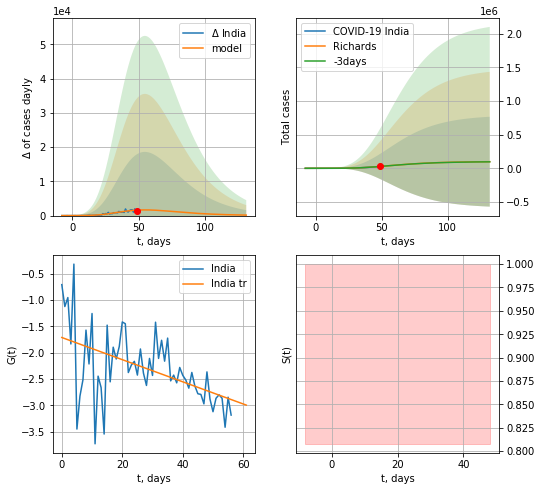

India data at: 2020-04-26
+3 day model MAPE: 0.0013103982967432985
model: Richards
coeffs:  [ 1.01711308e+05  1.88456848e+00 -2.81075939e+01  2.38399841e-02]
rational stdev:  6.776159722402317
forecast at the end of period: +83 days
	 deltaDaycases:  142
	 total cases:  98555 ± 667830
	 total death:  3114 ± 63302
trend coefficient of determination: 0.253655
 intercept: -1.711717
 slope: -0.021005


In [389]:
x = forecastRR("India",dfID[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


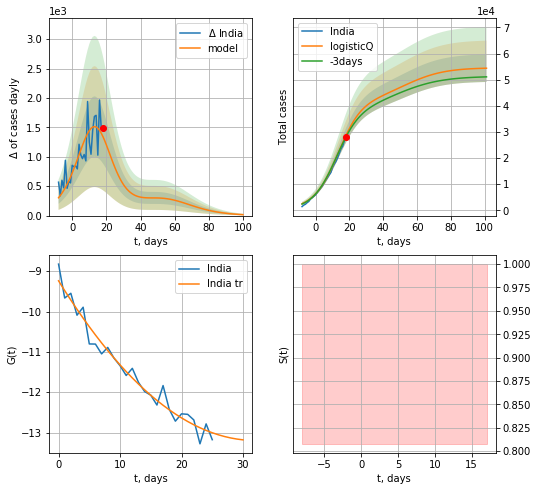

India data at: 2020-04-26
+3 day model MAPE: 0.024485093509818232
model: logisticQ
coeffs:  [ 4.04078303e+04  4.23235522e-04  1.27899879e+01 -3.28547805e+02]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.09692639663540842
forecast at the end of period: +83 days
	 deltaDaycases:  15
	 total cases:  54399 ± 5272
	 total death:  1718 ± 499
trend coefficient of determination: 0.964422
 intercept_: -9.238279804995502
 coeffs_: [ 0.         -0.24697012  0.00385069]


In [392]:
x = forecastRRR("India",dfID[31:],d1,16*7-dT,addpred=True,xcoef=[.35,.5,4.0,1])

AG
          date   cases  active  death
49 2020-04-22  3288.0  2257.0  159.0
50 2020-04-23  3435.0  2351.0  165.0
51 2020-04-24  3607.0  2455.0  176.0
52 2020-04-25  3780.0  2565.0  185.0
53 2020-04-26  3892.0  2593.0  192.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


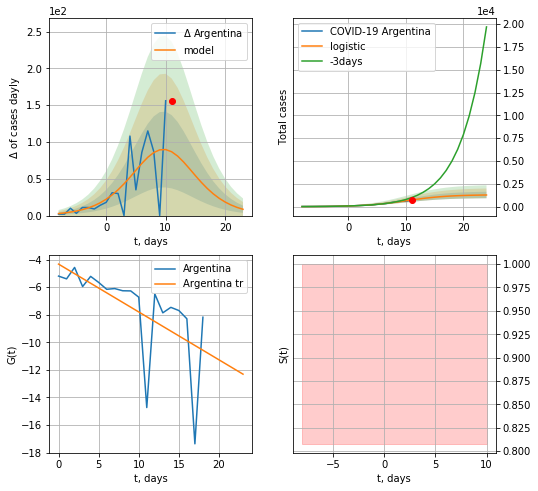

Argentina data at: 2020-04-26
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +13 days
	 deltaDaycases:  8
	 total cases:  1278 ± 355
	 total death:  63 ± 52
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


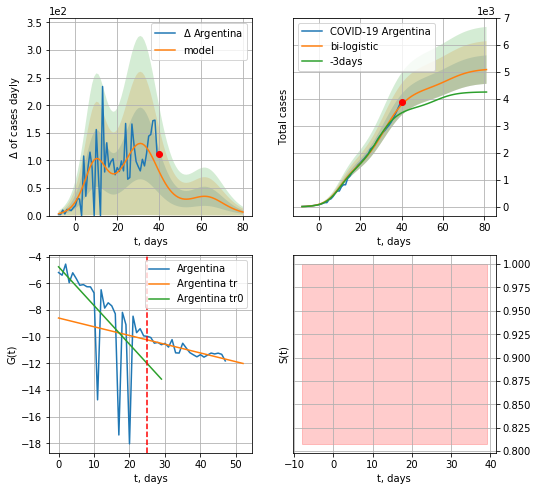

Argentina data at: 2020-04-26
+3 day model MAPE: 0.09644496933648608
model: bi-logistic
coeffs:  [3.05919601e+03 1.69097953e-01 3.15977286e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.10363391362117767
forecast at the end of period: +41 days
	 deltaDaycases:  6
	 total cases:  5093 ± 527
	 total death:  251 ± 78
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.740852
 intercept: -8.601942
 slope: -0.065458


In [393]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


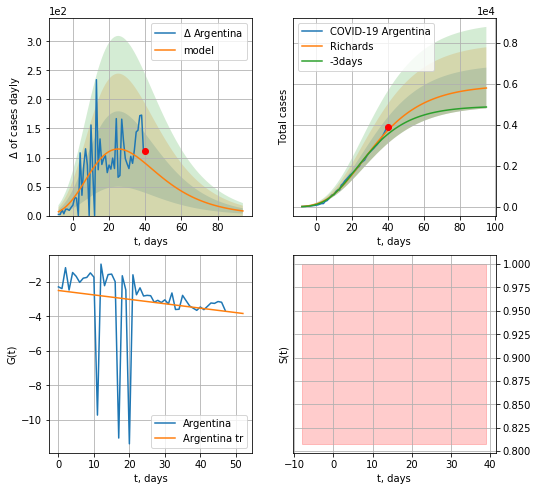

Argentina data at: 2020-04-26
+3 day model MAPE: 0.057435614199048385
model: Richards
coeffs:  [ 5.93446630e+03  4.68577946e+00 -5.93692489e+01  1.12715019e-02]
rational stdev:  0.1714389711559779
forecast at the end of period: +55 days
	 deltaDaycases:  8
	 total cases:  5784 ± 991
	 total death:  285 ± 146
trend coefficient of determination: 0.028170
 intercept: -2.495039
 slope: -0.025621


In [394]:
x = forecastRR('Argentina',dfAG[5:],d1,12*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


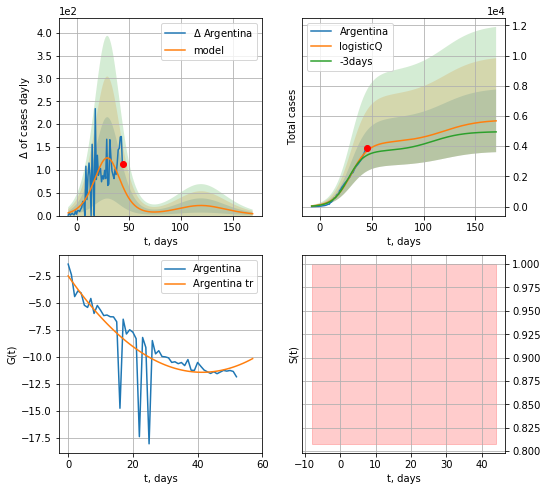

Argentina data at: 2020-04-26
+3 day model MAPE: 0.08750595202862554
model: logisticQ
coeffs:  [ 4.25789960e+03  3.58823294e-06  2.99660591e+01 -3.29448571e+04]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.36510322365612186
forecast at the end of period: +125 days
	 deltaDaycases:  4
	 total cases:  5676 ± 2072
	 total death:  280 ± 306
trend coefficient of determination: 0.652978
 intercept_: -2.4777899671708994
 coeffs_: [ 0.         -0.43113601  0.005207  ]


In [396]:
x = forecastRRR('Argentina',dfAG[:],d1,22*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:127: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


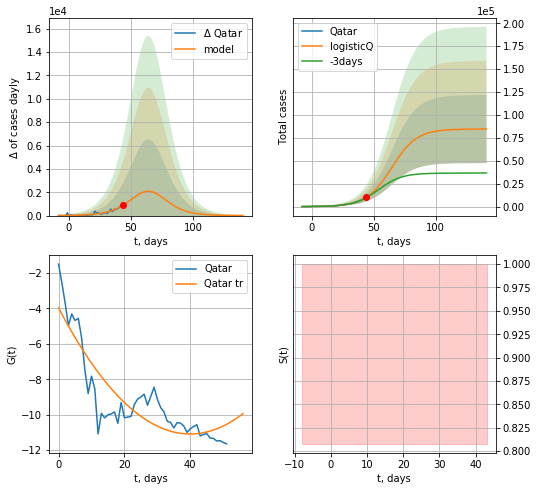

Qatar data at: 2020-04-26
+3 day model MAPE: 0.04953279033471465
model: logisticQ
coeffs:  [ 8.45576592e+04  3.15679315e-05  6.43325030e+01 -3.05346614e+03]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.4388210944970246
forecast at the end of period: +97 days
	 deltaDaycases:  7
	 total cases:  84604 ± 37126
	 total death:  82 ± 107
trend coefficient of determination: 0.764294
 intercept_: -3.9688259385672797
 coeffs_: [ 0.         -0.35647339  0.00446147]


In [397]:
x = forecastRRR('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

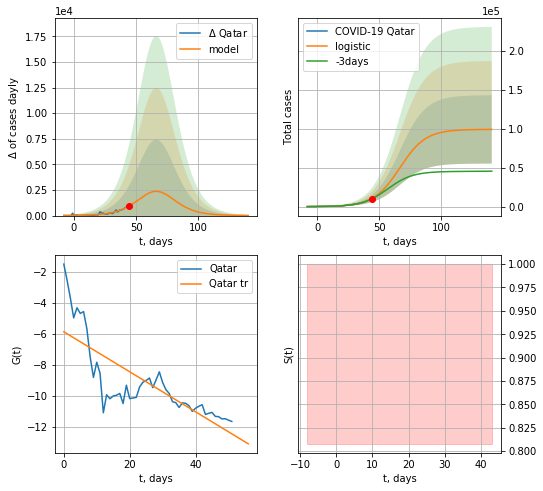

Qatar data at: 2020-04-26
+3 day model MAPE: 0.04301853569235126
model: logistic
coeffs:  [9.92046553e+04 9.56291518e-02 6.66659496e+01]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  0.44241088424515884
forecast at the end of period: +97 days
	 deltaDaycases:  12
	 total cases:  99208 ± 43891
	 total death:  96 ± 127
trend coefficient of determination: 0.628408
 intercept: -5.864175
 slope: -0.128969


In [398]:
x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

In [399]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457, 457]


In [5]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"858,630",North America,\nNorth America\n,,"+1,345",59,"16,405",,"1,065,948","60,014","147,304",,
1,"716,343",Europe,\nEurope\n,,142,8,"25,260",,"1,276,950","121,893","438,714",,
2,"226,794",Asia,\nAsia\n,,122,6,"6,051",,"472,389","17,249","228,346",,
3,"82,282",South America,\nSouth America\n,,335,20,"9,700",,"138,255","6,309","49,664",,
4,"1,353",Australia/Oceania,\nOceania\n,,3,1,46,,"8,289",102,"6,834",,
5,"21,212",Africa,\nAfrica\n,,,,140,,"32,657","1,427","10,018",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"1,906,675",All,World,26.6,"+1,947",94,"57,606",,"2,995,209","207,009","881,525",,384
8,"813,126",North America,USA,167,162,2,"15,143","16,527","987,322","55,415","118,781","5,470,555","2,983"
9,"85,712",Europe,Spain,496,,,"7,764","25,656","226,629","23,190","117,727","1,199,548","4,847"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"858,630",North America,\nNorth America\n,,"+1,345",59,"16,405",,"1,065,948","60,014","147,304",,
1,"716,343",Europe,\nEurope\n,,142,8,"25,260",,"1,276,950","121,893","438,714",,
2,"226,794",Asia,\nAsia\n,,122,6,"6,051",,"472,389","17,249","228,346",,
3,"82,282",South America,\nSouth America\n,,335,20,"9,700",,"138,255","6,309","49,664",,
4,"1,353",Australia/Oceania,\nOceania\n,,3,1,46,,"8,289",102,"6,834",,


In [7]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
82,934,Europe,Lithuania,15,11,,17,"39,223","1,449",41,474,"106,775",532
312,930,Europe,Lithuania,15,12,,17,"38,382","1,438",41,467,"104,488",528


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

228


In [9]:
#df

In [10]:
df.at[13, 'TotalRecovered'] = 0
df.at[20, 'TotalRecovered'] = 0

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,\nNorth America\n,NaN,1345.0,59.0,16405.0,NaN,1065948,60014.0,147304.0,NaN,NaN
1,716343,Europe,\nEurope\n,NaN,142.0,8.0,25260.0,NaN,1276950,121893.0,438714.0,NaN,NaN
2,226794,Asia,\nAsia\n,NaN,122.0,6.0,6051.0,NaN,472389,17249.0,228346.0,NaN,NaN
3,82282,South America,\nSouth America\n,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
4,1353,Australia/Oceania,\nOceania\n,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN
5,21212,Africa,\nAfrica\n,NaN,NaN,NaN,140.0,NaN,32657,1427.0,10018.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,1906675,All,World,26.6,1947.0,94.0,57606.0,NaN,2995209,207009.0,881525.0,NaN,384.0
8,813126,North America,USA,167.0,162.0,2.0,15143.0,16527.0,987322,55415.0,118781.0,5470555.0,2983.0
9,85712,Europe,Spain,496.0,NaN,NaN,7764.0,25656.0,226629,23190.0,117727.0,1199548.0,4847.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
223,82282,South America,Total:,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
224,1353,Australia/Oceania,Total:,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN
225,21212,Africa,Total:,NaN,NaN,NaN,140.0,NaN,32657,1427.0,10018.0,NaN,NaN
226,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
227,470100,Europe,European Union,219.606709,142.0,8.0,20592.0,18299.046815,968497,97780.0,400367.0,8147660.0,2175.173233


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,North America,NaN,1345.0,59.0,16405.0,NaN,1065948,60014.0,147304.0,NaN,NaN
1,716343,Europe,Europe,NaN,142.0,8.0,25260.0,NaN,1276950,121893.0,438714.0,NaN,NaN
2,226794,Asia,Asia,NaN,122.0,6.0,6051.0,NaN,472389,17249.0,228346.0,NaN,NaN
3,82282,South America,South America,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
4,1353,Australia/Oceania,Oceania,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,858630,North America,North America,NaN,1345.0,59.0,16405.0,NaN,1065948,60014.0,147304.0,NaN,NaN
1,716343,Europe,Europe,NaN,142.0,8.0,25260.0,NaN,1276950,121893.0,438714.0,NaN,NaN
2,226794,Asia,Asia,NaN,122.0,6.0,6051.0,NaN,472389,17249.0,228346.0,NaN,NaN
3,82282,South America,South America,NaN,335.0,20.0,9700.0,NaN,138255,6309.0,49664.0,NaN,NaN
4,1353,Australia/Oceania,Oceania,NaN,3.0,1.0,46.0,NaN,8289,102.0,6834.0,NaN,NaN
5,21212,Africa,Africa,NaN,NaN,NaN,140.0,NaN,32657,1427.0,10018.0,NaN,NaN
7,1906675,All,World,26.6,1947.0,94.0,57606.0,NaN,2995209,207009.0,881525.0,NaN,384.0
8,813126,North America,USA,167.0,162.0,2.0,15143.0,16527.0,987322,55415.0,118781.0,5470555.0,2983.0
9,85712,Europe,Spain,496.0,NaN,NaN,7764.0,25656.0,226629,23190.0,117727.0,1199548.0,4847.0
10,106103,Europe,Italy,441.0,NaN,NaN,2009.0,29071.0,197675,26644.0,64928.0,1757659.0,3269.0


In [17]:
df.to_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Slovenia SV
Belarus BR
Philippines PH
Netherlands NL
Argentina AG
Portugal PT
Spain SP
UK GB
Israel IS
Turkey TR
Slovakia SL
Romania RM
Indonesia IE
Panama PM
Latvia LV
Sweden SW
Singapore SG
Qatar QR
Switzerland SZ
Peru PU
Serbia SB
S. Korea KR
Belgium BG
Iran IN
Croatia CT
Greece GC
World World
New Zealand ZL
Czechia CH
Norway NG
Cyprus CP
Lithuania LT
Mexico MX
Russia RS
European Union EU
China CN
Morocco MR
Malaysia ML
Australia AS
Ireland IR
Luxembourg LX
Colombia CB
Italy IT
Pakistan PK
Iraq IQ
Denmark DK
Germany GR
Iceland IC
Estonia ES
Malta MT
Algeria AR
Ukraine Ukr
Bulgaria BL
Thailand TH
Egypt EG
Japan JP
Finland FI
France FR
Ecuador ED
Canada CA
Hungary HG
Austria AT
Brazil BZ
Chile CL
USA US
India ID
Poland PL


In [19]:
df = pd.read_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-04-26,1065948,858630,60014.0
Europe
Europe 2020-04-26,1276950,716343,121893.0
Asia
Asia 2020-04-26,472389,226794,17249.0
South America
South America 2020-04-26,138255,82282,6309.0
Oceania
Oceania 2020-04-26,8289,1353,102.0
Africa
Africa 2020-04-26,32657,21212,1427.0
World
World 2020-04-26,2995209,1906675,207009.0
USA
USA 2020-04-26,987322,813126,55415.0
Spain
Spain 2020-04-26,226629,85712,23190.0
Italy
Italy 2020-04-26,197675,106103,26644.0
France
France 2020-04-26,162100,94341,22856.0
Germany
Germany 2020-04-26,157770,37294,5976.0
UK
UK 2020-04-26,152840,131764,20732.0
Turkey
Turkey 2020-04-26,110130,78185,2805.0
Iran
Iran 2020-04-26,90481,15114,5710.0
Russia
Russia 2020-04-26,80949,73435,747.0
Brazil
Brazil 2020-04-26,63100,28662,4286.0
Canada
Canada 2020-04-26,46895,27014,2560.0
Belgium
Belgium 2020-04-26,46134,28255,7094.0
Netherlands
Netherlands 2020-04-26,37845,33120,4475.0
Switzerland
Switzerland 2020-04-26,29061,5651,1610.0
India
India 2020-04-2

Papua New Guinea
Papua New Guinea 2020-04-26,8,8,nan
Mauritania
Mauritania 2020-04-26,7,0,1.0
Bhutan
Bhutan 2020-04-26,7,3,nan
British Virgin Islands
British Virgin Islands 2020-04-26,6,2,1.0
St. Barth
St. Barth 2020-04-26,6,0,nan
South Sudan
South Sudan 2020-04-26,6,6,nan
Western Sahara
Western Sahara 2020-04-26,6,1,nan
Caribbean Netherlands
Caribbean Netherlands 2020-04-26,5,5,nan
Sao Tome and Principe
Sao Tome and Principe 2020-04-26,4,4,nan
Anguilla
Anguilla 2020-04-26,3,2,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-04-26,1,1,nan
Yemen
Yemen 2020-04-26,1,0,nan
China
China 2020-04-26,82830,723,4633.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
Total:
Total: 2020-04-26,1065948,858630,60014.0
European Union
European Union 2020-04-26,968

In [20]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [21]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("corona%sOneRaw.csv"%(c),'r')
    fff = open("/home/algiz/Desktop/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append /home/algiz/Desktop/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append /home/algiz/Desktop/coronaSV.csv 2020-04-26,1396,1093,82.0

append /home/algiz/Desktop/coronaBR.csv 2020-04-26,10463,8696,72.0

append /home/algiz/Desktop/coronaPH.csv 2020-04-26,7579,6216,501.0

append /home/algiz/Desktop/coronaNL.csv 2020-04-26,37845,33120,4475.0

append /home/algiz/Desktop/coronaAG.csv 2020-04-26,3892,2593,192.0

append /home/algiz/Desktop/coronaPT.csv 2020-04-26,23864,21632,903.0

append /home/algiz/Desktop/coronaSP.csv 2020-04-26,226629,85712,23190.0

append /home/algiz/Desktop/coronaGB.csv 2020-04-26,152840,131764,20732.0

append /home/algiz/Desktop/coronaIS.csv 2020-04-26,15443,8511,201.0

append /home/algiz/Desktop/coronaTR.csv 2020-04-26,110130,78185,2805.0

append /home/algiz/Desktop/coronaSL.csv 2020-04-26,1379,967,18.0

append /home/algiz/Desktop/coronaRM.csv 2020-04-26,11036,7363,619.0

append /home/algiz/Desktop/coronaIE.csv 2020-04-26,8882,7032,743.0

append /home/algiz/Desktop/coronaPM.csv 2020-04-26,5779,5245,165.0

append /home/algiz/Desktop/co

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [323]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

13905339.0 1787.8701656037852


In [309]:
TT/7.7776e3

2344.341827813207

In [335]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [400]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445

18309.34831460674

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [469]:
#dfAll

In [401]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/7.777e3

3608.909476661952